# Regression , Classification Problems 

## Orderwise 
- to predict : sales(TotPrice of order)[reg]


## Productwise 
- to predict : prodName[reg] , clientName[reg] , prodPrice[classif]


## Clientwise
- to predict : sales()[reg] 


## To do 
### 1. Vid 19 - EDA : Understanding your data 
### 2. Vid 20 - EDA : Univariate
### 3. Vid 21 - EDA : Multivariate 
### 4. Vid 22 - EDA : Pandas Profiler 
### 5. Vid 50- Vid : Simple Linear Regression
### 6. Vid 53- Vid : Multiple Linear Regression 
### 7. Vid 56- Vid : Gradient Descent 
### 8. Vid 60- Vid : Polynomial Regression 
### 9. Vid 62- Vid : Ridge Regression
### 10. Vid 66- Vid : Lasso Regression
### 11. Vid 68- Vid : ElasticNet Regression
### 12. Vid 69- Vid : Logistic Regression
### 13. Vid 77- Vid : Softmax Regression
### 14. Vid 80- Vid : Decision Tree
### 15. Vid 82- Vid : Regression Tree
### 16. Vid 85- Vid : Voting
### 17. Vid 88- Vid : Bagging
### 18. Vid 91- Vid : Random Forest
### 19. Vid 98- Vid : ADA Boosting
### 20. Vid 106- Vid : Gradient Boosting
### 21. Vid 108- Vid : Stacking, Blending Ensembles

In [1]:
import pandas as pd
import numpy as np

In [2]:
df_orderwise = pd.read_csv("../1_mockData/try1/orderwise.csv")
print(df_orderwise.shape)
df_productwise = pd.read_csv("../1_mockData/try1/productwise.csv")
print(df_productwise.shape)
df_clientwise = pd.read_csv("../1_mockData/try1/clientwise.csv")
print(df_clientwise.shape)

(18622, 21)
(59094, 19)
(18284, 7)


In [3]:
print(df_orderwise.columns)
df_orderwise.head(3)

Index(['Unnamed: 0.1', 'Unnamed: 0', 'OrderID', 'ClientName', 'MonthNum',
       'Hour', 'Minute', 'Day', 'Prods', 'QtyOrdered', 'Sales', 'CliAvgSenti',
       'SpAvgSenti', 'CliChats', 'SpChats', 'ann_cli_senti', 'ann_sp_senti',
       'gru_cli_senti', 'gru_sp_senti', 'CliSenti', 'SpSenti'],
      dtype='object')


,Unnamed: 0.1,Unnamed: 0,OrderID,ClientName,MonthNum,Hour,Minute,Day,Prods,QtyOrdered,...,CliAvgSenti,SpAvgSenti,CliChats,SpChats,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
0,0,0,1001,Client1,1,20,51,4,"prod14,prod6,prod2",5,...,0.8,0.6,"It's awesome! In Story Mode, your going from p...","OK, so in any Wile E. Coyote-Road Runner carto...",0.998079,0.996931,0.902179,0.942251,0,0
1,1,1,1002,Client8,1,21,3,0,"prod2,prod15,prod15",10,...,0.4,0.4,This tender beautifully crafted production del...,"Man were do I start,everything about this Cart...",0.972840,0.998424,0.943390,0.383383,1,0
2,2,2,1003,Client0,1,18,22,4,"prod2,prod9,prod1",10,...,0.2,0.6,God this film was just so boring apart from th...,I saw this film when it first came out and hat...,0.000107,0.003524,0.069862,0.199325,0,0


In [4]:
df_productwise.sample(5)

,Unnamed: 0,ProdName,ClientName,MonthNum,OrderID,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
43665,43665,prod3,Client4,2,4191,15,6700,0.4,0.4,2100,21,33,3,0,0,0.473894,0.998727,0.183884,0.738530
43327,43327,prod13,Client0,2,4086,13,11000,0.0,0.6,200,22,53,6,0,0,0.000126,0.697719,0.406582,0.905176
17577,17577,prod6,Client5,9,12580,11,5700,0.4,0.4,1200,18,54,0,0,0,0.003496,0.873117,0.826856,0.927612
18677,18677,prod1,Client0,9,12933,27,22500,0.6,0.4,4900,22,16,1,0,0,0.433903,0.347175,0.677025,0.616245
57980,57980,prod2,Client5,8,12208,12,8500,0.8,0.4,3000,19,27,0,0,0,0.932095,0.999887,0.955717,0.919963


In [5]:
df_clientwise.sample(5)

,Unnamed: 0,ClientName,MonthNum,Day,Prods,QtyOrdered,Sales
1229,1229,Client0,4,2,"prod3,prod13,prod1",9,4900
8200,8200,Client2,10,5,"prod15,prod15",9,9000
7377,7377,Client2,6,4,"prod1,prod4",2,1500
7477,7477,Client2,7,1,"prod1,prod15",4,3700
1096,1096,Client0,4,0,"prod10,prod1,prod10,prod1",21,16800


# Orderwise csv analysis

In [6]:
import pandas as pd

In [7]:
df_orderwise.head(2)

,Unnamed: 0.1,Unnamed: 0,OrderID,ClientName,MonthNum,Hour,Minute,Day,Prods,QtyOrdered,...,CliAvgSenti,SpAvgSenti,CliChats,SpChats,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
0,0,0,1001,Client1,1,20,51,4,"prod14,prod6,prod2",5,...,0.8,0.6,"It's awesome! In Story Mode, your going from p...","OK, so in any Wile E. Coyote-Road Runner carto...",0.998079,0.996931,0.902179,0.942251,0,0
1,1,1,1002,Client8,1,21,3,0,"prod2,prod15,prod15",10,...,0.4,0.4,This tender beautifully crafted production del...,"Man were do I start,everything about this Cart...",0.972840,0.998424,0.943390,0.383383,1,0


In [8]:
df_orderwise = df_orderwise.drop(['Unnamed: 0'],axis=1)
df_orderwise.head(2)

,Unnamed: 0.1,OrderID,ClientName,MonthNum,Hour,Minute,Day,Prods,QtyOrdered,Sales,CliAvgSenti,SpAvgSenti,CliChats,SpChats,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
0,0,1001,Client1,1,20,51,4,"prod14,prod6,prod2",5,2400,0.8,0.6,"It's awesome! In Story Mode, your going from p...","OK, so in any Wile E. Coyote-Road Runner carto...",0.998079,0.996931,0.902179,0.942251,0,0
1,1,1002,Client8,1,21,3,0,"prod2,prod15,prod15",10,9500,0.4,0.4,This tender beautifully crafted production del...,"Man were do I start,everything about this Cart...",0.972840,0.998424,0.943390,0.383383,1,0


In [9]:
df_orderwise.shape

(18622, 20)

In [10]:
df_orderwise.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18622 entries, 0 to 18621
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0.1   18622 non-null  int64  
 1   OrderID        18622 non-null  int64  
 2   ClientName     18622 non-null  object 
 3   MonthNum       18622 non-null  int64  
 4   Hour           18622 non-null  int64  
 5   Minute         18622 non-null  int64  
 6   Day            18622 non-null  int64  
 7   Prods          18622 non-null  object 
 8   QtyOrdered     18622 non-null  int64  
 9   Sales          18622 non-null  int64  
 10  CliAvgSenti    18622 non-null  float64
 11  SpAvgSenti     18622 non-null  float64
 12  CliChats       18622 non-null  object 
 13  SpChats        18622 non-null  object 
 14  ann_cli_senti  18622 non-null  float64
 15  ann_sp_senti   18622 non-null  float64
 16  gru_cli_senti  18622 non-null  float64
 17  gru_sp_senti   18622 non-null  float64
 18  CliSen

In [11]:
df_orderwise.describe()

,Unnamed: 0.1,OrderID,MonthNum,Hour,Minute,Day,QtyOrdered,Sales,CliAvgSenti,SpAvgSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
count,18622.000000,18622.000000,18622.000000,18622.000000,18622.000000,18622.000000,18622.000000,18622.000000,18622.000000,18622.000000,1.862200e+04,1.862200e+04,18622.000000,18622.000000,18622.000000,18622.000000
mean,9310.500000,10311.500000,6.759693,14.388734,29.533187,2.985608,14.053431,7881.967565,0.500344,0.499334,5.951087e-01,5.931342e-01,0.541370,0.537167,0.035066,0.038073
std,5375.852692,5375.852692,3.687250,5.456464,17.383361,1.997449,5.973762,4183.126597,0.223593,0.224886,4.173402e-01,4.173573e-01,0.336260,0.337109,0.183952,0.191378
min,0.000000,1001.000000,1.000000,0.000000,0.000000,0.000000,2.000000,400.000000,0.000000,0.000000,2.131540e-13,4.640464e-12,0.001644,0.001648,0.000000,0.000000
25%,4655.250000,5656.250000,3.000000,11.000000,14.250000,1.000000,10.000000,4600.000000,0.400000,0.400000,8.926078e-02,8.924458e-02,0.210523,0.204992,0.000000,0.000000
50%,9310.500000,10311.500000,7.000000,15.000000,29.000000,3.000000,14.000000,7300.000000,0.400000,0.600000,8.042518e-01,7.934299e-01,0.592064,0.583010,0.000000,0.000000
75%,13965.750000,14966.750000,10.000000,19.000000,45.000000,5.000000,18.000000,10600.000000,0.600000,0.600000,9.929964e-01,9.936476e-01,0.865927,0.862111,0.000000,0.000000
max,18621.000000,19622.000000,12.000000,23.000000,59.000000,6.000000,34.000000,27200.000000,1.000000,1.000000,1.000000e+00,1.000000e+00,0.997782,0.997557,1.000000,1.000000


In [12]:
df_orderwise.isnull().sum()

Unnamed: 0.1     0
OrderID          0
ClientName       0
MonthNum         0
Hour             0
Minute           0
Day              0
Prods            0
QtyOrdered       0
Sales            0
CliAvgSenti      0
SpAvgSenti       0
CliChats         0
SpChats          0
ann_cli_senti    0
ann_sp_senti     0
gru_cli_senti    0
gru_sp_senti     0
CliSenti         0
SpSenti          0
dtype: int64

In [13]:
df_orderwise.duplicated().sum()

0

In [14]:
df_orderwise.corr()

,Unnamed: 0.1,OrderID,MonthNum,Hour,Minute,Day,QtyOrdered,Sales,CliAvgSenti,SpAvgSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
Unnamed: 0.1,1.000000,1.000000,0.993758,-0.009708,-0.003982,-0.004109,0.004635,0.007843,-0.008131,-0.011780,-0.004574,-0.012465,-0.005949,-0.016926,-0.004621,0.000002
OrderID,1.000000,1.000000,0.993758,-0.009708,-0.003982,-0.004109,0.004635,0.007843,-0.008131,-0.011780,-0.004574,-0.012465,-0.005949,-0.016926,-0.004621,0.000002
MonthNum,0.993758,0.993758,1.000000,-0.009813,-0.004063,-0.005260,0.003253,0.005980,-0.008140,-0.013321,-0.003539,-0.014527,-0.005645,-0.017939,-0.004994,-0.001493
Hour,-0.009708,-0.009708,-0.009813,1.000000,-0.016734,0.022627,-0.005468,-0.004783,0.006233,-0.001430,0.009000,-0.005788,0.009839,-0.001830,0.019270,-0.003426
Minute,-0.003982,-0.003982,-0.004063,-0.016734,1.000000,0.005795,-0.012470,-0.008606,0.004925,0.010079,0.008365,0.008724,0.010658,0.002695,0.001492,0.008006
Day,-0.004109,-0.004109,-0.005260,0.022627,0.005795,1.000000,-0.005840,-0.001894,0.002608,0.008563,-0.001619,0.001107,-0.007868,-0.008994,0.004589,0.011829
QtyOrdered,0.004635,0.004635,0.003253,-0.005468,-0.012470,-0.005840,1.000000,0.696091,-0.002028,-0.000417,-0.003481,-0.002156,-0.001787,0.001193,-0.009231,0.003153
Sales,0.007843,0.007843,0.005980,-0.004783,-0.008606,-0.001894,0.696091,1.000000,-0.004776,-0.005438,-0.009121,-0.007531,-0.008348,0.005179,-0.005124,0.008907
CliAvgSenti,-0.008131,-0.008131,-0.008140,0.006233,0.004925,0.002608,-0.002028,-0.004776,1.000000,0.004682,0.552922,-0.005943,0.307904,0.004310,0.211618,-0.001686
SpAvgSenti,-0.011780,-0.011780,-0.013321,-0.001430,0.010079,0.008563,-0.000417,-0.005438,0.004682,1.000000,-0.000429,0.562116,0.013101,0.323332,0.011859,0.215833


## EDA - orderwise

In [15]:
df_orderwise.head()

,Unnamed: 0.1,OrderID,ClientName,MonthNum,Hour,Minute,Day,Prods,QtyOrdered,Sales,CliAvgSenti,SpAvgSenti,CliChats,SpChats,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
0,0,1001,Client1,1,20,51,4,"prod14,prod6,prod2",5,2400,0.8,0.6,"It's awesome! In Story Mode, your going from p...","OK, so in any Wile E. Coyote-Road Runner carto...",0.998079,0.996931,0.902179,0.942251,0,0
1,1,1002,Client8,1,21,3,0,"prod2,prod15,prod15",10,9500,0.4,0.4,This tender beautifully crafted production del...,"Man were do I start,everything about this Cart...",0.972840,0.998424,0.943390,0.383383,1,0
2,2,1003,Client0,1,18,22,4,"prod2,prod9,prod1",10,3200,0.2,0.6,God this film was just so boring apart from th...,I saw this film when it first came out and hat...,0.000107,0.003524,0.069862,0.199325,0,0
3,3,1004,Client9,1,19,16,3,"prod4,prod13,prod3,prod12",14,4800,0.6,0.4,If you need cheering up on a cold weekday even...,"David Chase's ""The Sopranos"" is perhaps the mo...",0.972283,0.999996,0.380709,0.774999,0,0
4,4,1005,Client0,1,14,57,3,"prod3,prod12,prod4",13,6300,0.2,0.6,This movie is very important because suggested...,I've seen this movie about 6 times now. And ea...,0.044433,0.911250,0.242063,0.832012,0,0


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


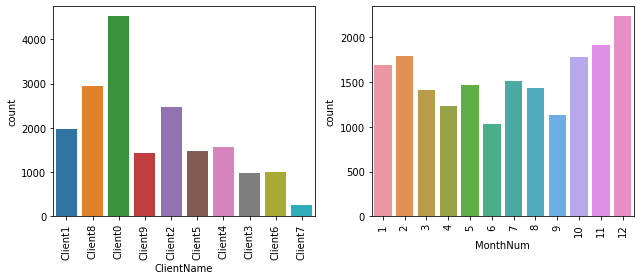

In [25]:
import seaborn as sns 
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = [9.00, 4.0]
plt.rcParams["figure.autolayout"] = True
f, axes = plt.subplots(1, 2)
sns.countplot(df_orderwise['ClientName'],ax=axes[0]).set_xticklabels(df_orderwise['ClientName'].unique(),rotation=90)
sns.countplot(df_orderwise['MonthNum'],ax=axes[1]).set_xticklabels(df_orderwise['MonthNum'].unique(),rotation=90)


plt.show()

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


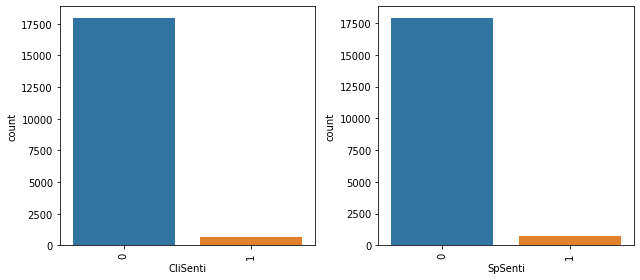

In [26]:
import seaborn as sns 
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = [9.00, 4.0]
plt.rcParams["figure.autolayout"] = True
f, axes = plt.subplots(1, 2)

sns.countplot(df_orderwise['CliSenti'],ax=axes[0]).set_xticklabels(df_orderwise['CliSenti'].unique(),rotation=90)
sns.countplot(df_orderwise['SpSenti'],ax=axes[1]).set_xticklabels(df_orderwise['SpSenti'].unique(),rotation=90)
plt.show()

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


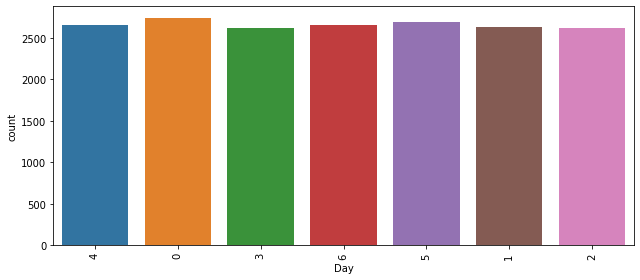

In [27]:
sns.countplot(df_orderwise['Day']).set_xticklabels(df_orderwise['Day'].unique(),rotation=90)
plt.show()

<AxesSubplot:ylabel='ClientName'>

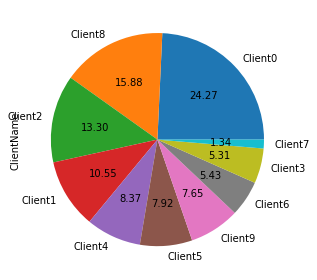

In [28]:
df_orderwise['ClientName'].value_counts().plot(kind='pie',autopct = '%.2f')

<AxesSubplot:ylabel='MonthNum'>

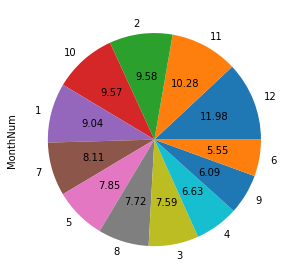

In [29]:
df_orderwise['MonthNum'].value_counts().plot(kind='pie',autopct = '%.2f')

<AxesSubplot:ylabel='Day'>

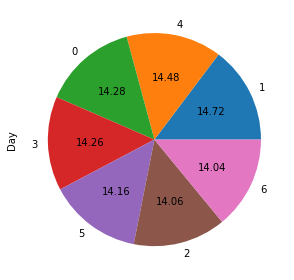

In [30]:
df_orderwise['Day'].value_counts().plot(kind='pie',autopct = '%.2f')

(array([ 422.,    0.,    0.,    0.,  244.,    0.,    0.,    0.,  142.,
           0.,    0.,    0.,    0.,   85.,    0.,    0.,    0.,   72.,
           0.,    0.,    0.,  134.,    0.,    0.,    0.,    0.,  240.,
           0.,    0.,    0.,  435.,    0.,    0.,    0.,  586.,    0.,
           0.,    0.,    0.,  873.,    0.,    0.,    0., 1060.,    0.,
           0.,    0., 1264.,    0.,    0.,    0.,    0., 1209.,    0.,
           0.,    0., 1187.,    0.,    0.,    0., 1164.,    0.,    0.,
           0.,    0., 1023.,    0.,    0.,    0., 1007.,    0.,    0.,
           0., 1149.,    0.,    0.,    0.,    0., 1243.,    0.,    0.,
           0., 1241.,    0.,    0.,    0., 1278.,    0.,    0.,    0.,
           0., 1088.,    0.,    0.,    0.,  862.,    0.,    0.,    0.,
         614.]),
 array([ 0.  ,  0.23,  0.46,  0.69,  0.92,  1.15,  1.38,  1.61,  1.84,
         2.07,  2.3 ,  2.53,  2.76,  2.99,  3.22,  3.45,  3.68,  3.91,
         4.14,  4.37,  4.6 ,  4.83,  5.06,  5.29,  5.52,  5.

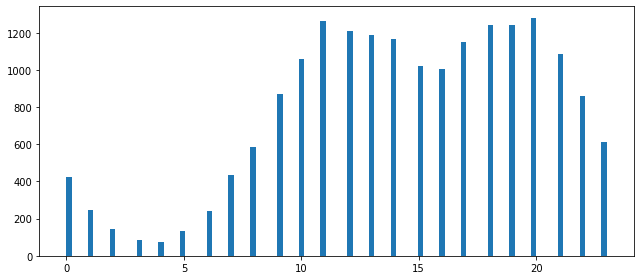

In [31]:
import matplotlib.pyplot as plt
plt.hist(df_orderwise['Hour'],bins=100)

(array([ 591., 2854., 5903., 5746., 2951.,  577.]),
 array([0.        , 0.16666667, 0.33333333, 0.5       , 0.66666667,
        0.83333333, 1.        ]),
 <BarContainer object of 6 artists>)

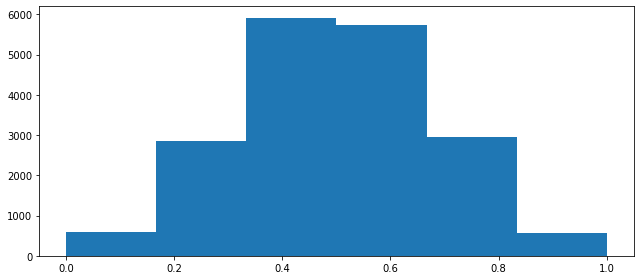

In [32]:
plt.hist(df_orderwise['CliAvgSenti'],bins=6)

(array([2680.,  532.,  348.,  265.,  225.,  199.,  145.,  149.,  127.,
         123.,  113.,  122.,  100.,  100.,   97.,   84.,   79.,   89.,
          63.,   67.,   69.,   54.,   63.,   67.,   77.,   73.,   62.,
          63.,   72.,   58.,   66.,   60.,   50.,   61.,   59.,   56.,
          50.,   46.,   49.,   51.,   49.,   56.,   60.,   54.,   42.,
          51.,   54.,   53.,   52.,   51.,   55.,   50.,   48.,   54.,
          65.,   47.,   41.,   54.,   50.,   59.,   54.,   54.,   54.,
          69.,   65.,   60.,   57.,   48.,   56.,   60.,   74.,   76.,
          85.,   67.,   65.,   66.,   73.,   71.,   79.,   85.,   96.,
          82.,   95.,   97.,  113.,  113.,  118.,  125.,  165.,  159.,
         144.,  174.,  187.,  205.,  234.,  319.,  364.,  560.,  892.,
        5104.]),
 array([2.13153971e-13, 1.00000000e-02, 2.00000000e-02, 3.00000000e-02,
        4.00000000e-02, 5.00000000e-02, 6.00000000e-02, 7.00000000e-02,
        8.00000000e-02, 9.00000000e-02, 1.00000000e-01, 1.

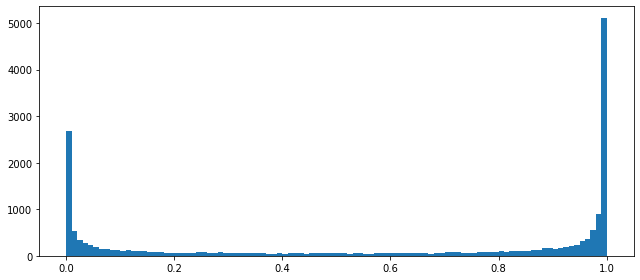

In [35]:
plt.hist(df_orderwise['ann_cli_senti'],bins=100)

(array([482., 431., 388., 323., 296., 259., 228., 231., 193., 186., 180.,
        173., 163., 151., 163., 140., 126., 157., 147., 138., 104., 115.,
        126., 137., 123., 116., 127., 122., 110., 116., 121., 116., 110.,
        120., 118.,  98., 123., 117., 123., 122., 114., 126., 108.,  99.,
        138., 115., 136., 125., 138., 120., 115., 111., 127., 122., 116.,
        150., 144., 116., 139., 126., 119., 131., 138., 149., 148., 155.,
        150., 153., 139., 160., 146., 171., 174., 142., 160., 168., 189.,
        194., 173., 153., 200., 221., 173., 223., 208., 226., 263., 244.,
        287., 303., 284., 299., 336., 365., 371., 382., 422., 493., 483.,
        323.]),
 array([0.00164412, 0.0116055 , 0.02156688, 0.03152826, 0.04148963,
        0.05145101, 0.06141239, 0.07137377, 0.08133515, 0.09129652,
        0.1012579 , 0.11121928, 0.12118066, 0.13114204, 0.14110342,
        0.15106479, 0.16102617, 0.17098755, 0.18094893, 0.19091031,
        0.20087168, 0.21083306, 0.22079444, 0.

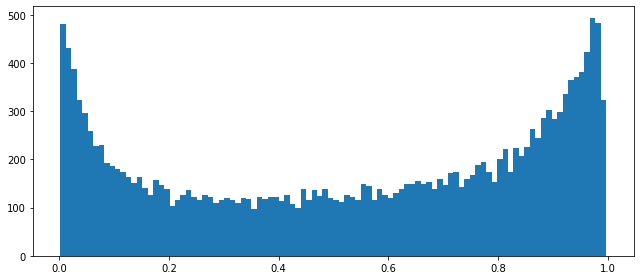

In [36]:
plt.hist(df_orderwise['gru_cli_senti'],bins=100)

(array([ 627., 2908., 5771., 5781., 2975.,  560.]),
 array([0.        , 0.16666667, 0.33333333, 0.5       , 0.66666667,
        0.83333333, 1.        ]),
 <BarContainer object of 6 artists>)

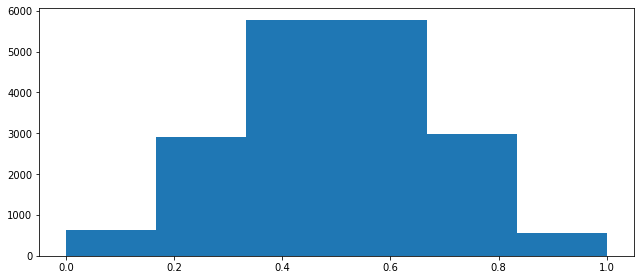

In [39]:
plt.hist(df_orderwise['SpAvgSenti'],bins=6)

(array([2762.,  518.,  341.,  244.,  199.,  158.,  156.,  146.,  145.,
         119.,  100.,  127.,  101.,   98.,  101.,   92.,   90.,   77.,
          86.,   78.,   72.,   72.,   57.,   70.,   82.,   67.,   64.,
          73.,   65.,   48.,   57.,   51.,   52.,   65.,   58.,   36.,
          52.,   50.,   53.,   54.,   50.,   52.,   60.,   50.,   55.,
          57.,   56.,   50.,   70.,   48.,   48.,   60.,   48.,   56.,
          51.,   50.,   54.,   46.,   46.,   59.,   62.,   63.,   60.,
          57.,   63.,   59.,   47.,   57.,   65.,   64.,   52.,   71.,
          93.,   65.,   80.,   74.,   71.,  102.,   76.,   77.,   63.,
          87.,   93.,  103.,   96.,  116.,  128.,  136.,  139.,  140.,
         157.,  172.,  188.,  209.,  262.,  337.,  355.,  511.,  810.,
        5160.]),
 array([4.64046423e-12, 1.00000000e-02, 2.00000000e-02, 3.00000000e-02,
        4.00000000e-02, 5.00000000e-02, 6.00000000e-02, 7.00000000e-02,
        8.00000000e-02, 9.00000000e-02, 1.00000000e-01, 1.

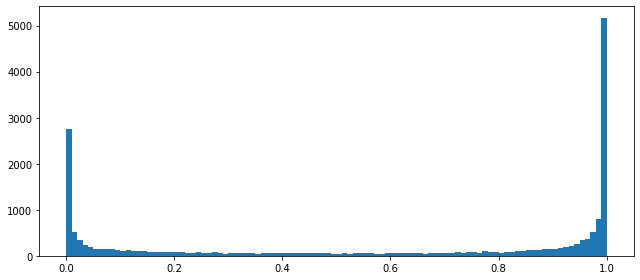

In [40]:
plt.hist(df_orderwise['ann_sp_senti'],bins=100)

(array([498., 446., 390., 315., 297., 255., 232., 190., 230., 186., 166.,
        179., 168., 154., 151., 160., 151., 159., 127., 150., 146., 141.,
        147., 130., 125., 102., 136., 108., 124., 132., 116., 117., 125.,
        102., 135., 106., 119., 135., 121., 122., 112., 104.,  93., 123.,
        124., 115., 143., 103., 126., 120., 123., 132., 112., 144., 143.,
        102., 117., 128., 142., 118., 141., 114., 118., 140., 152., 123.,
        117., 134., 137., 156., 149., 161., 161., 164., 176., 174., 162.,
        175., 170., 209., 193., 206., 216., 192., 237., 259., 234., 281.,
        282., 263., 297., 287., 323., 343., 367., 425., 397., 457., 494.,
        319.]),
 array([0.00164829, 0.01160738, 0.02156647, 0.03152556, 0.04148466,
        0.05144375, 0.06140284, 0.07136193, 0.08132102, 0.09128011,
        0.1012392 , 0.11119829, 0.12115738, 0.13111648, 0.14107557,
        0.15103466, 0.16099375, 0.17095284, 0.18091193, 0.19087102,
        0.20083011, 0.2107892 , 0.2207483 , 0.

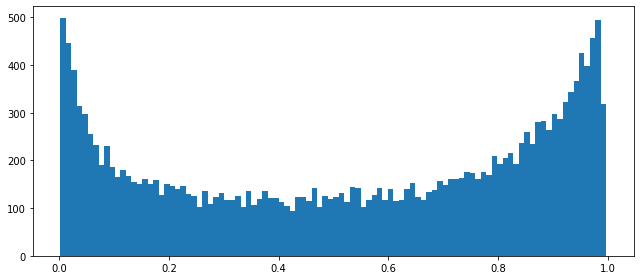

In [42]:
plt.hist(df_orderwise['gru_sp_senti'],bins=100)

(array([2.280e+02, 0.000e+00, 0.000e+00, 3.150e+02, 0.000e+00, 0.000e+00,
        3.650e+02, 0.000e+00, 0.000e+00, 4.980e+02, 0.000e+00, 0.000e+00,
        5.600e+02, 0.000e+00, 0.000e+00, 6.910e+02, 0.000e+00, 0.000e+00,
        7.780e+02, 0.000e+00, 0.000e+00, 9.370e+02, 0.000e+00, 0.000e+00,
        0.000e+00, 1.006e+03, 0.000e+00, 0.000e+00, 1.160e+03, 0.000e+00,
        0.000e+00, 1.260e+03, 0.000e+00, 0.000e+00, 1.255e+03, 0.000e+00,
        0.000e+00, 1.198e+03, 0.000e+00, 0.000e+00, 1.124e+03, 0.000e+00,
        0.000e+00, 1.092e+03, 0.000e+00, 0.000e+00, 9.550e+02, 0.000e+00,
        0.000e+00, 0.000e+00, 9.160e+02, 0.000e+00, 0.000e+00, 8.460e+02,
        0.000e+00, 0.000e+00, 6.710e+02, 0.000e+00, 0.000e+00, 6.730e+02,
        0.000e+00, 0.000e+00, 5.110e+02, 0.000e+00, 0.000e+00, 3.810e+02,
        0.000e+00, 0.000e+00, 2.830e+02, 0.000e+00, 0.000e+00, 2.450e+02,
        0.000e+00, 0.000e+00, 0.000e+00, 1.790e+02, 0.000e+00, 0.000e+00,
        1.520e+02, 0.000e+00, 0.000e+0

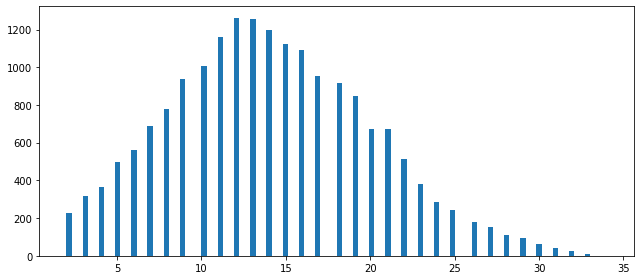

In [43]:
plt.hist(df_orderwise['QtyOrdered'],bins=100)

(array([  2.,   2.,   0.,   7.,   0.,  12.,   0.,  11.,   0.,  17.,   0.,
         25.,   0.,  24.,  57.,   0.,  47.,   0.,  47.,   0.,  66.,   0.,
         98.,   0., 141.,   0., 130., 110.,   0., 159.,   0.,  89.,   0.,
         93.,   0., 125.,   0.,  98.,   0., 139.,   0., 139., 166.,   0.,
        150.,   0., 116.,   0., 164.,   0., 116.,   0., 145.,   0., 126.,
        177.,   0., 134.,   0., 136.,   0., 181.,   0., 152.,   0., 169.,
          0., 210.,   0., 143., 161.,   0., 152.,   0., 133.,   0., 146.,
          0., 168.,   0., 187.,   0., 168., 164.,   0., 232.,   0., 159.,
          0., 147.,   0., 140.,   0., 173.,   0., 182.,   0., 165., 185.,
          0., 152.,   0., 175.,   0., 221.,   0., 179.,   0., 152.,   0.,
        153., 163.,   0., 141.,   0., 152.,   0., 192.,   0., 172.,   0.,
        174.,   0., 208.,   0., 154., 170.,   0., 184.,   0., 137.,   0.,
        144.,   0., 164.,   0., 166.,   0., 161., 175.,   0., 221.,   0.,
        146.,   0., 157.,   0., 144., 

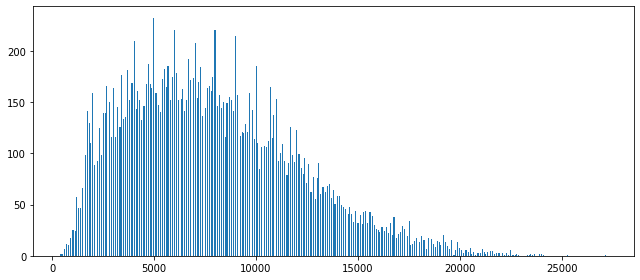

In [44]:
plt.hist(df_orderwise['Sales'],bins=500)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Hour', ylabel='Density'>

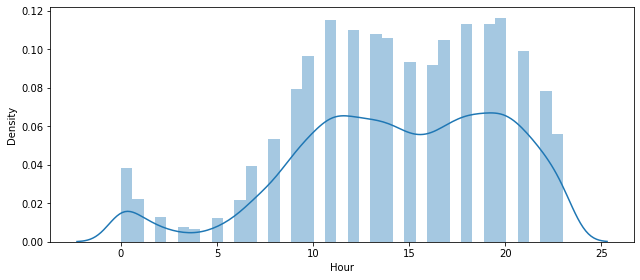

In [46]:
sns.distplot(df_orderwise['Hour'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='CliAvgSenti', ylabel='Density'>

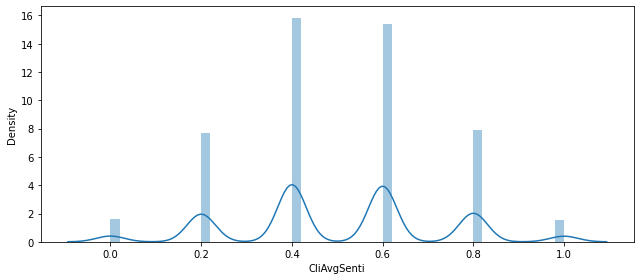

In [47]:
sns.distplot(df_orderwise['CliAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='ann_cli_senti', ylabel='Density'>

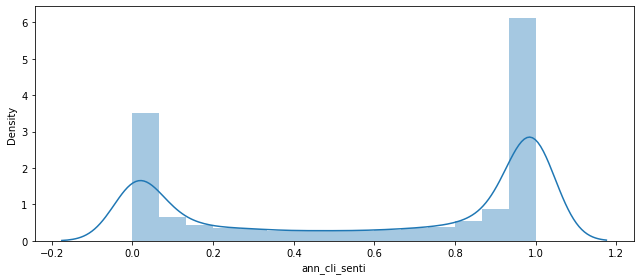

In [49]:
sns.distplot(df_orderwise['ann_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='gru_cli_senti', ylabel='Density'>

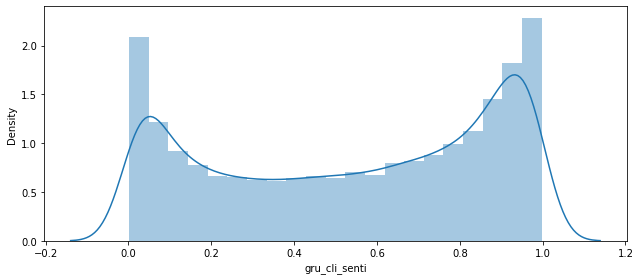

In [50]:
sns.distplot(df_orderwise['gru_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='SpAvgSenti', ylabel='Density'>

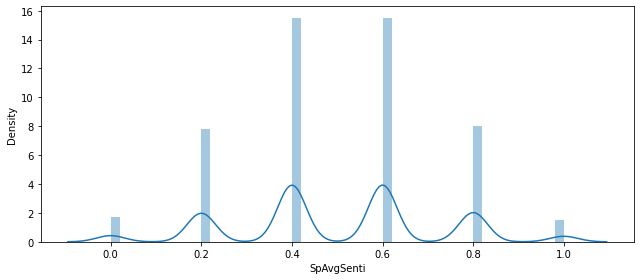

In [51]:
sns.distplot(df_orderwise['SpAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='ann_sp_senti', ylabel='Density'>

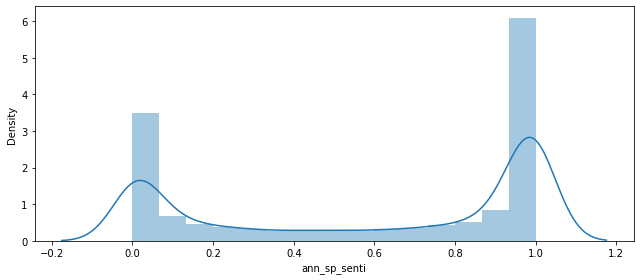

In [52]:
sns.distplot(df_orderwise['ann_sp_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='gru_sp_senti', ylabel='Density'>

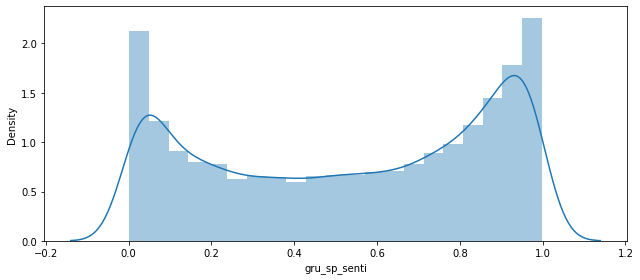

In [53]:
sns.distplot(df_orderwise['gru_sp_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='QtyOrdered', ylabel='Density'>

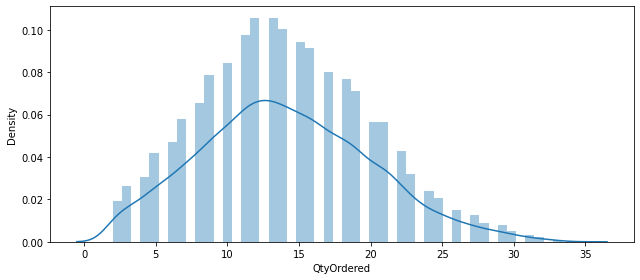

In [54]:
sns.distplot(df_orderwise['QtyOrdered'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Sales', ylabel='Density'>

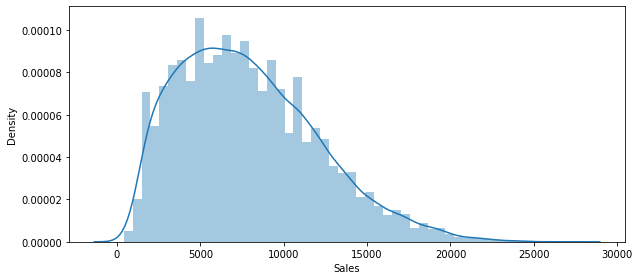

In [55]:
sns.distplot(df_orderwise['Sales'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Hour'>

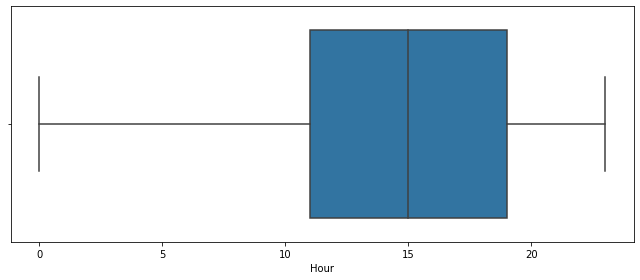

In [56]:
sns.boxplot(df_orderwise['Hour'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='CliAvgSenti'>

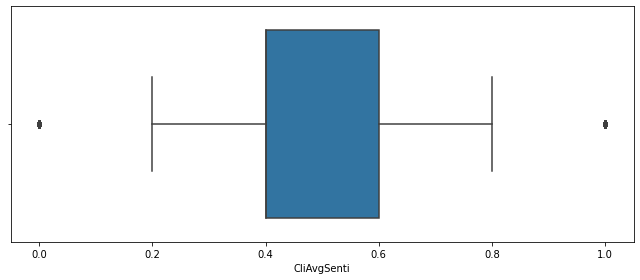

In [57]:
sns.boxplot(df_orderwise['CliAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ann_cli_senti'>

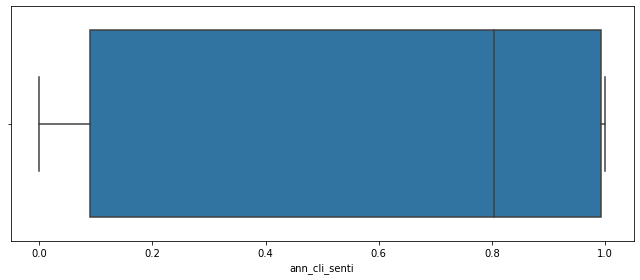

In [59]:
sns.boxplot(df_orderwise['ann_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='gru_cli_senti'>

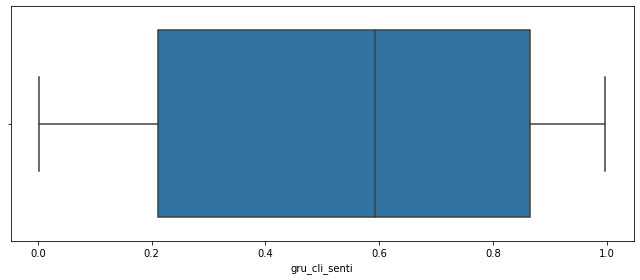

In [60]:
sns.boxplot(df_orderwise['gru_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='SpAvgSenti'>

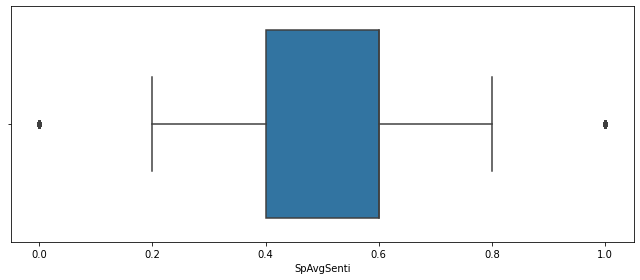

In [58]:
sns.boxplot(df_orderwise['SpAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ann_sp_senti'>

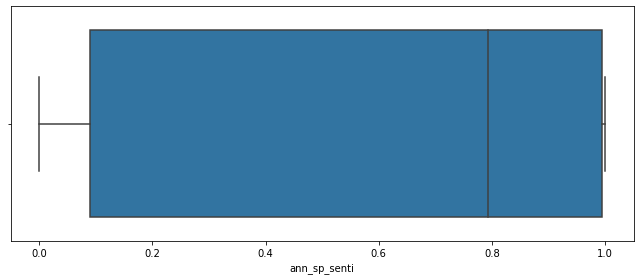

In [61]:
sns.boxplot(df_orderwise['ann_sp_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='gru_sp_senti'>

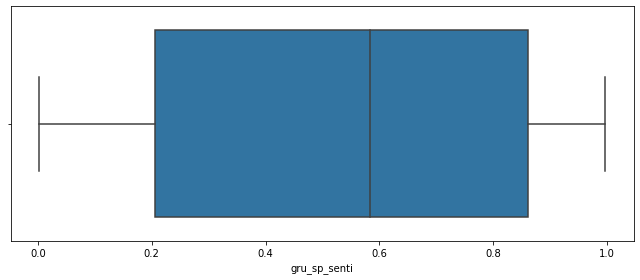

In [62]:
sns.boxplot(df_orderwise['gru_sp_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered'>

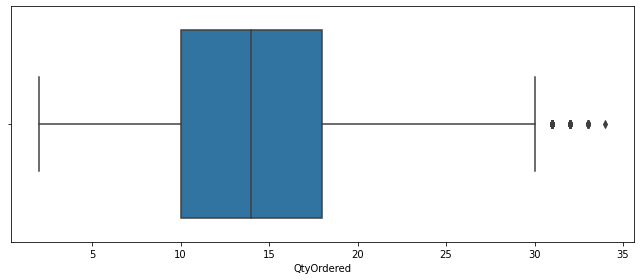

In [63]:
sns.boxplot(df_orderwise['QtyOrdered'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales'>

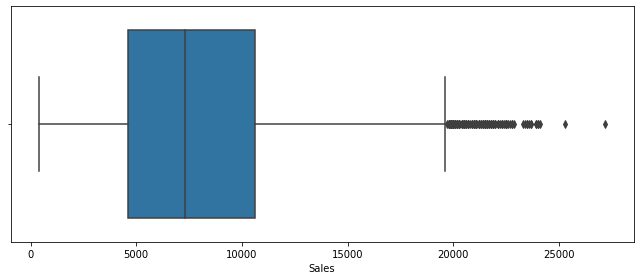

In [64]:
sns.boxplot(df_orderwise['Sales'])

In [65]:
import pandas as pd 
import seaborn as sns

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='QtyOrdered'>

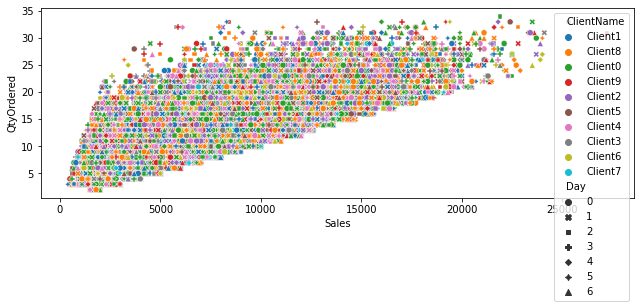

In [66]:
sns.scatterplot(df_orderwise['Sales'],df_orderwise['QtyOrdered'],hue=df_orderwise['ClientName'],style=df_orderwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='Hour'>

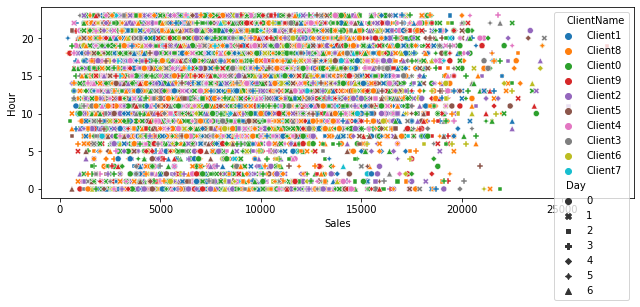

In [67]:
sns.scatterplot(df_orderwise['Sales'],df_orderwise['Hour'],hue=df_orderwise['ClientName'],style=df_orderwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='ann_sp_senti'>

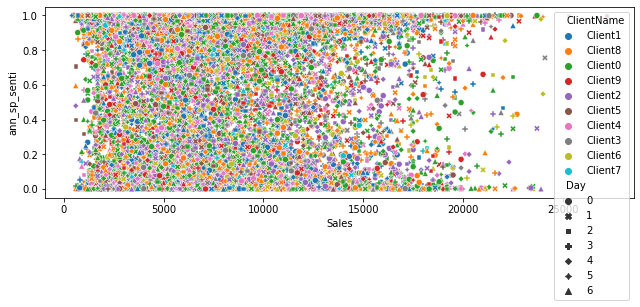

In [70]:
sns.scatterplot(df_orderwise['Sales'],df_orderwise['ann_sp_senti'],hue=df_orderwise['ClientName'],style=df_orderwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='gru_sp_senti'>

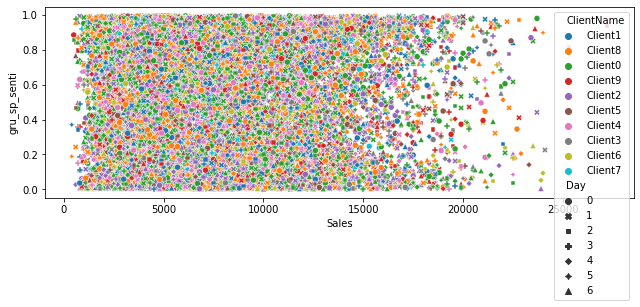

In [72]:
sns.scatterplot(df_orderwise['Sales'],df_orderwise['gru_sp_senti'],hue=df_orderwise['ClientName'],style=df_orderwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='ann_cli_senti'>

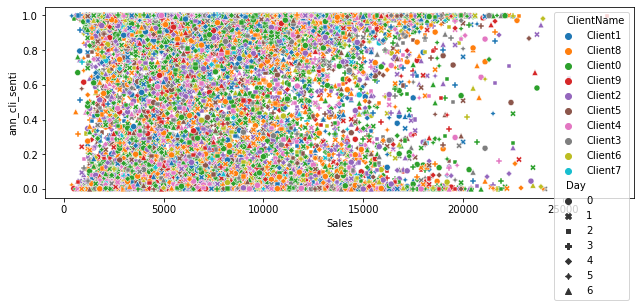

In [71]:
sns.scatterplot(df_orderwise['Sales'],df_orderwise['ann_cli_senti'],hue=df_orderwise['ClientName'],style=df_orderwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='gru_cli_senti'>

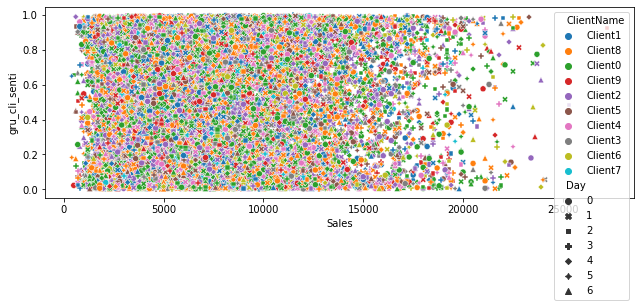

In [73]:
sns.scatterplot(df_orderwise['Sales'],df_orderwise['gru_cli_senti'],hue=df_orderwise['ClientName'],style=df_orderwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ClientName', ylabel='Sales'>

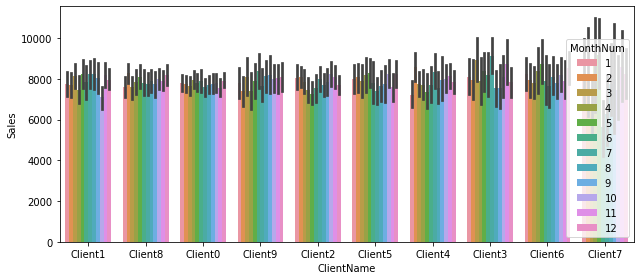

In [74]:
sns.barplot(df_orderwise['ClientName'],df_orderwise['Sales'],hue=df_orderwise['MonthNum'])


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ClientName', ylabel='Sales'>

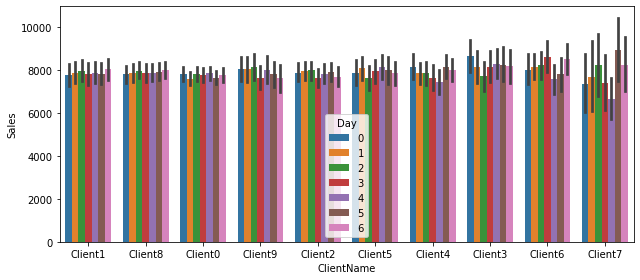

In [75]:
sns.barplot(df_orderwise['ClientName'],df_orderwise['Sales'],hue=df_orderwise['Day'])


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ClientName', ylabel='Sales'>

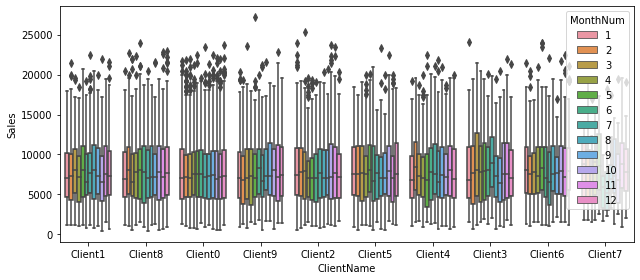

In [76]:
sns.boxplot(df_orderwise['ClientName'], df_orderwise['Sales'],hue=df_orderwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ClientName', ylabel='Sales'>

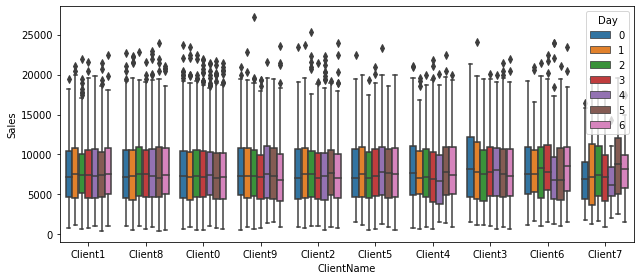

In [77]:
sns.boxplot(df_orderwise['ClientName'], df_orderwise['Sales'],hue=df_orderwise['Day'])

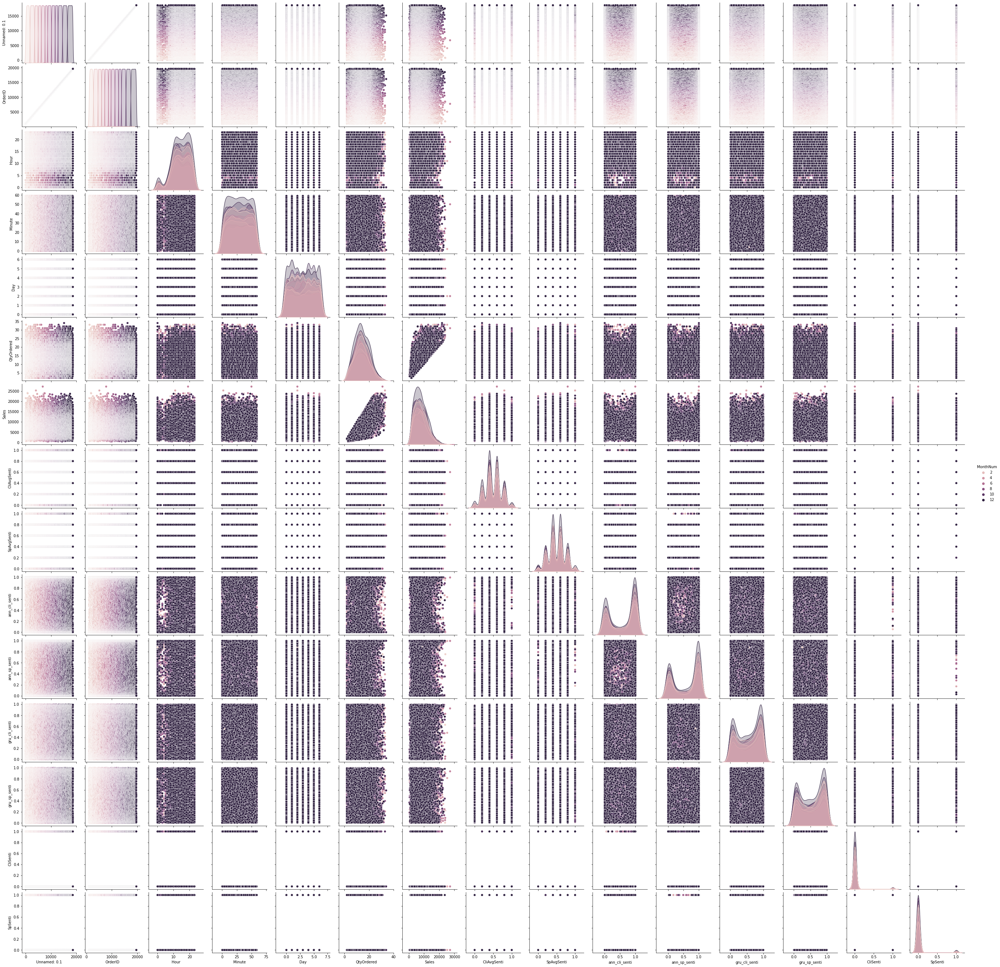

In [78]:
sns.pairplot(df_orderwise, hue="MonthNum")

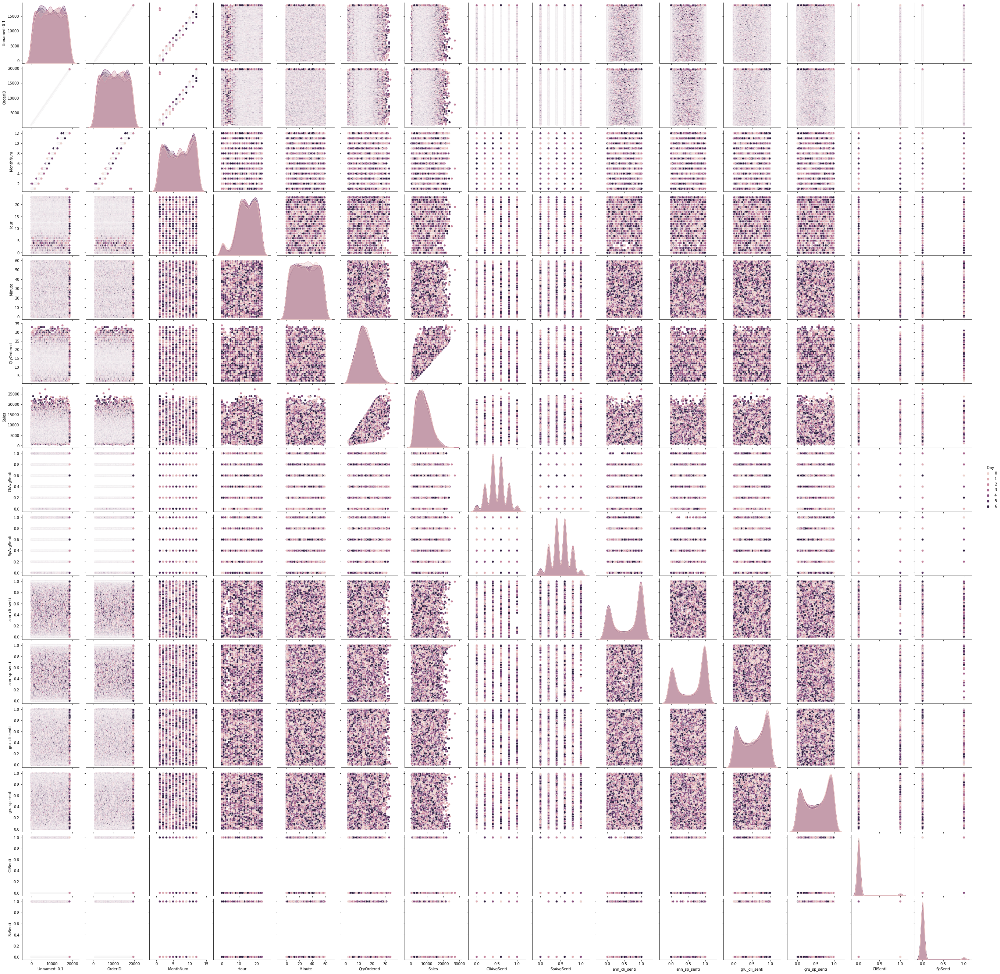

In [79]:
sns.pairplot(df_orderwise, hue="Day")

In [80]:
sns.pairplot(df_orderwise, hue="ClientName")

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7f1169d21040> (for post_execute):


KeyboardInterrupt: 

In [81]:
df_orderwise.corr()

,Unnamed: 0.1,OrderID,MonthNum,Hour,Minute,Day,QtyOrdered,Sales,CliAvgSenti,SpAvgSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
Unnamed: 0.1,1.000000,1.000000,0.993758,-0.009708,-0.003982,-0.004109,0.004635,0.007843,-0.008131,-0.011780,-0.004574,-0.012465,-0.005949,-0.016926,-0.004621,0.000002
OrderID,1.000000,1.000000,0.993758,-0.009708,-0.003982,-0.004109,0.004635,0.007843,-0.008131,-0.011780,-0.004574,-0.012465,-0.005949,-0.016926,-0.004621,0.000002
MonthNum,0.993758,0.993758,1.000000,-0.009813,-0.004063,-0.005260,0.003253,0.005980,-0.008140,-0.013321,-0.003539,-0.014527,-0.005645,-0.017939,-0.004994,-0.001493
Hour,-0.009708,-0.009708,-0.009813,1.000000,-0.016734,0.022627,-0.005468,-0.004783,0.006233,-0.001430,0.009000,-0.005788,0.009839,-0.001830,0.019270,-0.003426
Minute,-0.003982,-0.003982,-0.004063,-0.016734,1.000000,0.005795,-0.012470,-0.008606,0.004925,0.010079,0.008365,0.008724,0.010658,0.002695,0.001492,0.008006
Day,-0.004109,-0.004109,-0.005260,0.022627,0.005795,1.000000,-0.005840,-0.001894,0.002608,0.008563,-0.001619,0.001107,-0.007868,-0.008994,0.004589,0.011829
QtyOrdered,0.004635,0.004635,0.003253,-0.005468,-0.012470,-0.005840,1.000000,0.696091,-0.002028,-0.000417,-0.003481,-0.002156,-0.001787,0.001193,-0.009231,0.003153
Sales,0.007843,0.007843,0.005980,-0.004783,-0.008606,-0.001894,0.696091,1.000000,-0.004776,-0.005438,-0.009121,-0.007531,-0.008348,0.005179,-0.005124,0.008907
CliAvgSenti,-0.008131,-0.008131,-0.008140,0.006233,0.004925,0.002608,-0.002028,-0.004776,1.000000,0.004682,0.552922,-0.005943,0.307904,0.004310,0.211618,-0.001686
SpAvgSenti,-0.011780,-0.011780,-0.013321,-0.001430,0.010079,0.008563,-0.000417,-0.005438,0.004682,1.000000,-0.000429,0.562116,0.013101,0.323332,0.011859,0.215833


In [82]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_orderwise.ClientName = le.fit_transform(df_orderwise.ClientName)
df_orderwise.Prods = le.fit_transform(df_orderwise.Prods)

In [83]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_orderwise[['Prods']] = scaler.fit_transform(df_orderwise[['Prods']])


In [84]:
df_orderwise.head(2)

,Unnamed: 0.1,OrderID,ClientName,MonthNum,Hour,Minute,Day,Prods,QtyOrdered,Sales,CliAvgSenti,SpAvgSenti,CliChats,SpChats,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti,CliSenti,SpSenti
0,0,1001,1,1,20,51,4,0.439985,5,2400,0.8,0.6,"It's awesome! In Story Mode, your going from p...","OK, so in any Wile E. Coyote-Road Runner carto...",0.998079,0.996931,0.902179,0.942251,0,0
1,1,1002,8,1,21,3,0,0.641184,10,9500,0.4,0.4,This tender beautifully crafted production del...,"Man were do I start,everything about this Cart...",0.972840,0.998424,0.943390,0.383383,1,0


# Orderwise  
- predict : tot price of order [reg]

## Multiple Linear Regression

In [85]:
import pandas as pd
import numpy as np

import plotly.express as px
import plotly.graph_objects as go

from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [86]:
X = df_orderwise[['ClientName','Prods','MonthNum','Hour','Minute','Day','CliAvgSenti','SpAvgSenti','QtyOrdered','ann_cli_senti','ann_sp_senti','gru_cli_senti','gru_sp_senti','CliSenti','SpSenti']]
y = df_orderwise[['Sales']]

In [87]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=3)

In [88]:
from sklearn.linear_model import LinearRegression
mlr = LinearRegression()
mlr.fit(X_train,y_train)
y_pred = mlr.predict(X_test)

In [89]:
print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 2409.45131672436
MSE 9114908.5960189
RMSE 3019.0906902607117
R2Score 0.488439509728832


## Stochastic Gradient Descent

In [90]:
from sklearn.linear_model import SGDRegressor
reg = SGDRegressor(max_iter=100,learning_rate='constant',eta0=0.01)
reg.fit(X_train,y_train)
y_pred = reg.predict(X_test)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [91]:
print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 12840410642311.06
MSE 2.307324193507757e+26
RMSE 15189878845822.824
R2Score -1.2949508853669564e+19


## Mini Batch GD

In [92]:
import random
sgd = SGDRegressor(learning_rate='constant',eta0=0.25)
batch_size = 35 

for i in range(100):
    idx = random.sample(range(X_train.shape[0]),batch_size)
    sgd.partial_fit(X_train.iloc[idx],y_train.iloc[idx])
y_pred = sgd.predict(X_test)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed w

In [93]:
print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 196830015184568.28
MSE 4.708983902236212e+28
RMSE 217001933222637.72
R2Score -2.642846155099282e+21


## Polynomial Regression

In [94]:
from sklearn.preprocessing import PolynomialFeatures,StandardScaler
from sklearn.pipeline import Pipeline

In [95]:
poly = PolynomialFeatures(degree=2,include_bias=True) # bias is b0
X_train_trans = poly.fit_transform(X_train)
X_test_trans = poly.transform(X_test)

In [96]:
lr = LinearRegression()
lr.fit(X_train_trans,y_train)
y_pred = lr.predict(X_test_trans)

In [97]:
print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 2421.6748607523023
MSE 9217244.242487596
RMSE 3035.9914760235406
R2Score 0.48269607599844777


## Ridge Regression

In [98]:
from sklearn.linear_model import Ridge
R = Ridge(alpha = 0.0001)
R.fit(X_train,y_train)
y_pred1 = R.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 2409.451316654628
MSE 9114908.595481582
RMSE 3019.090690171725
R2Score 0.4884395097589881


## Lasso Regression

In [99]:
from sklearn.linear_model import Lasso 
L = Lasso(alpha = 0.0001)
L.fit(X_train,y_train)
y_pred1 = L.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 2409.451273724803
MSE 9114908.44889679
RMSE 3019.09066589541
R2Score 0.4884395179858384


## ElasticNet Regression

In [100]:
from sklearn.linear_model import ElasticNet
EL = ElasticNet(alpha = 0.005, l1_ratio = 0.50)
EL.fit(X_train,y_train)
y_pred1 = EL.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 2409.4355263926927
MSE 9114763.414254682
RMSE 3019.0666462095005
R2Score 0.48844765783626487


## Logistic Regression

In [101]:
from sklearn.linear_model import LogisticRegression
lor = LogisticRegression()
lor.fit(X_train,y_train)
y_pred1 = lor.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


MAE 3036.778523489933
MSE 15465744.966442954
RMSE 3932.6511371392903
R2Score 0.1320084020482698


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


## Decision Tree Regression

In [176]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import RandomizedSearchCV
rt = DecisionTreeRegressor(criterion = 'squared_error', max_depth = 5)
rt.fit(X_train,y_train)
y_pred1 = rt.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 2369.2137823329817
MSE 9053057.955492636
RMSE 3008.829997771997
R2Score 0.49191078359382945


In [181]:
#hyperparam tuning 
param_grid = {
    'max_depth':[2,4,5,8,10,12,14,None],
    'criterion':['squared_error','absolute_error'],
    'max_features':[0.25,0.5,0.75,1.0],
    'min_samples_split':[0.25,0.5,0.75,1.0]
}
reg = RandomizedSearchCV(estimator=DecisionTreeRegressor(),param_distributions=param_grid,cv=5,verbose=2,n_jobs=-1)
reg.fit(X_train,y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=DecisionTreeRegressor(), n_jobs=-1,
                   param_distributions={'criterion': ['squared_error',
                                                      'absolute_error'],
                                        'max_depth': [2, 4, 5, 8, 10, 12, 14,
                                                      None],
                                        'max_features': [0.25, 0.5, 0.75, 1.0],
                                        'min_samples_split': [0.25, 0.5, 0.75,
                                                              1.0]},
                   verbose=2)

In [182]:
print(reg.best_score_)
print(reg.best_params_)

0.4478329791605863
{'min_samples_split': 0.25, 'max_features': 1.0, 'max_depth': 4, 'criterion': 'squared_error'}


In [183]:
#feature importance 
for importance,name in sorted(zip(rt.feature_importances_,X_train.columns),reverse=True):
    print(name,importance)

QtyOrdered 0.9629967978322201
Prods 0.031739274380900004
gru_sp_senti 0.002939444628563141
gru_cli_senti 0.0010766726777657173
ann_cli_senti 0.0007219018783570412
ann_sp_senti 0.0005259086021937946
SpSenti 0.0
SpAvgSenti 0.0
MonthNum 0.0
Minute 0.0
Hour 0.0
Day 0.0
ClientName 0.0
CliSenti 0.0
CliAvgSenti 0.0
[CV] END criterion=absolute_error, max_depth=2, max_features=0.5, min_samples_split=0.25; total time=   4.1s
[CV] END criterion=absolute_error, max_depth=10, max_features=0.5, min_samples_split=1.0; total time=   2.4s
[CV] END criterion=squared_error, max_depth=5, max_features=1.0, min_samples_split=0.5; total time=   0.0s
[CV] END criterion=squared_error, max_depth=12, max_features=1.0, min_samples_split=0.75; total time=   0.0s
[CV] END criterion=absolute_error, max_depth=None, max_features=0.25, min_samples_split=0.5; total time=   1.5s
[CV] END criterion=absolute_error, max_depth=None, max_features=0.25, min_samples_split=0.5; total time=   4.6s
[CV] END criterion=squared_error

[CV] END criterion=squared_error, max_depth=10, max_features=1.0, min_samples_split=0.5; total time=   0.0s
[CV] END criterion=squared_error, max_depth=None, max_features=0.5, min_samples_split=0.5; total time=   0.0s
[CV] END criterion=squared_error, max_depth=None, max_features=0.5, min_samples_split=0.5; total time=   0.0s
[CV] END criterion=squared_error, max_depth=2, max_features=0.5, min_samples_split=1.0; total time=   0.0s
[CV] END criterion=squared_error, max_depth=2, max_features=0.5, min_samples_split=1.0; total time=   0.0s
[CV] END criterion=squared_error, max_depth=2, max_features=0.5, min_samples_split=1.0; total time=   0.0s
[CV] END criterion=absolute_error, max_depth=None, max_features=0.25, min_samples_split=0.5; total time=   1.5s
[CV] END criterion=absolute_error, max_depth=None, max_features=0.25, min_samples_split=0.5; total time=   2.1s
[CV] END criterion=absolute_error, max_depth=10, max_features=0.5, min_samples_split=1.0; total time=   1.9s
[CV] END criterion

## Voting Regressor

In [103]:
from sklearn.model_selection import cross_val_score
estimators = [('mlr',mlr),('poly',lr),('R',R),('L',L),('EL',EL),('rt',rt)]
for estimator in estimators :
    scores = cross_val_score(estimator[1],X,y,scoring='r2',cv=10)
    print(estimator[0],np.round(np.mean(scores),2))

mlr 0.48
poly 0.48
R 0.48
L 0.48
EL 0.48
rt 0.49


In [104]:
from sklearn.ensemble import VotingRegressor
vr = VotingRegressor(estimators)
scores = cross_val_score(vr,X,y,scoring='r2',cv=10)
print('voting regressor',np.round(np.mean(scores),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when 

voting regressor 0.49


## Bagging Regressor

In [105]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import BaggingRegressor
bag_regressor = BaggingRegressor(random_state = 1)
bag_regressor.fit(X_train,y_train)

y_pred1 = bag_regressor.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)


MAE 2290.668456375839
MSE 9244932.510067115
RMSE 3040.5480608053404
R2Score 0.48114211376300375


In [106]:
params = {'base_estimator':[None,mlr,lr,L,R,EL,rt],
             'n_estimators':[20,50,100],
          'max_samples':[0.5,1.0],
          'max_features':[0.5,1.0],
          'bootstrap':[True,False],
          'bootstrap_features':[True,False]
         }
bagging_regressor_grid = GridSearchCV(BaggingRegressor(random_state=1,n_jobs=-1),param_grid = params,cv=3,n_jobs=-1,verbose=-1)
bagging_regressor_grid.fit(X_train,y_train)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.078e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.294e+10, tolerance: 1.730e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.392e+09, tolerance: 1.768e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.841e+07, tolerance: 1.687e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.244e+08, tolerance: 1.738e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.078e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.416e+08, tolerance: 1.739e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.183e+08, tolerance: 1.753e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.467e+08, tolerance: 1.721e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.310e+09, tolerance: 1.688e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.356e+08, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.046e+10, tolerance: 1.718e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.044e+09, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.007e+10, tolerance: 1.727e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.533e+09, tolerance: 1.745e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.697e+10, tolerance: 1.754e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.083e+09, tolerance: 1.690e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.954e+07, tolerance: 1.768e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.280e+09, tolerance: 1.762e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.345e+09, tolerance: 1.708e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.615e+08, tolerance: 1.701e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.733e+10, tolerance: 1.704e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.435e+09, tolerance: 1.747e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.219e+10, tolerance: 1.750e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.374e+08, tolerance: 1.753e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.042e+10, tolerance: 1.731e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.164e+10, tolerance: 1.709e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.797e+08, tolerance: 1.727e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.289e+09, tolerance: 1.756e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.020e+09, tolerance: 1.739e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.425e+09, tolerance: 1.718e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.686e+10, tolerance: 1.756e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.124e+07, tolerance: 1.683e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.838e+10, tolerance: 1.744e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.625e+07, tolerance: 1.657e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.733e+10, tolerance: 1.737e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.011e+09, tolerance: 1.740e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.125e+08, tolerance: 1.696e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.339e+09, tolerance: 1.700e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.623e+07, tolerance: 1.745e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.227e+09, tolerance: 1.685e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.030e+09, tolerance: 1.688e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.444e+10, tolerance: 1.719e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.840e+09, tolerance: 1.729e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.083e+09, tolerance: 1.690e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.169e+09, tolerance: 1.767e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.317e+10, tolerance: 1.752e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.473e+09, tolerance: 1.695e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.017e+10, tolerance: 1.670e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.375e+09, tolerance: 1.760e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.439e+09, tolerance: 1.779e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.344e+09, tolerance: 1.687e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.012e+10, tolerance: 1.798e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.156e+09, tolerance: 1.695e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.092e+07, tolerance: 1.762e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.660e+09, tolerance: 1.679e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.498e+10, tolerance: 1.672e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.682e+09, tolerance: 1.712e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.803e+08, tolerance: 1.694e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.714e+09, tolerance: 1.699e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.027e+08, tolerance: 1.695e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.509e+09, tolerance: 1.645e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.281e+09, tolerance: 1.747e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-pack

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.670e+08, tolerance: 1.767e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.360e+07, tolerance: 1.747e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.155e+07, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.415e+09, tolerance: 1.721e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.628e+08, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.735e+08, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.268e+07, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.353e+07, tolerance: 1.756e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.877e+09, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.553e+09, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.053e+08, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.217e+10, tolerance: 1.733e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.386e+08, tolerance: 1.710e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.091e+10, tolerance: 1.705e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.619e+10, tolerance: 1.720e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.541e+08, tolerance: 1.749e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.703e+10, tolerance: 1.752e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.062e+09, tolerance: 1.766e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.258e+09, tolerance: 1.768e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.414e+10, tolerance: 1.738e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.473e+09, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.258e+09, tolerance: 1.768e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.646e+08, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.510e+09, tolerance: 1.735e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.640e+09, tolerance: 1.715e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.575e+10, tolerance: 1.772e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.230e+08, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.098e+08, tolerance: 1.741e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.350e+10, tolerance: 1.752e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.129e+08, tolerance: 1.699e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.732e+09, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.280e+08, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.703e+10, tolerance: 1.752e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.260e+09, tolerance: 1.706e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.818e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.141e+09, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.298e+09, tolerance: 1.753e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.934e+07, tolerance: 1.730e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.212e+10, tolerance: 1.737e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.612e+09, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.664e+09, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.090e+08, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.854e+09, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.530e+09, tolerance: 1.723e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.872e+08, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.745e+09, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.732e+09, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.582e+09, tolerance: 1.716e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.098e+09, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.278e+08, tolerance: 1.716e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.854e+09, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.125e+08, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.117e+08, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.951e+08, tolerance: 1.748e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.533e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.224e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.696e+09, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.257e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.692e+08, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.143e+09, tolerance: 1.748e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.638e+10, tolerance: 1.731e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.501e+10, tolerance: 1.710e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.348e+10, tolerance: 1.701e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.431e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.115e+10, tolerance: 1.712e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.513e+10, tolerance: 1.719e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.962e+10, tolerance: 1.699e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.920e+10, tolerance: 1.723e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.521e+10, tolerance: 1.771e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.192e+10, tolerance: 1.719e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.022e+10, tolerance: 1.699e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.325e+10, tolerance: 1.712e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.963e+10, tolerance: 1.712e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.295e+10, tolerance: 1.674e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.102e+10, tolerance: 1.763e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.047e+10, tolerance: 1.738e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.069e+10, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.981e+10, tolerance: 1.755e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.325e+09, tolerance: 1.697e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.376e+10, tolerance: 1.744e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.537e+10, tolerance: 1.732e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.003e+10, tolerance: 1.704e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.261e+10, tolerance: 1.758e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.288e+10, tolerance: 1.653e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.683e+10, tolerance: 1.723e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.102e+10, tolerance: 1.763e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.422e+10, tolerance: 1.724e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.557e+10, tolerance: 1.703e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.921e+10, tolerance: 1.741e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.683e+10, tolerance: 1.723e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.303e+10, tolerance: 1.638e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.416e+10, tolerance: 1.671e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.390e+10, tolerance: 1.719e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.450e+10, tolerance: 1.719e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.517e+10, tolerance: 1.732e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.648e+10, tolerance: 1.738e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.049e+10, tolerance: 1.745e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.885e+07, tolerance: 1.740e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.518e+10, tolerance: 1.743e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.382e+10, tolerance: 1.756e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.067e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.132e+10, tolerance: 1.721e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.729e+10, tolerance: 1.769e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.047e+10, tolerance: 1.718e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.348e+10, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.405e+10, tolerance: 1.645e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.477e+10, tolerance: 1.695e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.853e+10, tolerance: 1.721e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.233e+10, tolerance: 1.759e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.158e+10, tolerance: 1.714e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.244e+10, tolerance: 1.809e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.258e+10, tolerance: 1.782e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.187e+10, tolerance: 1.774e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.402e+10, tolerance: 1.732e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.250e+10, tolerance: 1.775e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.344e+10, tolerance: 1.718e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.548e+10, tolerance: 1.758e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.329e+10, tolerance: 1.657e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.113e+10, tolerance: 1.785e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.885e+07, tolerance: 1.740e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.107e+10, tolerance: 1.744e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.315e+10, tolerance: 1.712e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.833e+10, tolerance: 1.740e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.449e+10, tolerance: 1.697e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.470e+10, tolerance: 1.711e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.685e+10, tolerance: 1.744e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.392e+10, tolerance: 1.708e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.146e+10, tolerance: 1.728e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.694e+10, tolerance: 1.768e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.778e+10, tolerance: 1.788e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.960e+10, tolerance: 1.679e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.355e+10, tolerance: 1.711e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.505e+10, tolerance: 1.778e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.429e+10, tolerance: 1.700e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.966e+10, tolerance: 1.704e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.818e+09, tolerance: 1.754e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.133e+10, tolerance: 1.764e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.578e+10, tolerance: 1.666e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.370e+10, tolerance: 1.704e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.386e+10, tolerance: 1.734e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.338e+10, tolerance: 1.688e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.446e+10, tolerance: 1.754e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.731e+10, tolerance: 1.744e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.821e+10, tolerance: 1.750e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.163e+10, tolerance: 1.705e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.073e+09, tolerance: 1.744e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.204e+10, tolerance: 1.783e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.558e+10, tolerance: 1.693e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.453e+10, tolerance: 1.757e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.441e+10, tolerance: 1.706e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.686e+10, tolerance: 1.752e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.632e+10, tolerance: 1.741e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.659e+10, tolerance: 1.761e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.309e+10, tolerance: 1.717e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.372e+10, tolerance: 1.694e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-pack

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.408e+10, tolerance: 1.751e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.439e+10, tolerance: 1.727e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.933e+10, tolerance: 1.760e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.366e+10, tolerance: 1.732e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.589e+10, tolerance: 1.644e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.458e+10, tolerance: 1.754e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.487e+10, tolerance: 1.720e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.022e+10, tolerance: 1.705e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.427e+10, tolerance: 1.702e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.730e+10, tolerance: 1.709e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.853e+10, tolerance: 1.756e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.208e+10, tolerance: 1.735e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.463e+10, tolerance: 1.721e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.908e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.688e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.197e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.473e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.861e+10, tolerance: 1.733e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.492e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.994e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.454e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.536e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.630e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.454e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.185e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.747e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.397e+10, tolerance: 1.742e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.095e+10, tolerance: 1.760e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.262e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.568e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.761e+10, tolerance: 1.703e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.824e+10, tolerance: 1.754e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.639e+10, tolerance: 1.763e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.486e+10, tolerance: 1.779e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.335e+10, tolerance: 1.704e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.465e+10, tolerance: 1.753e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.575e+10, tolerance: 1.674e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.639e+10, tolerance: 1.763e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.471e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.936e+10, tolerance: 1.769e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.690e+10, tolerance: 1.695e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.451e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.499e+10, tolerance: 1.711e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.639e+10, tolerance: 1.743e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.258e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.764e+10, tolerance: 1.740e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.441e+10, tolerance: 1.707e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.522e+10, tolerance: 1.746e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.678e+10, tolerance: 1.739e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.847e+10, tolerance: 1.696e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.281e+10, tolerance: 1.715e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.761e+10, tolerance: 1.703e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.712e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.472e+10, tolerance: 1.705e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.552e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.464e+10, tolerance: 1.774e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.122e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.622e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.743e+10, tolerance: 1.714e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.470e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.699e+10, tolerance: 1.738e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.474e+10, tolerance: 1.740e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.258e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.451e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.470e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.444e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.395e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.652e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.382e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.551e+07, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.975e+09, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.445e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.703e+10, tolerance: 1.738e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.172e+10, tolerance: 1.728e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.318e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.681e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.061e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.899e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.551e+07, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.446e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.771e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.936e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.156e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.468e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.920e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.607e+10, tolerance: 1.798e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.965e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.467e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.668e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.562e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.969e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.163e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.509e+10, tolerance: 1.748e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.633e+09, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.674e+10, tolerance: 1.716e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.423e+09, tolerance: 1.725e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.402e+10, tolerance: 1.725e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-pack

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

GridSearchCV(cv=3, estimator=BaggingRegressor(n_jobs=-1, random_state=1),
             n_jobs=-1,
             param_grid={'base_estimator': [None, LinearRegression(),
                                            LinearRegression(),
                                            Lasso(alpha=0.0001),
                                            Ridge(alpha=0.0001),
                                            ElasticNet(alpha=0.005),
                                            DecisionTreeRegressor(max_depth=5)],
                         'bootstrap': [True, False],
                         'bootstrap_features': [True, False],
                         'max_features': [0.5, 1.0], 'max_samples': [0.5, 1.0],
                         'n_estimators': [20, 50, 100]},
             verbose=-1)

In [107]:
print('train r2',bagging_regressor_grid.best_estimator_.score(X_train,y_train))
print('test r2',bagging_regressor_grid.best_estimator_.score(X_test,y_test))
print('best r2 score through grid search ',bagging_regressor_grid.best_score_)
print('best parameters',bagging_regressor_grid.best_params_)

train r2 0.8816873647473678
test r2 0.5347426878380015
best r2 score through grid search  0.5200461309762162
best parameters {'base_estimator': None, 'bootstrap': False, 'bootstrap_features': False, 'max_features': 1.0, 'max_samples': 0.5, 'n_estimators': 100}


## Random Forest Regressor

In [108]:
from sklearn.ensemble import RandomForestRegressor
raf = RandomForestRegressor(n_estimators=500).fit(X_train,y_train)
y_pred1 = raf.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

/tmp/ipykernel_4275/728011333.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  raf = RandomForestRegressor(n_estimators=500).fit(X_train,y_train)


MAE 2178.57610738255
MSE 8192606.105256377
RMSE 2862.272891472156
R2Score 0.5402023452397519


In [109]:
rf=RandomForestRegressor(oob_score = True)
rf.fit(X_train,y_train)
rf.oob_score_

/tmp/ipykernel_4275/1321434785.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X_train,y_train)


0.5286130608970272

## XGBoost

In [110]:
from xgboost import XGBRegressor

In [111]:
model = XGBRegressor(random_state=42, n_jobs=-1, n_estimators=20, max_depth=4)

In [112]:
model.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.300000012, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=4, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=20, n_jobs=-1,
             num_parallel_tree=1, predictor='auto', random_state=42, ...)

In [113]:
y_pred1 = model.predict(X_test)

In [114]:
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 2179.771699579226
MSE 7851449.106505965
RMSE 2802.043737436296
R2Score 0.5593492669781033


In [115]:
#feature importance 
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

In [116]:
importance_df.head(10)

,feature,importance
8,QtyOrdered,0.770096
1,Prods,0.068037
12,gru_sp_senti,0.025108
10,ann_sp_senti,0.024946
6,CliAvgSenti,0.021392
4,Minute,0.019963
9,ann_cli_senti,0.017707
11,gru_cli_senti,0.017510
0,ClientName,0.011347
3,Hour,0.011161


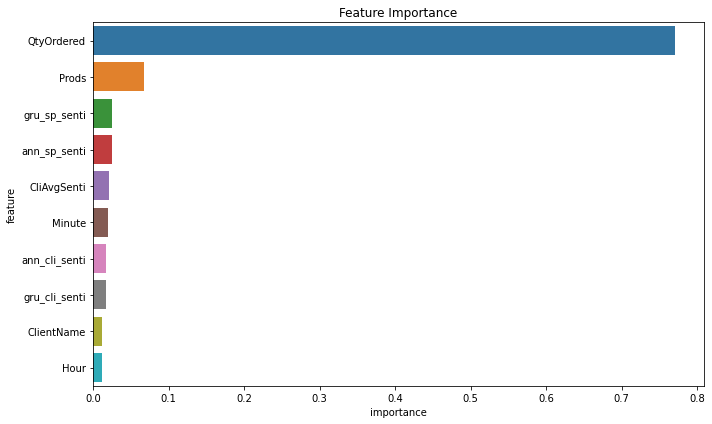

In [117]:
import seaborn as sns
plt.figure(figsize=(10,6))
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

In [126]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

#hyperparam tuning 
param_grid = {
    'n_estimators':[20,50,150,240],
    'max_depth':[2,4,8,10,None],
    'learning_rate':[0.01,0.1,0.3,0.9,0.99]
}

In [128]:
reg = RandomizedSearchCV(estimator=XGBRegressor(),param_distributions=param_grid,cv=5,verbose=2,n_jobs=-1)

In [129]:
reg.fit(X_train,y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, gpu_id=None,
                                          grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=...
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=None,
                                          max_leaves=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n_jobs=None,
                                          num_parallel_tree=None,
                                          predictor=None, random_state=None, ...),
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.01, 0.1, 0.3, 0.9,
                                                          0.99],
                                        'max_depth': [2, 4, 8, 10, None],
                                        'n_estimators': [20, 50, 150, 240]},
                   verbose=2)

In [130]:
reg.best_score_

0.6330988460777667

In [131]:
reg.best_params_

{'n_estimators': 240, 'max_depth': 10, 'learning_rate': 0.1}

# Productwise 
- predict : prodName [classif], clientName [classif], sale [reg]

## EDA - prodwise

In [2]:
import pandas as pd
df_productwise = pd.read_csv("../1_mockData/try1/productwise.csv")

df_productwise.shape

(59094, 19)

In [256]:
df_productwise.head(2)

,Unnamed: 0,ProdName,ClientName,MonthNum,OrderID,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
0,0,prod4,Client2,12,17393,22,14900,0.4,1.0,800,8,30,4,0,0,0.94666,0.999832,0.275266,0.981894
1,1,prod12,Client2,12,17393,22,14900,0.4,1.0,1600,8,30,4,0,0,0.94666,0.999832,0.275266,0.981894


In [251]:
df_productwise.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59094 entries, 0 to 59093
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     59094 non-null  int64  
 1   ProdName       59094 non-null  object 
 2   ClientName     59094 non-null  object 
 3   MonthNum       59094 non-null  int64  
 4   OrderID        59094 non-null  int64  
 5   OrderQty       59094 non-null  int64  
 6   OrderTotal     59094 non-null  int64  
 7   CliAvgSenti    59094 non-null  float64
 8   SpAvgSenti     59094 non-null  float64
 9   ProdPrice      59094 non-null  int64  
 10  Hour           59094 non-null  int64  
 11  Minute         59094 non-null  int64  
 12  Day            59094 non-null  int64  
 13  CliSenti       59094 non-null  int64  
 14  SpSenti        59094 non-null  int64  
 15  ann_cli_senti  59094 non-null  float64
 16  ann_sp_senti   59094 non-null  float64
 17  gru_cli_senti  59094 non-null  float64
 18  gru_sp

In [252]:
df_productwise.describe()

,Unnamed: 0,MonthNum,OrderID,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
count,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,59094.000000,5.909400e+04,5.909400e+04,59094.000000,59094.000000
mean,29546.500000,6.756625,10307.503486,14.778370,8144.512133,0.500074,0.499499,2483.805462,14.386435,29.535943,2.985278,0.034284,0.038109,5.955694e-01,5.932365e-01,0.542111,0.537281
std,17059.112741,3.692392,5384.004816,5.997563,4267.226697,0.223081,0.224930,2601.863479,5.454307,17.390200,1.997694,0.181960,0.191460,4.170213e-01,4.172513e-01,0.336027,0.337184
min,0.000000,1.000000,1001.000000,2.000000,400.000000,0.000000,0.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.131540e-13,4.640464e-12,0.001644,0.001648
25%,14773.250000,3.000000,5642.000000,11.000000,4800.000000,0.400000,0.400000,600.000000,11.000000,14.250000,1.000000,0.000000,0.000000,9.016133e-02,8.958612e-02,0.212064,0.204707
50%,29546.500000,7.000000,10313.000000,14.000000,7600.000000,0.400000,0.600000,1200.000000,15.000000,29.000000,3.000000,0.000000,0.000000,8.040720e-01,7.934299e-01,0.593355,0.583390
75%,44319.750000,10.000000,14978.000000,19.000000,10900.000000,0.600000,0.600000,3600.000000,19.000000,45.000000,5.000000,0.000000,0.000000,9.929500e-01,9.936613e-01,0.866161,0.861991
max,59093.000000,12.000000,19622.000000,34.000000,27200.000000,1.000000,1.000000,11000.000000,23.000000,59.000000,6.000000,1.000000,1.000000,1.000000e+00,1.000000e+00,0.997782,0.997557


In [253]:
df_productwise.isnull().sum()

Unnamed: 0       0
ProdName         0
ClientName       0
MonthNum         0
OrderID          0
OrderQty         0
OrderTotal       0
CliAvgSenti      0
SpAvgSenti       0
ProdPrice        0
Hour             0
Minute           0
Day              0
CliSenti         0
SpSenti          0
ann_cli_senti    0
ann_sp_senti     0
gru_cli_senti    0
gru_sp_senti     0
dtype: int64

In [254]:
df_productwise.duplicated().sum()

0

In [255]:
df_productwise.corr()

,Unnamed: 0,MonthNum,OrderID,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
Unnamed: 0,1.000000,-0.410060,-0.405015,-0.000287,-0.004562,0.021202,0.003097,-0.002647,0.002930,-0.009755,0.031692,0.004925,0.000737,0.025790,0.005337,0.004790,0.005567
MonthNum,-0.410060,1.000000,0.993808,0.003492,0.007041,-0.009572,-0.015860,0.003818,-0.009726,-0.002125,-0.003232,-0.004305,0.000983,-0.005618,-0.014825,-0.003767,-0.017450
OrderID,-0.405015,0.993808,1.000000,0.004616,0.008831,-0.009790,-0.014356,0.004676,-0.009682,-0.002332,-0.002492,-0.003850,0.002390,-0.006725,-0.012715,-0.004108,-0.016628
OrderQty,-0.000287,0.003492,0.004616,1.000000,0.701838,-0.001537,-0.002474,0.235866,-0.007323,-0.015912,-0.005597,-0.005954,0.005955,-0.003761,-0.003756,-0.001067,0.001654
OrderTotal,-0.004562,0.007041,0.008831,0.701838,1.000000,-0.004980,-0.007702,0.437902,-0.005482,-0.010302,-0.002666,-0.002746,0.010229,-0.009061,-0.008855,-0.007188,0.005505
CliAvgSenti,0.021202,-0.009572,-0.009790,-0.001537,-0.004980,1.000000,0.001802,-0.001273,0.007231,0.004428,0.003557,0.209801,-0.001572,0.552213,-0.008258,0.307501,0.002357
SpAvgSenti,0.003097,-0.015860,-0.014356,-0.002474,-0.007702,0.001802,1.000000,-0.003455,-0.004904,0.008792,0.009210,0.008854,0.214051,-0.004177,0.562027,0.010238,0.322865
ProdPrice,-0.002647,0.003818,0.004676,0.235866,0.437902,-0.001273,-0.003455,1.000000,-0.002022,-0.004509,-0.000801,0.001477,0.004334,-0.005679,-0.004051,-0.006337,0.002301
Hour,0.002930,-0.009726,-0.009682,-0.007323,-0.005482,0.007231,-0.004904,-0.002022,1.000000,-0.014223,0.024788,0.019883,-0.001495,0.007455,-0.006352,0.010659,-0.003034
Minute,-0.009755,-0.002125,-0.002332,-0.015912,-0.010302,0.004428,0.008792,-0.004509,-0.014223,1.000000,0.003660,0.001825,0.007517,0.007874,0.008353,0.010374,0.002509


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


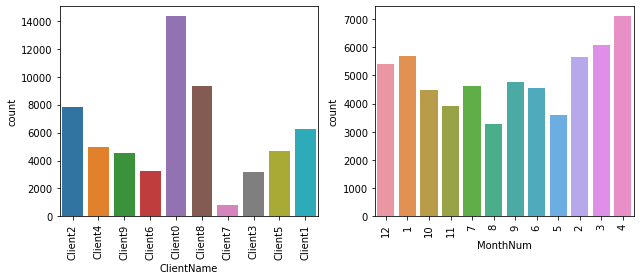

In [257]:
#class type - discrete columns
import seaborn as sns 
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = [9.00, 4.0]
plt.rcParams["figure.autolayout"] = True
f, axes = plt.subplots(1, 2)
sns.countplot(df_productwise['ClientName'],ax=axes[0]).set_xticklabels(df_productwise['ClientName'].unique(),rotation=90)
sns.countplot(df_productwise['MonthNum'],ax=axes[1]).set_xticklabels(df_productwise['MonthNum'].unique(),rotation=90)


plt.show()

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


[Text(0, 0, '4'),
 Text(1, 0, '3'),
 Text(2, 0, '5'),
 Text(3, 0, '6'),
 Text(4, 0, '2'),
 Text(5, 0, '1'),
 Text(6, 0, '0')]

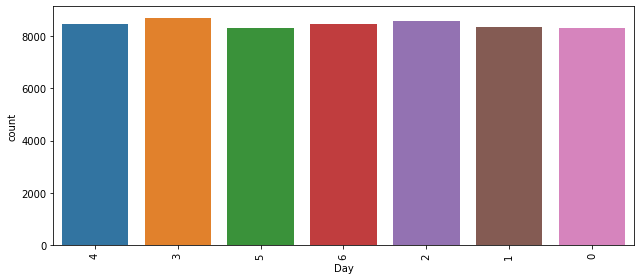

In [259]:
sns.countplot(df_productwise['Day']).set_xticklabels(df_productwise['Day'].unique(),rotation=90)


<AxesSubplot:ylabel='ClientName'>

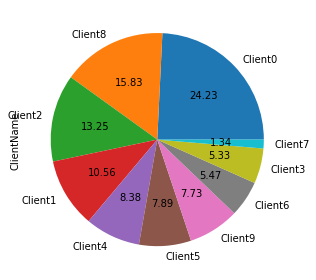

In [261]:
df_productwise['ClientName'].value_counts().plot(kind='pie',autopct = '%.2f')

<AxesSubplot:ylabel='MonthNum'>

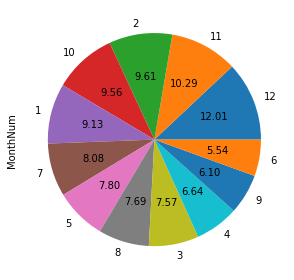

In [262]:
df_productwise['MonthNum'].value_counts().plot(kind='pie',autopct = '%.2f')

<AxesSubplot:ylabel='Day'>

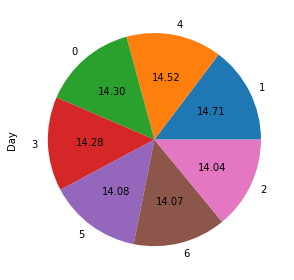

In [263]:
df_productwise['Day'].value_counts().plot(kind='pie',autopct = '%.2f')

(array([5394.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        5677.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        4472.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        3921.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        4609.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        3271.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        4773.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        4547.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        3603.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        5649.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        6083.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        7095.]),
 array([ 1.  ,  1.11,  1.22,  1.33,  1.44,  1.55,  1.66,  1.77,  1.88,
         1.99,  2.1 ,  2.21,  2.32,  2.43,  2.54,  2.65,  2.76,  2.87,
         2.98,  3.09,  3.2 ,  3.31,  3.42,  3.53,  3.64,  3.

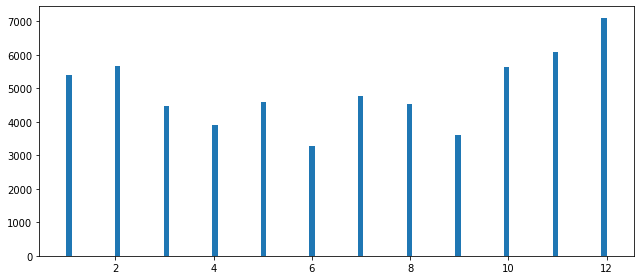

In [266]:
# discrete ,continuous
import matplotlib.pyplot as plt
plt.hist(df_productwise['MonthNum'],bins=100)

(array([ 456.,    0.,    0.,  741.,    0.,    0.,  894.,    0.,    0.,
        1309.,    0.,    0., 1507.,    0.,    0., 1899.,    0.,    0.,
        2207.,    0.,    0., 2702.,    0.,    0.,    0., 2955.,    0.,
           0., 3434.,    0.,    0., 3785.,    0.,    0., 3983.,    0.,
           0., 3865.,    0.,    0., 3665.,    0.,    0., 3601.,    0.,
           0., 3211.,    0.,    0.,    0., 3086.,    0.,    0., 2925.,
           0.,    0., 2346.,    0.,    0., 2410.,    0.,    0., 1866.,
           0.,    0., 1440.,    0.,    0., 1131.,    0.,    0.,  980.,
           0.,    0.,    0.,  716.,    0.,    0.,  608.,    0.,    0.,
         432.,    0.,    0.,  384.,    0.,    0.,  244.,    0.,    0.,
         156.,    0.,    0.,  104.,    0.,    0.,   48.,    0.,    0.,
           4.]),
 array([ 2.  ,  2.32,  2.64,  2.96,  3.28,  3.6 ,  3.92,  4.24,  4.56,
         4.88,  5.2 ,  5.52,  5.84,  6.16,  6.48,  6.8 ,  7.12,  7.44,
         7.76,  8.08,  8.4 ,  8.72,  9.04,  9.36,  9.68, 10.

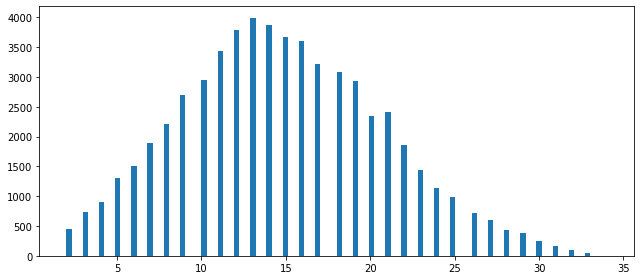

In [267]:
plt.hist(df_productwise['OrderQty'],bins=100)

(array([  33.,  120.,  318.,  282.,  827., 1064.,  554., 1092., 1293.,
         791., 1193., 1356.,  985., 1544., 1378.,  992., 1563., 1626.,
        1014., 1635., 1653., 1062., 1425., 1640., 1150., 1632., 1468.,
        1593., 1131., 1465., 1346.,  935., 1522., 1239.,  881., 1348.,
        1014.,  728., 1243., 1184.,  716.,  891.,  999.,  699.,  896.,
         773.,  460.,  776.,  702.,  438.,  616.,  558.,  486.,  263.,
         417.,  416.,  262.,  351.,  275.,  186.,  265.,  287.,  187.,
         281.,  140.,  114.,  174.,  147.,   84.,  144.,  153.,   86.,
          79.,   66.,   37.,   51.,   28.,   49.,   31.,   40.,   36.,
          13.,   31.,   16.,    0.,    8.,   20.,    8.,   12.,    0.,
           0.,    0.,    4.,    0.,    0.,    0.,    0.,    0.,    0.,
           4.]),
 array([  400.,   668.,   936.,  1204.,  1472.,  1740.,  2008.,  2276.,
         2544.,  2812.,  3080.,  3348.,  3616.,  3884.,  4152.,  4420.,
         4688.,  4956.,  5224.,  5492.,  5760.,  6028.,  6

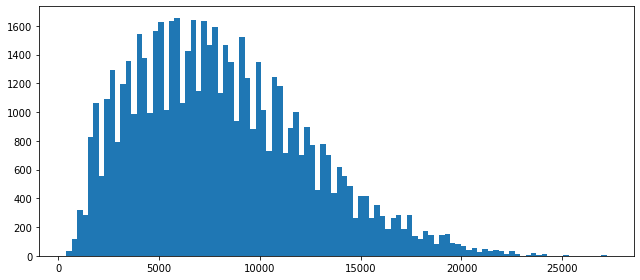

In [268]:
plt.hist(df_productwise['OrderTotal'],bins=100)

(array([ 1853.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,  9081.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
        18747.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0., 18260.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
         9363.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,  1790.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 

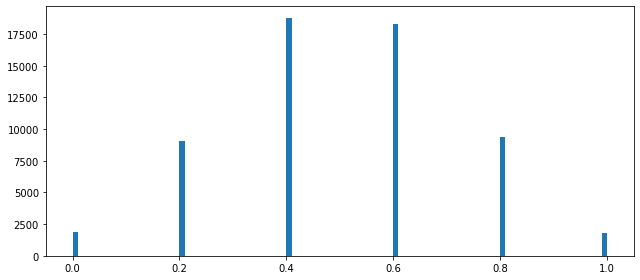

In [269]:
plt.hist(df_productwise['CliAvgSenti'],bins=100)

(array([ 2005.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,  9185.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
        18319.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0., 18352.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
         9457.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,  1776.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 

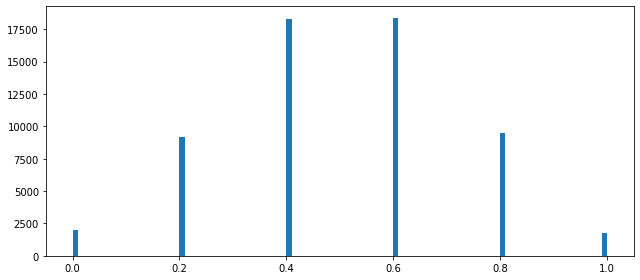

In [270]:
plt.hist(df_productwise['SpAvgSenti'],bins=100)

(array([4918., 2267., 3635., 2500., 2946., 3071., 2302., 1746., 5320.,
         370., 1375.,  795.,  649.,  971.,    0., 1155.,    0., 1841.,
         739.,  342.,    0., 1270.,  380.,  489.,  890.,    0., 1719.,
           0.,  695.,  298.,    0.,  792.,  955.,    0.,    0., 1694.,
           0.,  726.,    0.,  435.,  566.,    0.,    0.,  482., 1493.,
           0.,    0.,    0.,  504.,  366.,  632.,    0.,    0.,    0.,
         964.,    0.,  699.,  172.,    0.,  313.,    0.,    0.,    0.,
        1122.,    0.,  369.,    0.,    0.,    0.,  452.,    0.,    0.,
         887.,  176.,    0.,    0.,    0.,    0.,    0.,  183.,    0.,
         864.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,  181.,
         709.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
         675.]),
 array([  100.,   209.,   318.,   427.,   536.,   645.,   754.,   863.,
          972.,  1081.,  1190.,  1299.,  1408.,  1517.,  1626.,  1735.,
         1844.,  1953.,  2062.,  2171.,  2280.,  2389.,  2

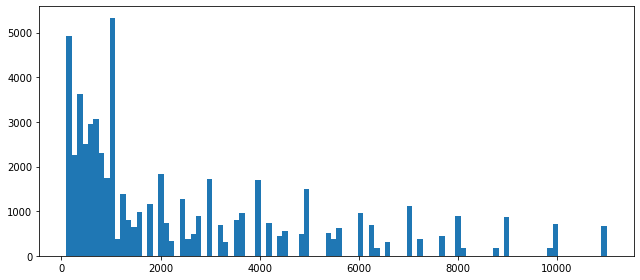

In [271]:
plt.hist(df_productwise['ProdPrice'],bins=100)

(array([8453.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0., 8691.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0., 8296.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0., 8439.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0., 8579.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0., 8320.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        8316.]),
 array([0.  , 0.06, 0.12, 0.18, 0.24, 0.3 , 0.36, 0.42, 0.48, 0.54, 0.6 ,
        0.66, 0.72, 0.78, 0.84, 0.9 , 0.96, 1.02, 1.08, 1.14, 1.2 , 1.26,
        1.32, 1.38, 1.44, 1.5 , 1.56, 1.62, 1.68, 1.74

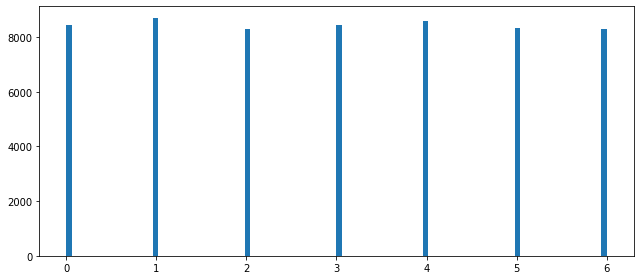

In [272]:
plt.hist(df_productwise['Day'],bins=100)

(array([1338.,    0.,    0.,    0.,  773.,    0.,    0.,    0.,  449.,
           0.,    0.,    0.,    0.,  280.,    0.,    0.,    0.,  224.,
           0.,    0.,    0.,  425.,    0.,    0.,    0.,    0.,  754.,
           0.,    0.,    0., 1381.,    0.,    0.,    0., 1835.,    0.,
           0.,    0.,    0., 2763.,    0.,    0.,    0., 3388.,    0.,
           0.,    0., 4037.,    0.,    0.,    0.,    0., 3853.,    0.,
           0.,    0., 3755.,    0.,    0.,    0., 3706.,    0.,    0.,
           0.,    0., 3243.,    0.,    0.,    0., 3199.,    0.,    0.,
           0., 3674.,    0.,    0.,    0.,    0., 3938.,    0.,    0.,
           0., 3904.,    0.,    0.,    0., 4016.,    0.,    0.,    0.,
           0., 3458.,    0.,    0.,    0., 2748.,    0.,    0.,    0.,
        1953.]),
 array([ 0.  ,  0.23,  0.46,  0.69,  0.92,  1.15,  1.38,  1.61,  1.84,
         2.07,  2.3 ,  2.53,  2.76,  2.99,  3.22,  3.45,  3.68,  3.91,
         4.14,  4.37,  4.6 ,  4.83,  5.06,  5.29,  5.52,  5.

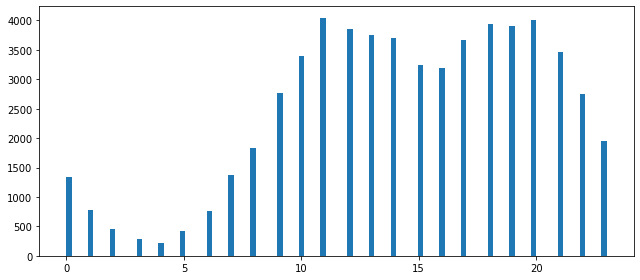

In [273]:
plt.hist(df_productwise['Hour'],bins=100)

(array([1048., 1039.,    0.,  891.,    0.,  990., 1054.,    0.,  936.,
           0.,  993.,  953.,    0.,  950.,    0.,  960.,  934.,    0.,
         974.,    0., 1032.,    0., 1075.,  945.,    0., 1048.,    0.,
        1006.,  976.,    0., 1000.,    0.,  964.,  977.,    0., 1050.,
           0., 1018.,  953.,    0.,  887.,    0., 1052.,    0.,  882.,
        1055.,    0.,  975.,    0.,  972., 1053.,    0.,  883.,    0.,
        1019.,  986.,    0.,  906.,    0.,  968.,    0.,  877.,  990.,
           0.,  918.,    0., 1000.,  961.,    0.,  948.,    0.,  962.,
        1052.,    0., 1021.,    0., 1000.,  971.,    0., 1048.,    0.,
         979.,    0., 1049.,  892.,    0., 1021.,    0.,  946.,  989.,
           0.,  960.,    0., 1071., 1033.,    0., 1026.,    0.,  929.,
        1047.]),
 array([ 0.  ,  0.59,  1.18,  1.77,  2.36,  2.95,  3.54,  4.13,  4.72,
         5.31,  5.9 ,  6.49,  7.08,  7.67,  8.26,  8.85,  9.44, 10.03,
        10.62, 11.21, 11.8 , 12.39, 12.98, 13.57, 14.16, 14.

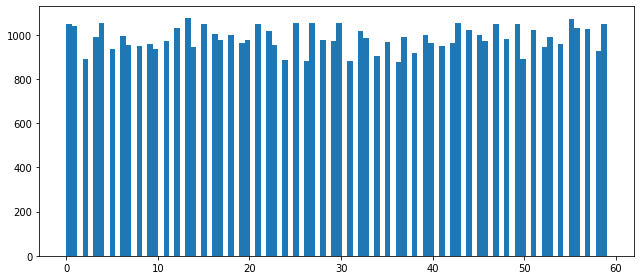

In [274]:
plt.hist(df_productwise['Minute'],bins=100)

(array([57068.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,  2026.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 

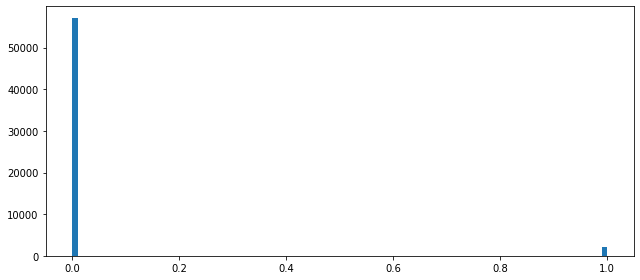

In [275]:
plt.hist(df_productwise['CliSenti'],bins=100)

(array([56842.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,  2252.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 

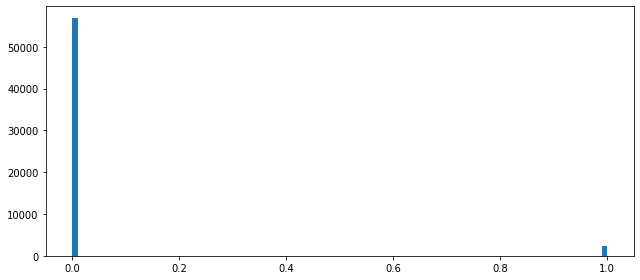

In [276]:
plt.hist(df_productwise['SpSenti'],bins=100)

(array([ 8451.,  1713.,  1102.,   844.,   703.,   625.,   458.,   466.,
          409.,   396.,   358.,   380.,   325.,   316.,   309.,   269.,
          251.,   286.,   200.,   218.,   210.,   170.,   201.,   218.,
          261.,   228.,   196.,   193.,   227.,   179.,   206.,   191.,
          153.,   202.,   182.,   182.,   157.,   150.,   153.,   167.,
          152.,   174.,   194.,   179.,   124.,   150.,   161.,   173.,
          163.,   158.,   174.,   160.,   153.,   183.,   210.,   149.,
          130.,   166.,   154.,   184.,   176.,   180.,   171.,   222.,
          211.,   188.,   181.,   149.,   179.,   192.,   246.,   248.,
          269.,   217.,   202.,   212.,   240.,   228.,   251.,   276.,
          315.,   256.,   314.,   312.,   349.,   365.,   375.,   402.,
          516.,   506.,   453.,   556.,   592.,   645.,   750.,  1024.,
         1149.,  1791.,  2815., 16175.]),
 array([2.13153971e-13, 1.00000000e-02, 2.00000000e-02, 3.00000000e-02,
        4.00000000e-02

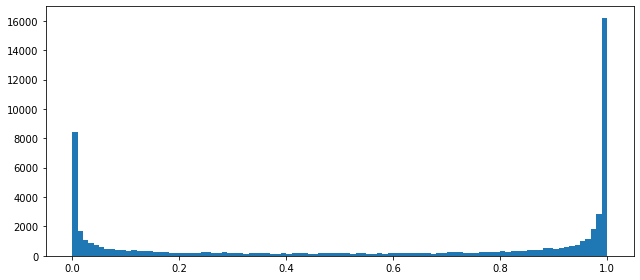

In [277]:
plt.hist(df_productwise['ann_cli_senti'],bins=100)

(array([ 8739.,  1643.,  1083.,   776.,   629.,   495.,   481.,   485.,
          460.,   389.,   313.,   397.,   312.,   304.,   333.,   301.,
          291.,   247.,   271.,   247.,   229.,   226.,   186.,   220.,
          256.,   214.,   200.,   221.,   203.,   158.,   184.,   164.,
          162.,   220.,   189.,   115.,   169.,   154.,   177.,   176.,
          157.,   169.,   189.,   153.,   171.,   183.,   177.,   160.,
          230.,   160.,   156.,   185.,   149.,   180.,   169.,   161.,
          171.,   137.,   150.,   188.,   191.,   200.,   190.,   172.,
          196.,   190.,   150.,   181.,   205.,   206.,   160.,   225.,
          293.,   209.,   252.,   237.,   223.,   323.,   243.,   245.,
          196.,   267.,   299.,   324.,   298.,   360.,   405.,   434.,
          435.,   438.,   512.,   555.,   591.,   673.,   822.,  1080.,
         1149.,  1624.,  2565., 16362.]),
 array([4.64046423e-12, 1.00000000e-02, 2.00000000e-02, 3.00000000e-02,
        4.00000000e-02

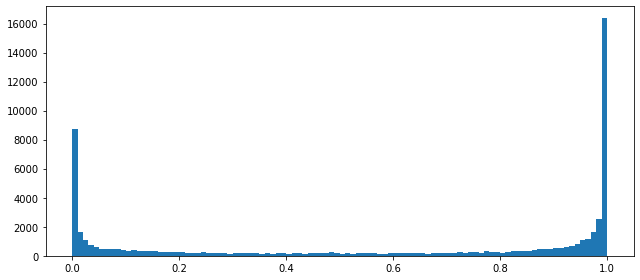

In [278]:
plt.hist(df_productwise['ann_sp_senti'],bins=100)

(array([1542., 1343., 1210., 1015.,  951.,  822.,  713.,  735.,  607.,
         595.,  584.,  545.,  515.,  491.,  518.,  434.,  408.,  492.,
         461.,  433.,  321.,  361.,  403.,  426.,  395.,  365.,  395.,
         384.,  349.,  366.,  389.,  371.,  344.,  381.,  376.,  307.,
         397.,  364.,  385.,  377.,  355.,  395.,  346.,  314.,  429.,
         372.,  430.,  405.,  457.,  383.,  366.,  358.,  400.,  408.,
         356.,  477.,  461.,  365.,  448.,  396.,  373.,  422.,  447.,
         474.,  468.,  495.,  471.,  495.,  418.,  508.,  464.,  558.,
         544.,  455.,  510.,  533.,  602.,  636.,  554.,  519.,  622.,
         683.,  564.,  708.,  668.,  703.,  825.,  774.,  904.,  964.,
         887.,  945., 1076., 1167., 1189., 1206., 1336., 1569., 1534.,
        1033.]),
 array([0.00164412, 0.0116055 , 0.02156688, 0.03152826, 0.04148963,
        0.05145101, 0.06141239, 0.07137377, 0.08133515, 0.09129652,
        0.1012579 , 0.11121928, 0.12118066, 0.13114204, 0.14110342

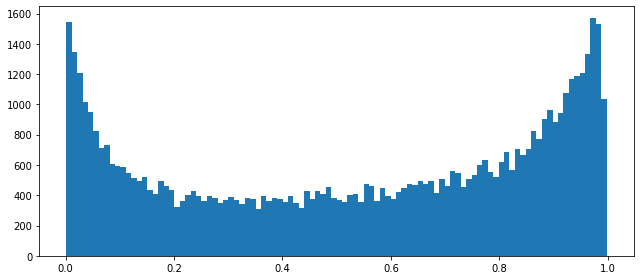

In [279]:
plt.hist(df_productwise['gru_cli_senti'],bins=100)

(array([1614., 1406., 1215., 1008.,  942.,  801.,  735.,  602.,  723.,
         595.,  525.,  579.,  542.,  492.,  471.,  509.,  485.,  500.,
         395.,  487.,  458.,  436.,  474.,  414.,  389.,  327.,  427.,
         343.,  399.,  416.,  364.,  368.,  393.,  320.,  422.,  330.,
         383.,  429.,  379.,  393.,  359.,  339.,  299.,  385.,  404.,
         368.,  444.,  316.,  395.,  385.,  383.,  427.,  353.,  465.,
         453.,  317.,  366.,  404.,  452.,  372.,  454.,  360.,  389.,
         436.,  484.,  390.,  375.,  426.,  425.,  502.,  461.,  518.,
         507.,  521.,  549.,  550.,  522.,  545.,  539.,  671.,  625.,
         648.,  686.,  614.,  758.,  833.,  738.,  883.,  877.,  850.,
         949.,  909., 1043., 1079., 1159., 1336., 1272., 1463., 1570.,
        1002.]),
 array([0.00164829, 0.01160738, 0.02156647, 0.03152556, 0.04148466,
        0.05144375, 0.06140284, 0.07136193, 0.08132102, 0.09128011,
        0.1012392 , 0.11119829, 0.12115738, 0.13111648, 0.14107557

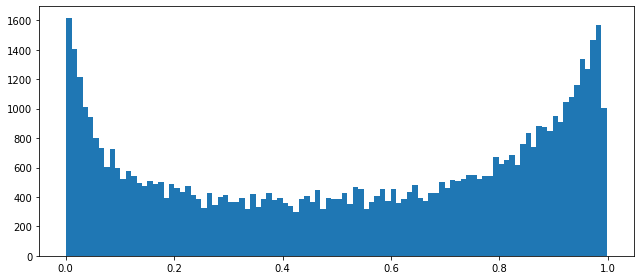

In [280]:
plt.hist(df_productwise['gru_sp_senti'],bins=100)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='MonthNum', ylabel='Density'>

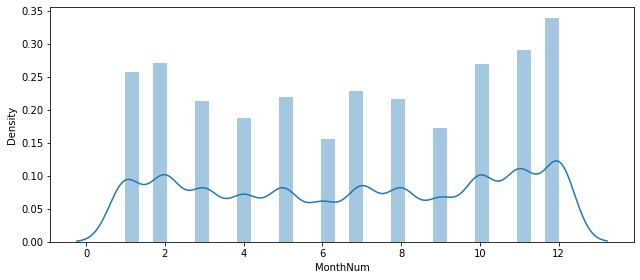

In [281]:
sns.distplot(df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='OrderQty', ylabel='Density'>

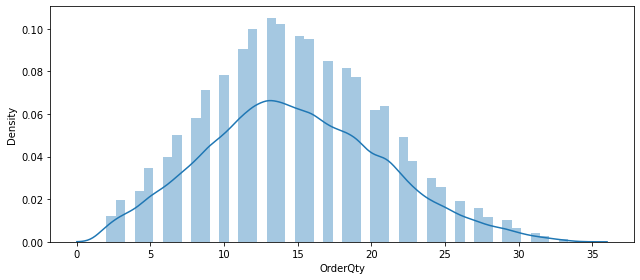

In [282]:
sns.distplot(df_productwise['OrderQty'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='OrderTotal', ylabel='Density'>

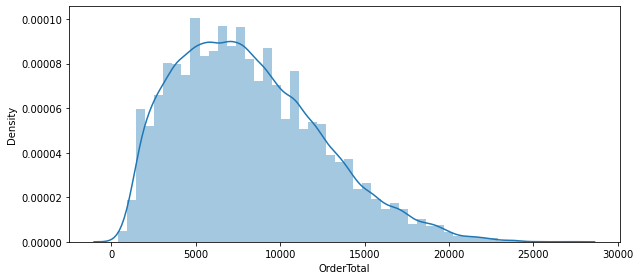

In [283]:
sns.distplot(df_productwise['OrderTotal'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='CliAvgSenti', ylabel='Density'>

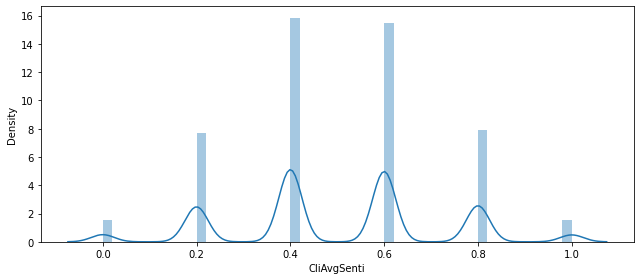

In [284]:
sns.distplot(df_productwise['CliAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='SpAvgSenti', ylabel='Density'>

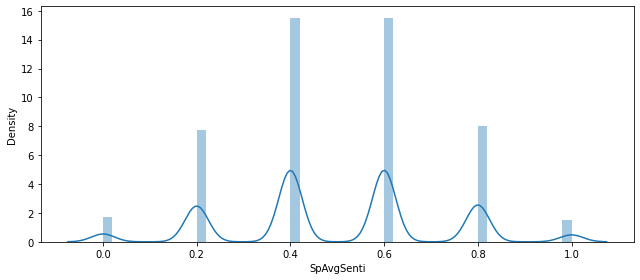

In [285]:
sns.distplot(df_productwise['SpAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='ProdPrice', ylabel='Density'>

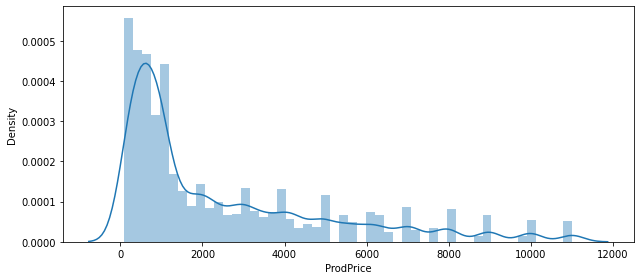

In [286]:
sns.distplot(df_productwise['ProdPrice'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Hour', ylabel='Density'>

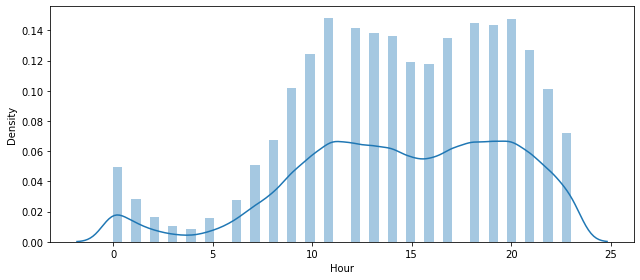

In [287]:
sns.distplot(df_productwise['Hour'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Minute', ylabel='Density'>

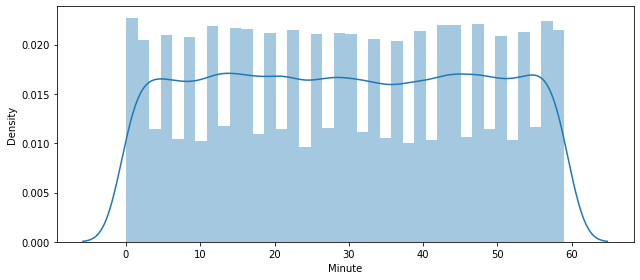

In [288]:
sns.distplot(df_productwise['Minute'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Day', ylabel='Density'>

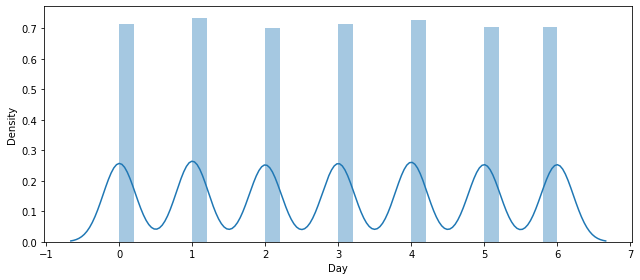

In [289]:
sns.distplot(df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='CliSenti', ylabel='Density'>

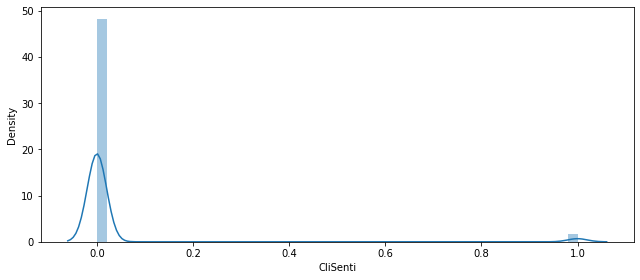

In [290]:
sns.distplot(df_productwise['CliSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='SpSenti', ylabel='Density'>

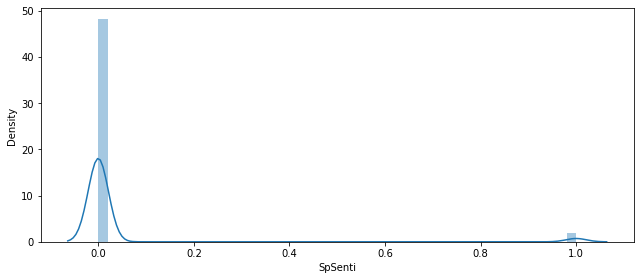

In [291]:
sns.distplot(df_productwise['SpSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='ann_cli_senti', ylabel='Density'>

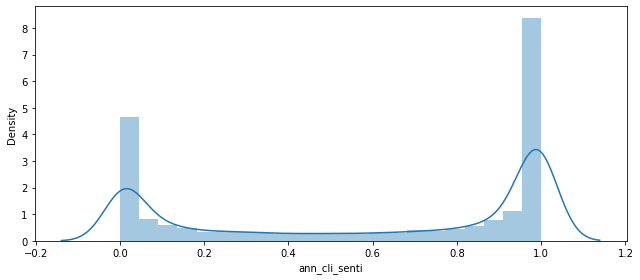

In [292]:
sns.distplot(df_productwise['ann_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='ann_sp_senti', ylabel='Density'>

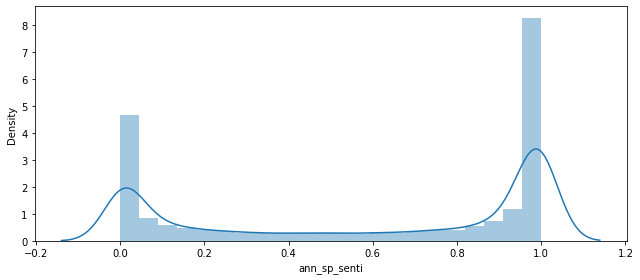

In [293]:
sns.distplot(df_productwise['ann_sp_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='gru_cli_senti', ylabel='Density'>

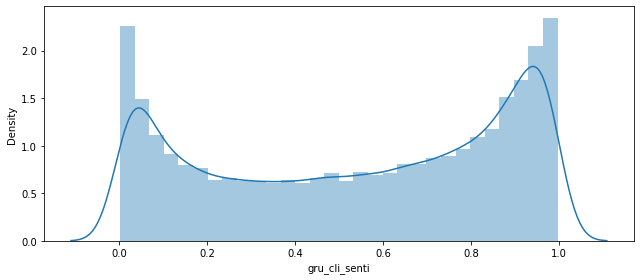

In [294]:
sns.distplot(df_productwise['gru_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='gru_sp_senti', ylabel='Density'>

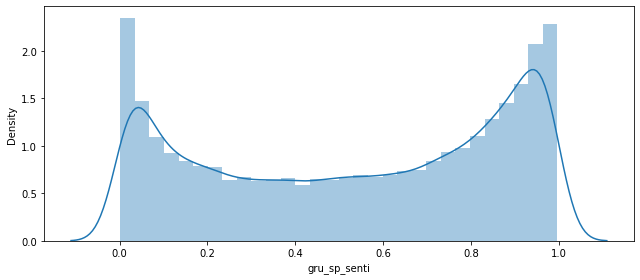

In [295]:
sns.distplot(df_productwise['gru_sp_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='MonthNum'>

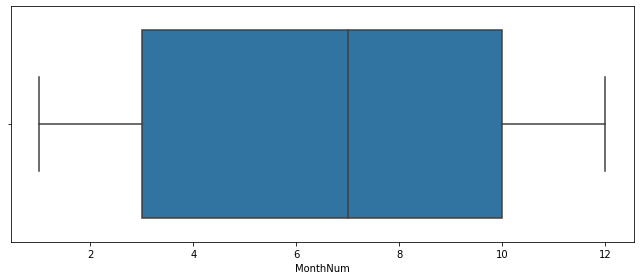

In [296]:
sns.boxplot(df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='OrderQty'>

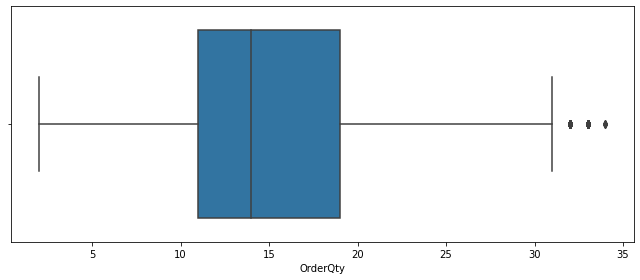

In [297]:
sns.boxplot(df_productwise['OrderQty'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='OrderTotal'>

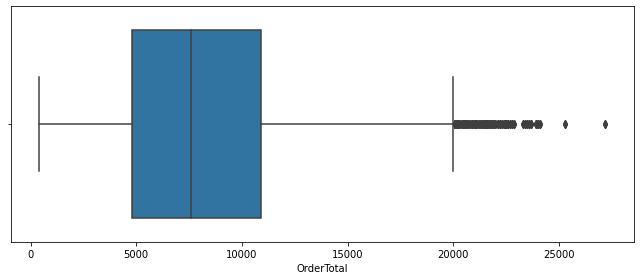

In [298]:
sns.boxplot(df_productwise['OrderTotal'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='CliAvgSenti'>

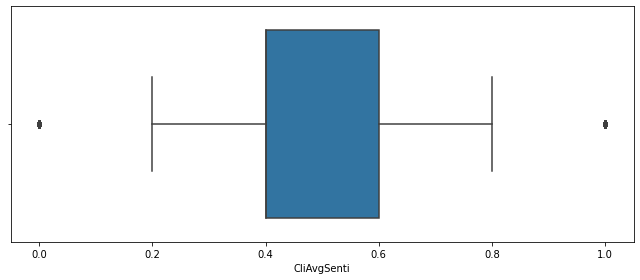

In [299]:
sns.boxplot(df_productwise['CliAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='SpAvgSenti'>

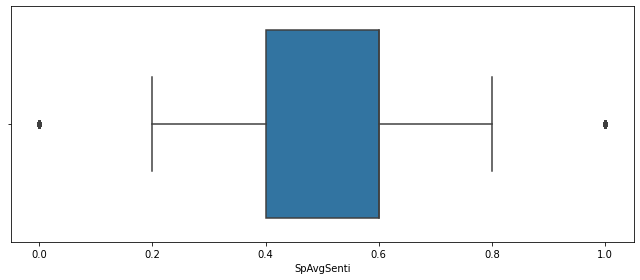

In [300]:
sns.boxplot(df_productwise['SpAvgSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice'>

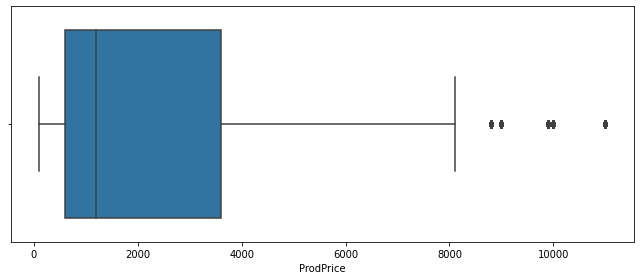

In [301]:
sns.boxplot(df_productwise['ProdPrice'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Hour'>

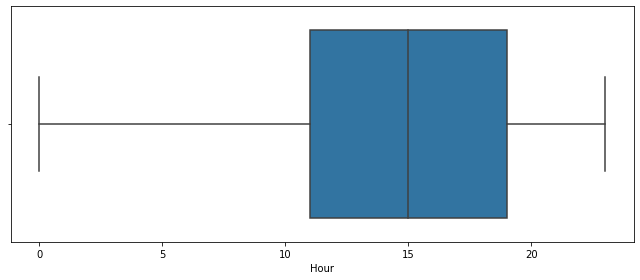

In [302]:
sns.boxplot(df_productwise['Hour'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Minute'>

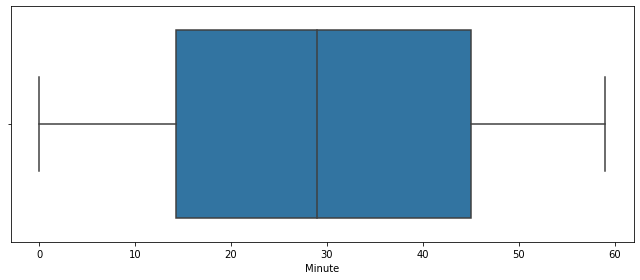

In [303]:
sns.boxplot(df_productwise['Minute'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Day'>

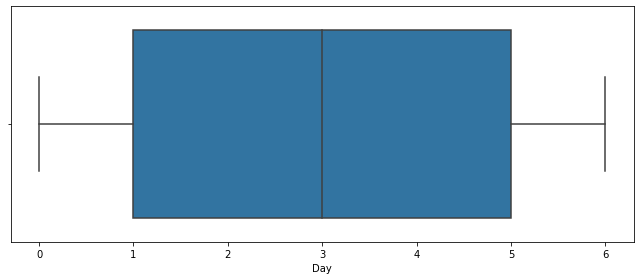

In [304]:
sns.boxplot(df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='CliSenti'>

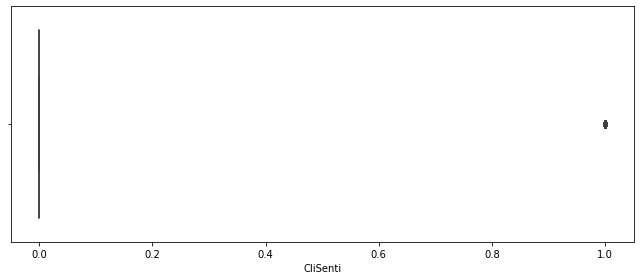

In [305]:
sns.boxplot(df_productwise['CliSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='SpSenti'>

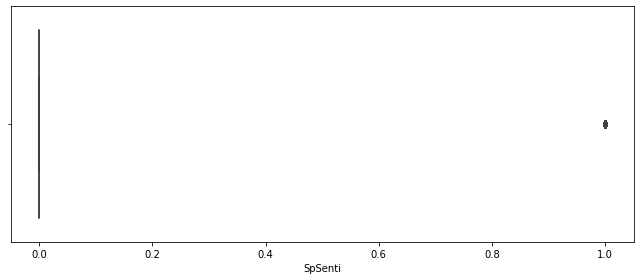

In [306]:
sns.boxplot(df_productwise['SpSenti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ann_cli_senti'>

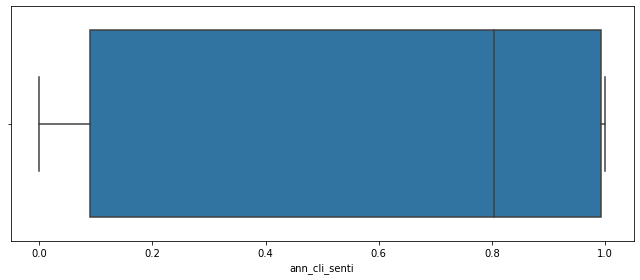

In [307]:
sns.boxplot(df_productwise['ann_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ann_sp_senti'>

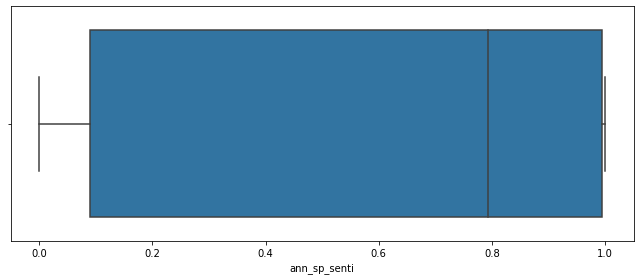

In [308]:
sns.boxplot(df_productwise['ann_sp_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='gru_cli_senti'>

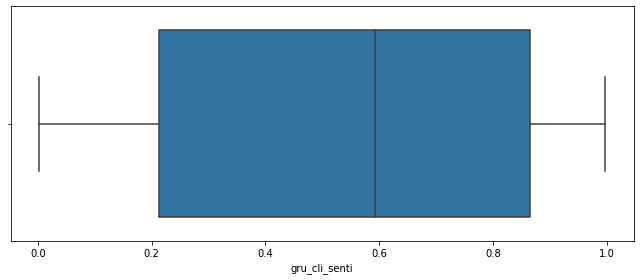

In [309]:
sns.boxplot(df_productwise['gru_cli_senti'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='gru_sp_senti'>

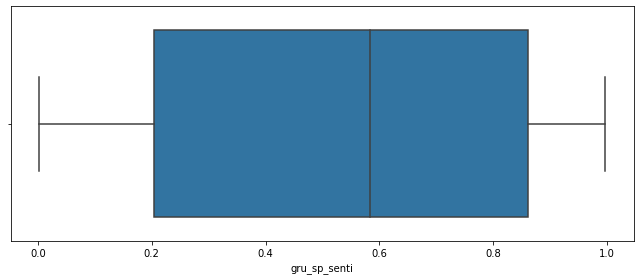

In [310]:
sns.boxplot(df_productwise['gru_sp_senti'])

In [312]:
#corr with the target column
df_productwise.corr()

,Unnamed: 0,MonthNum,OrderID,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
Unnamed: 0,1.000000,-0.410060,-0.405015,-0.000287,-0.004562,0.021202,0.003097,-0.002647,0.002930,-0.009755,0.031692,0.004925,0.000737,0.025790,0.005337,0.004790,0.005567
MonthNum,-0.410060,1.000000,0.993808,0.003492,0.007041,-0.009572,-0.015860,0.003818,-0.009726,-0.002125,-0.003232,-0.004305,0.000983,-0.005618,-0.014825,-0.003767,-0.017450
OrderID,-0.405015,0.993808,1.000000,0.004616,0.008831,-0.009790,-0.014356,0.004676,-0.009682,-0.002332,-0.002492,-0.003850,0.002390,-0.006725,-0.012715,-0.004108,-0.016628
OrderQty,-0.000287,0.003492,0.004616,1.000000,0.701838,-0.001537,-0.002474,0.235866,-0.007323,-0.015912,-0.005597,-0.005954,0.005955,-0.003761,-0.003756,-0.001067,0.001654
OrderTotal,-0.004562,0.007041,0.008831,0.701838,1.000000,-0.004980,-0.007702,0.437902,-0.005482,-0.010302,-0.002666,-0.002746,0.010229,-0.009061,-0.008855,-0.007188,0.005505
CliAvgSenti,0.021202,-0.009572,-0.009790,-0.001537,-0.004980,1.000000,0.001802,-0.001273,0.007231,0.004428,0.003557,0.209801,-0.001572,0.552213,-0.008258,0.307501,0.002357
SpAvgSenti,0.003097,-0.015860,-0.014356,-0.002474,-0.007702,0.001802,1.000000,-0.003455,-0.004904,0.008792,0.009210,0.008854,0.214051,-0.004177,0.562027,0.010238,0.322865
ProdPrice,-0.002647,0.003818,0.004676,0.235866,0.437902,-0.001273,-0.003455,1.000000,-0.002022,-0.004509,-0.000801,0.001477,0.004334,-0.005679,-0.004051,-0.006337,0.002301
Hour,0.002930,-0.009726,-0.009682,-0.007323,-0.005482,0.007231,-0.004904,-0.002022,1.000000,-0.014223,0.024788,0.019883,-0.001495,0.007455,-0.006352,0.010659,-0.003034
Minute,-0.009755,-0.002125,-0.002332,-0.015912,-0.010302,0.004428,0.008792,-0.004509,-0.014223,1.000000,0.003660,0.001825,0.007517,0.007874,0.008353,0.010374,0.002509


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

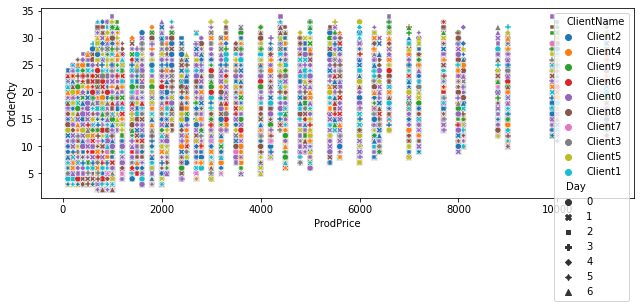

In [313]:
import pandas as pd 
import seaborn as sns
sns.scatterplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['ClientName'],style=df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

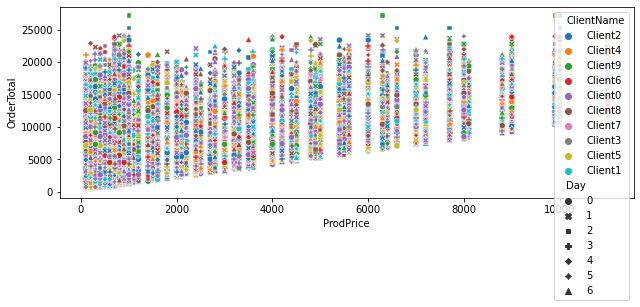

In [319]:
sns.scatterplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['ClientName'],style=df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

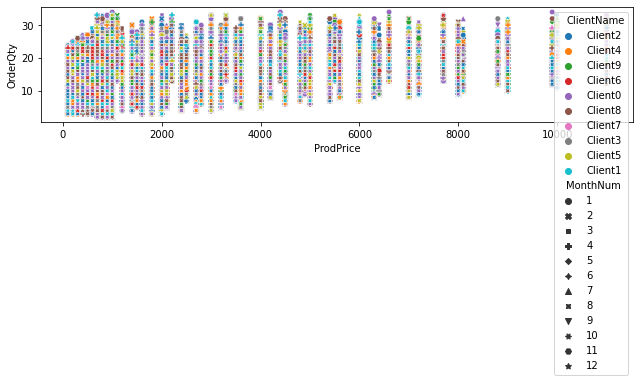

In [314]:
sns.scatterplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['ClientName'],style=df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

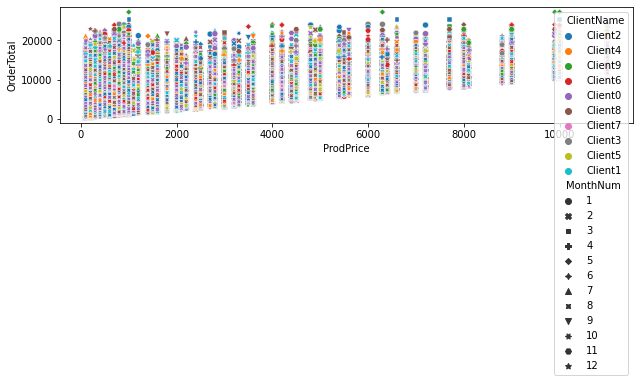

In [320]:
sns.scatterplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['ClientName'],style=df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

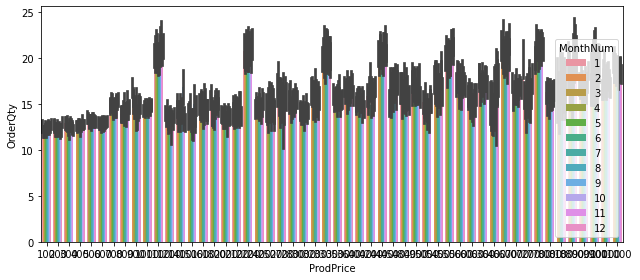

In [316]:
sns.barplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

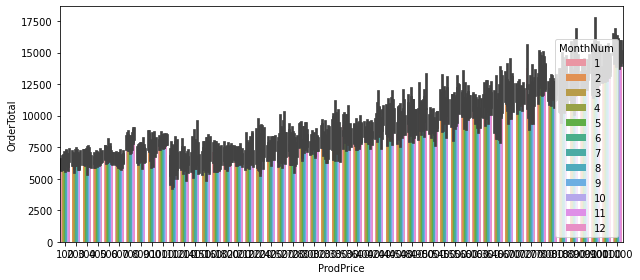

In [321]:
sns.barplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

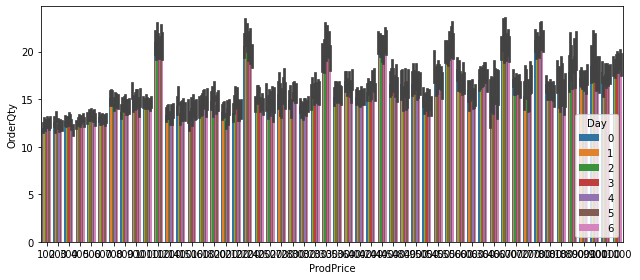

In [317]:
sns.barplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

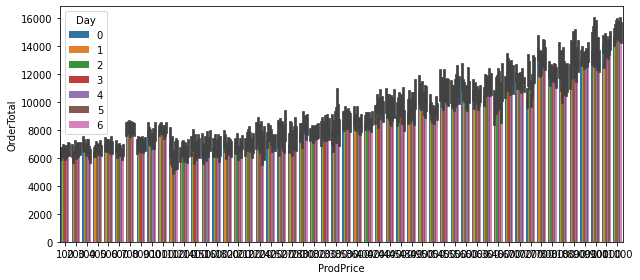

In [322]:
sns.barplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

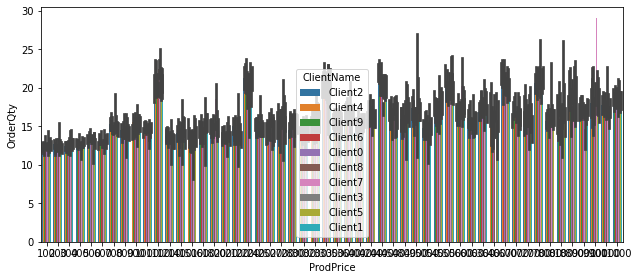

In [318]:
sns.barplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['ClientName'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

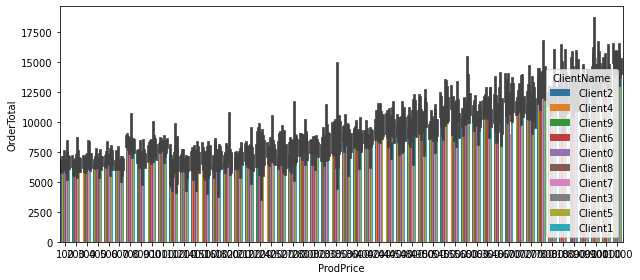

In [323]:
sns.barplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['ClientName'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

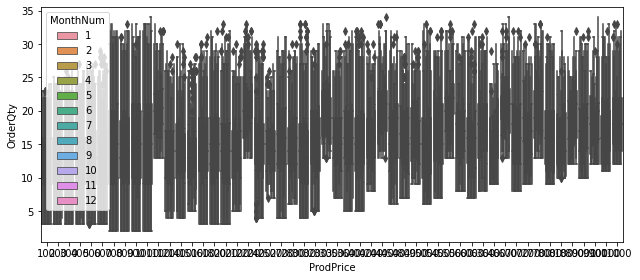

In [324]:
sns.boxplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

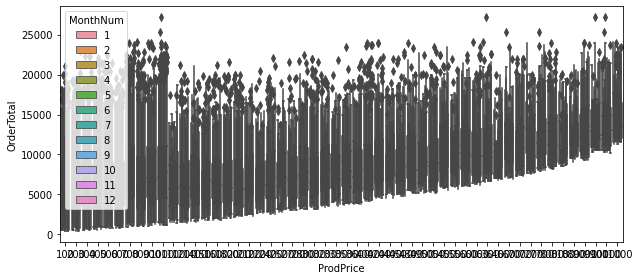

In [325]:
sns.boxplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

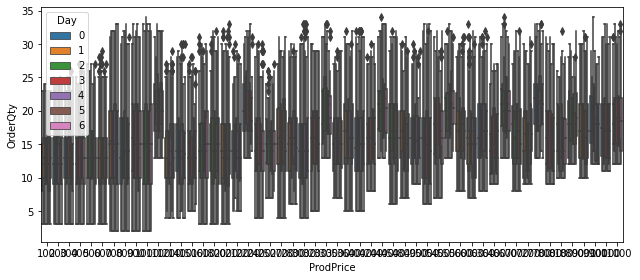

In [326]:
sns.boxplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

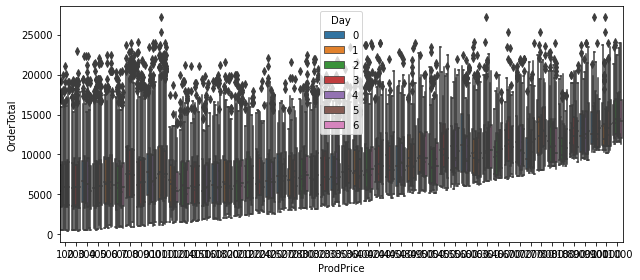

In [327]:
sns.boxplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderQty'>

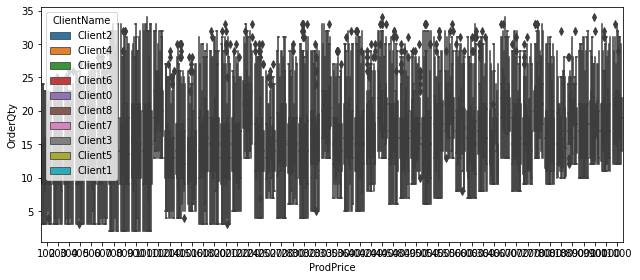

In [328]:
sns.boxplot(df_productwise['ProdPrice'],df_productwise['OrderQty'],hue=df_productwise['ClientName'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='ProdPrice', ylabel='OrderTotal'>

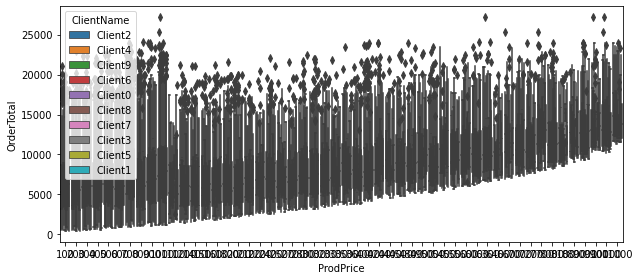

In [329]:
sns.boxplot(df_productwise['ProdPrice'],df_productwise['OrderTotal'],hue=df_productwise['ClientName'])

In [7]:
print(df_productwise.shape)
df_productwise.head(2)

(59094, 19)


,Unnamed: 0,ProdName,ClientName,MonthNum,OrderID,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
0,0,prod4,Client2,12,17393,22,14900,0.4,1.0,800,8,30,4,0,0,0.94666,0.999832,0.275266,0.981894
1,1,prod12,Client2,12,17393,22,14900,0.4,1.0,1600,8,30,4,0,0,0.94666,0.999832,0.275266,0.981894


In [8]:
df_productwise.drop(['Unnamed: 0','OrderID'],axis = 1)

,ProdName,ClientName,MonthNum,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
0,prod4,Client2,12,22,14900,0.4,1.0,800,8,30,4,0,0,0.946660,0.999832,0.275266,0.981894
1,prod12,Client2,12,22,14900,0.4,1.0,1600,8,30,4,0,0,0.946660,0.999832,0.275266,0.981894
2,prod2,Client2,12,22,14900,0.4,1.0,3500,8,30,4,0,0,0.946660,0.999832,0.275266,0.981894
3,prod5,Client2,12,22,14900,0.4,1.0,9000,8,30,4,0,0,0.946660,0.999832,0.275266,0.981894
4,prod14,Client4,12,6,4100,0.8,0.4,100,17,28,3,0,0,0.999965,0.847323,0.905130,0.124290
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59089,prod9,Client2,8,9,3600,0.4,0.8,400,14,6,2,0,0,0.998334,0.994881,0.537054,0.710571
59090,prod15,Client0,8,22,11500,0.4,1.0,1000,20,53,1,0,0,0.173602,0.999965,0.867306,0.767158
59091,prod2,Client0,8,22,11500,0.4,1.0,4500,20,53,1,0,0,0.173602,0.999965,0.867306,0.767158
59092,prod7,Client0,8,22,11500,0.4,1.0,3200,20,53,1,0,0,0.173602,0.999965,0.867306,0.767158


In [9]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_productwise.ClientName = le.fit_transform(df_productwise.ClientName)
df_productwise.ProdName = le.fit_transform(df_productwise.ProdName)

In [343]:
X = df_productwise[['ProdName','ClientName','MonthNum','OrderQty','OrderTotal','CliAvgSenti','SpAvgSenti','Hour','Minute','Day','CliSenti','SpSenti','ann_cli_senti','ann_sp_senti','gru_cli_senti','gru_sp_senti']]
y = df_productwise[['ProdPrice']]

In [344]:
y

,ProdPrice
0,800
1,1600
2,3500
3,9000
4,100
...,...
59089,400
59090,1000
59091,4500
59092,3200


In [345]:
from sklearn.model_selection import train_test_split
X_train,X_test, y_train,y_test = train_test_split(X,y,test_size = 0.2,random_state = 42)

In [346]:
X_train

,ProdName,ClientName,MonthNum,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
15856,3,1,7,9,6300,0.6,0.6,8,51,6,0,0,0.991376,0.451080,0.909285,0.526833
1131,3,1,12,13,11200,0.4,0.4,5,21,1,0,0,0.000393,0.991901,0.769170,0.107070
14399,14,2,7,13,4900,1.0,0.8,18,29,4,0,0,0.999838,0.999915,0.940389,0.307318
54993,8,0,8,12,5600,0.6,0.4,21,49,4,0,0,0.993181,0.001707,0.160087,0.099259
49256,0,5,11,26,16900,0.8,0.4,13,15,4,0,0,0.999592,0.000190,0.044511,0.258677
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54343,5,0,4,12,1500,0.6,1.0,12,10,3,0,0,0.849629,0.979240,0.573646,0.715420
38158,2,1,3,15,12300,0.4,0.4,20,56,5,0,0,0.183577,0.995189,0.014391,0.706532
860,3,6,12,15,6900,0.8,0.8,17,22,5,0,0,0.991174,0.997483,0.889865,0.950587
15795,3,0,7,21,7200,0.8,0.2,13,31,2,0,0,0.999466,0.049699,0.986098,0.657129


## [Predicting Sale]

## Multiple Linear Regression

In [348]:
import pandas as pd
import numpy as np

import plotly.express as px
import plotly.graph_objects as go

from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [349]:
from sklearn.linear_model import LinearRegression
mlr = LinearRegression()
mlr.fit(X_train,y_train)
y_pred = mlr.predict(X_test)


print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 1808.2994110953164
MSE 5378790.71529867
RMSE 2319.222006470849
R2Score 0.2154977592571159


## SGD

In [350]:
from sklearn.linear_model import SGDRegressor
reg = SGDRegressor(max_iter=100,learning_rate='constant',eta0=0.01)
reg.fit(X_train,y_train)
y_pred = reg.predict(X_test)

print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))


MAE 8.530224428568782e+17
MSE 9.31196267491619e+35
RMSE 9.64985112575121e+17
R2Score -1.358159476889074e+29


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


## Mini Batch GD

In [351]:
import random
sgd = SGDRegressor(learning_rate='constant',eta0=0.25)
batch_size = 35 

for i in range(100):
    idx = random.sample(range(X_train.shape[0]),batch_size)
    sgd.partial_fit(X_train.iloc[idx],y_train.iloc[idx])
y_pred = sgd.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 2.7844476592021496e+19
MSE 9.918826734349692e+38
RMSE 3.1494168879889007e+19
R2Score -1.4466712334624974e+32


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed w

## Polynomial Regression

In [352]:
from sklearn.preprocessing import PolynomialFeatures,StandardScaler
from sklearn.pipeline import Pipeline

poly = PolynomialFeatures(degree=2,include_bias=True) # bias is b0
X_train_trans = poly.fit_transform(X_train)
X_test_trans = poly.transform(X_test)

lr = LinearRegression()
lr.fit(X_train_trans,y_train)
y_pred = lr.predict(X_test_trans)


print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 1803.823782494155
MSE 5354329.791511436
RMSE 2313.9424780040313
R2Score 0.21906541052622863


## Ridge Regression

In [353]:
from sklearn.linear_model import Ridge
R = Ridge(alpha = 0.0001)
R.fit(X_train,y_train)
y_pred1 = R.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 1808.2994110809705
MSE 5378790.715220819
RMSE 2319.222006454065
R2Score 0.2154977592684707


## Lasso Regression

In [354]:
from sklearn.linear_model import Lasso 
L = Lasso(alpha = 0.0001)
L.fit(X_train,y_train)
y_pred1 = L.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 1808.2993906325448
MSE 5378790.618480827
RMSE 2319.2219855979347
R2Score 0.2154977733780996


## ElasticNet Regression

In [355]:
from sklearn.linear_model import ElasticNet
EL = ElasticNet(alpha = 0.005, l1_ratio = 0.50)
EL.fit(X_train,y_train)
y_pred1 = EL.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 1808.2829894017905
MSE 5378703.136559289
RMSE 2319.2031253340638
R2Score 0.21551053270767828


## Logistic Regression

In [356]:
from sklearn.linear_model import LogisticRegression
lor = LogisticRegression()
lor.fit(X_train,y_train)
y_pred1 = lor.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


MAE 1963.0256366866909
MSE 9541925.712835265
RMSE 3089.0007628414833
R2Score -0.3916998260278559


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


## Decision Tree Regression

In [357]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
rt = DecisionTreeRegressor(criterion = 'squared_error', max_depth = 5)
rt.fit(X_train,y_train)
y_pred1 = rt.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 1598.544571643433
MSE 4351733.098310196
RMSE 2086.0807986054124
R2Score 0.3652951848397481


In [358]:
#hyperparam tuning 
param_grid = {
    'max_depth':[2,4,5,8,10,12,14,None],
    'criterion':['squared_error','absolute_error'],
    'max_features':[0.25,0.5,0.75,1.0],
    'min_samples_split':[0.25,0.5,0.75,1.0]
}
reg = RandomizedSearchCV(estimator=DecisionTreeRegressor(),param_distributions=param_grid,cv=5,verbose=2,n_jobs=-1)
reg.fit(X_train,y_train)

print(reg.best_score_)
print(reg.best_params_)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0.21878985520305633
{'min_samples_split': 0.25, 'max_features': 0.75, 'max_depth': 8, 'criterion': 'squared_error'}


In [359]:
#feature importance 
for importance,name in sorted(zip(rt.feature_importances_,X_train.columns),reverse=True):
    print(name,importance)


ProdName 0.4789576375125862
OrderTotal 0.478854268902677
OrderQty 0.0421880935847367
gru_sp_senti 0.0
gru_cli_senti 0.0
ann_sp_senti 0.0
ann_cli_senti 0.0
SpSenti 0.0
SpAvgSenti 0.0
MonthNum 0.0
Minute 0.0
Hour 0.0
Day 0.0
ClientName 0.0
CliSenti 0.0
CliAvgSenti 0.0


## Voting Regressor

In [360]:
from sklearn.model_selection import cross_val_score
estimators = [('mlr',mlr),('poly',lr),('R',R),('L',L),('EL',EL),('rt',rt)]
for estimator in estimators :
    scores = cross_val_score(estimator[1],X,y,scoring='r2',cv=10)
    print(estimator[0],np.round(np.mean(scores),2))


from sklearn.ensemble import VotingRegressor
vr = VotingRegressor(estimators)
scores = cross_val_score(vr,X,y,scoring='r2',cv=10)
print('voting regressor',np.round(np.mean(scores),2))

mlr 0.21
poly 0.21
R 0.21
L 0.21
EL 0.21
rt 0.37


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when 

voting regressor 0.26


## Bagging Regressor

In [361]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import BaggingRegressor
bag_regressor = BaggingRegressor(random_state = 1)
bag_regressor.fit(X_train,y_train)

y_pred1 = bag_regressor.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)


MAE 1443.4667017863358
MSE 4330116.9643583475
RMSE 2080.893309220429
R2Score 0.3684479205416952


In [362]:
params = {'base_estimator':[None,mlr,lr,L,R,EL,rt],
             'n_estimators':[20,50,100],
          'max_samples':[0.5,1.0],
          'max_features':[0.5,1.0],
          'bootstrap':[True,False],
          'bootstrap_features':[True,False]
         }

In [364]:
from sklearn.model_selection import RandomizedSearchCV
bagging_regressor_grid = RandomizedSearchCV(BaggingRegressor(random_state=1,n_jobs=-1), params,cv=3,n_jobs=-1,verbose=-1)
bagging_regressor_grid.fit(X_train,y_train)



/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.346e+10, tolerance: 2.139e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.047e+10, tolerance: 2.119e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.537e+10, tolerance: 2.143e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.214e+09, tolerance: 2.108e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

RandomizedSearchCV(cv=3, estimator=BaggingRegressor(n_jobs=-1, random_state=1),
                   n_jobs=-1,
                   param_distributions={'base_estimator': [None,
                                                           LinearRegression(),
                                                           LinearRegression(),
                                                           Lasso(alpha=0.0001),
                                                           Ridge(alpha=0.0001),
                                                           ElasticNet(alpha=0.005),
                                                           DecisionTreeRegressor(max_depth=5)],
                                        'bootstrap': [True, False],
                                        'bootstrap_features': [True, False],
                                        'max_features': [0.5, 1.0],
                                        'max_samples': [0.5, 1.0],
                                        'n_estimators': [20, 50, 100]},
                   verbose=-1)

In [365]:
# bagging_regressor_grid = GridSearchCV(BaggingRegressor(random_state=1,n_jobs=-1),param_grid = params,cv=3,n_jobs=-1,verbose=-1)
# bagging_regressor_grid.fit(X_train,y_train)

print('train r2',bagging_regressor_grid.best_estimator_.score(X_train,y_train))
print('test r2',bagging_regressor_grid.best_estimator_.score(X_test,y_test))
print('best r2 score through grid search ',bagging_regressor_grid.best_score_)
print('best parameters',bagging_regressor_grid.best_params_)

train r2 0.3906234055873701
test r2 0.39266474767486936
best r2 score through grid search  0.384512685211199
best parameters {'n_estimators': 100, 'max_samples': 0.5, 'max_features': 1.0, 'bootstrap_features': False, 'bootstrap': False, 'base_estimator': DecisionTreeRegressor(max_depth=5)}


## Random Forest Regressor

In [366]:
from sklearn.ensemble import RandomForestRegressor
raf = RandomForestRegressor(n_estimators=500).fit(X_train,y_train)
y_pred1 = raf.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))


/tmp/ipykernel_4275/1576491021.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  raf = RandomForestRegressor(n_estimators=500).fit(X_train,y_train)


MAE 1413.1962960970834
MSE 4025692.360267826
RMSE 2006.4128090370202
R2Score 0.412848566836969


In [367]:
rf=RandomForestRegressor(oob_score = True)
rf.fit(X_train,y_train)
rf.oob_score_

/tmp/ipykernel_4275/1321434785.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X_train,y_train)


0.40344179264583857

## XGBoost Regressor

In [368]:
from xgboost import XGBRegressor

model = XGBRegressor(random_state=42, n_jobs=-1, n_estimators=20, max_depth=4)
model.fit(X_train, y_train)

y_pred1 = model.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))



MAE 1484.0052595943835
MSE 3830246.2705910676
RMSE 1957.1014972635087
R2Score 0.4413545830423862


In [369]:
#feature importance 
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

importance_df.head(10)

,feature,importance
4,OrderTotal,0.511403
0,ProdName,0.334010
3,OrderQty,0.082207
14,gru_cli_senti,0.021804
13,ann_sp_senti,0.021089
11,SpSenti,0.011541
8,Minute,0.009274
1,ClientName,0.008313
15,gru_sp_senti,0.000359
2,MonthNum,0.000000


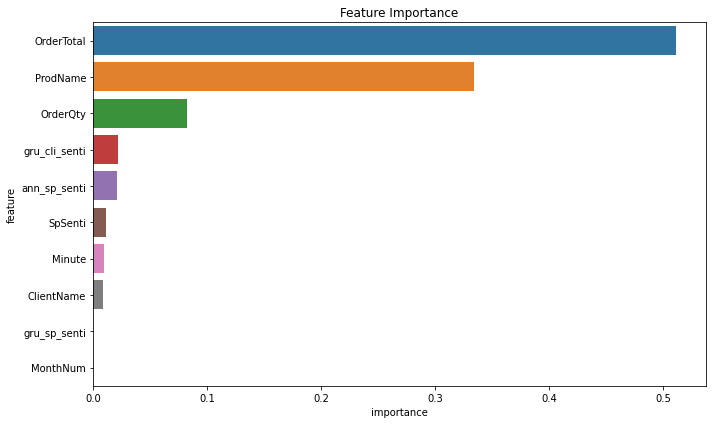

In [370]:
import seaborn as sns
plt.figure(figsize=(10,6))
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

In [371]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

#hyperparam tuning 
param_grid = {
    'n_estimators':[20,50,150,240],
    'max_depth':[2,4,8,10,None],
    'learning_rate':[0.01,0.1,0.3,0.9,0.99]
}

reg = RandomizedSearchCV(estimator=XGBRegressor(),param_distributions=param_grid,cv=5,verbose=2,n_jobs=-1)

reg.fit(X_train,y_train)



Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, gpu_id=None,
                                          grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=...
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=None,
                                          max_leaves=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n_jobs=None,
                                          num_parallel_tree=None,
                                          predictor=None, random_state=None, ...),
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.01, 0.1, 0.3, 0.9,
                                                          0.99],
                                        'max_depth': [2, 4, 8, 10, None],
                                        'n_estimators': [20, 50, 150, 240]},
                   verbose=2)

In [372]:
reg.best_score_

0.4543540701540234

In [373]:
reg.best_params_

{'n_estimators': 50, 'max_depth': 10, 'learning_rate': 0.1}

## [Predicting Product Name]

In [374]:
X = df_productwise[['ClientName','MonthNum','OrderQty','OrderTotal','CliAvgSenti','SpAvgSenti','ProdPrice','Hour','Minute','Day','CliSenti','SpSenti','ann_cli_senti','ann_sp_senti','gru_cli_senti','gru_sp_senti']]
y = df_productwise[['ProdName']]

In [375]:
y

,ProdName
0,9
1,3
2,7
3,10
4,5
...,...
59089,14
59090,6
59091,7
59092,12


In [376]:
from sklearn.model_selection import train_test_split
X_train,X_test, y_train,y_test = train_test_split(X,y,test_size = 0.2,random_state = 42)

In [377]:
X_train

,ClientName,MonthNum,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
15856,1,7,9,6300,0.6,0.6,800,8,51,6,0,0,0.991376,0.451080,0.909285,0.526833
1131,1,12,13,11200,0.4,0.4,400,5,21,1,0,0,0.000393,0.991901,0.769170,0.107070
14399,2,7,13,4900,1.0,0.8,100,18,29,4,0,0,0.999838,0.999915,0.940389,0.307318
54993,0,8,12,5600,0.6,0.4,600,21,49,4,0,0,0.993181,0.001707,0.160087,0.099259
49256,5,11,26,16900,0.8,0.4,700,13,15,4,0,0,0.999592,0.000190,0.044511,0.258677
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54343,0,4,12,1500,0.6,1.0,800,12,10,3,0,0,0.849629,0.979240,0.573646,0.715420
38158,1,3,15,12300,0.4,0.4,3000,20,56,5,0,0,0.183577,0.995189,0.014391,0.706532
860,6,12,15,6900,0.8,0.8,400,17,22,5,0,0,0.991174,0.997483,0.889865,0.950587
15795,0,7,21,7200,0.8,0.2,1600,13,31,2,0,0,0.999466,0.049699,0.986098,0.657129


## Decision Tree Classification

In [378]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score,accuracy_score,precision_score,matthews_corrcoef
dt = DecisionTreeClassifier(max_depth = 5)
dt.fit(X_train,y_train)
y_pred = dt.predict(X_test)
print("accuracy : ",accuracy_score(y_test,y_pred))
# print("precision : ",precision_score(y_test,y_pred))
# print("f1 score : ",f1_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))



accuracy :  0.3401302986716304
matthews cor coef :  0.3347906998374855


## Voting Classification

In [379]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier

clf1 = LogisticRegression()
clf2 = RandomForestClassifier()
clf3 = KNeighborsClassifier()
estimators = [('lr',clf1),('rf',clf2),('knn',clf3)]
for estimator in estimators :
    x = cross_val_score(estimator[1],X,y,cv=10,scoring='accuracy')
    print(estimator[0],np.round(np.mean(x),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please 

lr 0.16


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_s

rf 0.5


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was pas

knn 0.5


In [380]:
from sklearn.ensemble import VotingClassifier
#hard voting
vc = VotingClassifier(estimators = estimators,voting = 'hard')
x = cross_val_score(vc,X,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://sc

[CV] END ..learning_rate=0.1, max_depth=10, n_estimators=240; total time=  48.1s
[CV] END .learning_rate=0.99, max_depth=10, n_estimators=150; total time=  29.3s
[CV] END learning_rate=0.01, max_depth=None, n_estimators=240; total time=  23.2s


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV] END ..learning_rate=0.1, max_depth=10, n_estimators=240; total time=  48.5s
[CV] END .learning_rate=0.99, max_depth=10, n_estimators=150; total time=  30.3s
[CV] END ....learning_rate=0.9, max_depth=8, n_estimators=20; total time=   2.9s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=150; total time=   9.3s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=150; total time=   9.8s
[CV] END ..learning_rate=0.1, max_depth=10, n_estimators=240; total time=  47.8s
[CV] END ....learning_rate=0.9, max_depth=4, n_estimators=20; total time=   1.3s
[CV] END .learning_rate=0.99, max_depth=10, n_estimators=150; total time=  29.2s
[CV] END learning_rate=0.01, max_depth=None, n_estimators=240; total time=  23.2s
[CV] END ..learning_rate=0.1, max_depth=10, n_estimators=240; total time=  47.6s
[CV] END ....learning_rate=0.9, max_depth=4, n_estimators=20; total time=   1.4s
[CV] END .learning_rate=0.99, max_depth=10, n_estimators=150; total time=  29.3s
[CV] END ....learning_rate=

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pl

0.46


In [381]:
# soft voting 
vc = VotingClassifier(estimators = estimators,voting = 'soft')
x = cross_val_score(vc,X,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://sc

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pl

0.54


## Bagging Classification

In [382]:
from sklearn.ensemble import BaggingClassifier
#bagging 
bag = BaggingClassifier(
    base_estimator = DecisionTreeClassifier(),
    n_estimators = 500,
    max_samples = 0.25,
    bootstrap = True,
    random_state = 42
)
bag.fit(X_train,y_train)
y_pred = bag.predict(X_test)
print("accuracy : ",accuracy_score(y_test,y_pred))
# print("precision : ",precision_score(y_test,y_pred))
# print("f1 score : ",f1_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))



/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


accuracy :  0.6105423470682799
matthews cor coef :  0.5757739532842737


## Random Forest Classification

In [383]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators= 500 , random_state = 42)
rf.fit(X_train,y_train)
y_pred = rf.predict(X_test)
print("accuracy : ",accuracy_score(y_test,y_pred))
# print("precision : ",precision_score(y_test,y_pred))
# print("f1 score : ",f1_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))




/tmp/ipykernel_4275/4040610662.py:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X_train,y_train)


accuracy :  0.42347068279888317
matthews cor coef :  0.3671714550870044


## ADA Boosting Classification

In [384]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score

abc = AdaBoostClassifier()

np.mean(cross_val_score(abc,X,y,scoring='accuracy',cv=10))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed w

0.1989199732319193

## Gradient Boosting Classification

In [385]:
from xgboost import XGBClassifier
xgb = XGBClassifier(n_estimators = 50,random_state=2)
xgb.fit(X_train,y_train)
y_pred = xgb.predict(X_test)

print("accuracy : ",accuracy_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))

accuracy :  0.6108807851764109
matthews cor coef :  0.5756849477864208


## [Predicting Client Name]

In [10]:
X = df_productwise[['ProdName','MonthNum','OrderQty','OrderTotal','CliAvgSenti','SpAvgSenti','ProdPrice','Hour','Minute','Day','CliSenti','SpSenti','ann_cli_senti','ann_sp_senti','gru_cli_senti','gru_sp_senti']]
y = df_productwise[['ClientName']]

In [11]:
y

,ClientName
0,2
1,2
2,2
3,2
4,4
...,...
59089,2
59090,0
59091,0
59092,0


In [12]:
from sklearn.model_selection import train_test_split
X_train,X_test, y_train,y_test = train_test_split(X,y,test_size = 0.2,random_state = 42)

In [13]:
X_train

,ProdName,MonthNum,OrderQty,OrderTotal,CliAvgSenti,SpAvgSenti,ProdPrice,Hour,Minute,Day,CliSenti,SpSenti,ann_cli_senti,ann_sp_senti,gru_cli_senti,gru_sp_senti
15856,3,7,9,6300,0.6,0.6,800,8,51,6,0,0,0.991376,0.451080,0.909285,0.526833
1131,3,12,13,11200,0.4,0.4,400,5,21,1,0,0,0.000393,0.991901,0.769170,0.107070
14399,14,7,13,4900,1.0,0.8,100,18,29,4,0,0,0.999838,0.999915,0.940389,0.307318
54993,8,8,12,5600,0.6,0.4,600,21,49,4,0,0,0.993181,0.001707,0.160087,0.099259
49256,0,11,26,16900,0.8,0.4,700,13,15,4,0,0,0.999592,0.000190,0.044511,0.258677
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54343,5,4,12,1500,0.6,1.0,800,12,10,3,0,0,0.849629,0.979240,0.573646,0.715420
38158,2,3,15,12300,0.4,0.4,3000,20,56,5,0,0,0.183577,0.995189,0.014391,0.706532
860,3,12,15,6900,0.8,0.8,400,17,22,5,0,0,0.991174,0.997483,0.889865,0.950587
15795,3,7,21,7200,0.8,0.2,1600,13,31,2,0,0,0.999466,0.049699,0.986098,0.657129


## Decision Tree Classification

In [14]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score,accuracy_score,precision_score,matthews_corrcoef
dt = DecisionTreeClassifier(max_depth = 5)
dt.fit(X_train,y_train)
y_pred = dt.predict(X_test)
print("accuracy : ",accuracy_score(y_test,y_pred))
# print("precision : ",precision_score(y_test,y_pred))
# print("f1 score : ",f1_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))



accuracy :  0.24088332346222185
matthews cor coef :  0.025642207494199664


## Voting Classification

In [16]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
import numpy as np

clf1 = LogisticRegression()
clf2 = RandomForestClassifier()
clf3 = KNeighborsClassifier()
estimators = [('lr',clf1),('rf',clf2),('knn',clf3)]
for estimator in estimators :
    x = cross_val_score(estimator[1],X,y,cv=10,scoring='accuracy')
    print(estimator[0],np.round(np.mean(x),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please 

lr 0.24


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/model_s

rf 0.2


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was pas

knn 0.18


In [17]:
from sklearn.ensemble import VotingClassifier
#hard voting
vc = VotingClassifier(estimators = estimators,voting = 'hard')
x = cross_val_score(vc,X,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://sc

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pl

0.24


In [18]:
# soft voting 
vc = VotingClassifier(estimators = estimators,voting = 'soft')
x = cross_val_score(vc,X,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://sc

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Pl

0.2


## Bagging Classification

In [19]:
from sklearn.ensemble import BaggingClassifier
#bagging 
bag = BaggingClassifier(
    base_estimator = DecisionTreeClassifier(),
    n_estimators = 500,
    max_samples = 0.25,
    bootstrap = True,
    random_state = 42
)
bag.fit(X_train,y_train)
y_pred = bag.predict(X_test)
print("accuracy : ",accuracy_score(y_test,y_pred))
# print("precision : ",precision_score(y_test,y_pred))
# print("f1 score : ",f1_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))



/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


accuracy :  0.9137828919536339
matthews cor coef :  0.902657078318331


## Random Forest Classification

In [20]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators= 500 , random_state = 42)
rf.fit(X_train,y_train)
y_pred = rf.predict(X_test)
print("accuracy : ",accuracy_score(y_test,y_pred))
# print("precision : ",precision_score(y_test,y_pred))
# print("f1 score : ",f1_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))




/tmp/ipykernel_7006/4040610662.py:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X_train,y_train)


accuracy :  0.9699636179033759
matthews cor coef :  0.9654454415970007


## ADA Boosting Classification

In [21]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score

abc = AdaBoostClassifier()

np.mean(cross_val_score(abc,X,y,scoring='accuracy',cv=10))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed w

0.22247498796610404

## XGBoost Classifier

In [22]:
from xgboost import XGBClassifier
xgb = XGBClassifier(n_estimators = 50,random_state=2)
xgb.fit(X_train,y_train)
y_pred = xgb.predict(X_test)

print("accuracy : ",accuracy_score(y_test,y_pred))
print("matthews cor coef : ",matthews_corrcoef(y_test,y_pred))

accuracy :  0.45951434131483204
matthews cor coef :  0.38997907529978854


## Stacking , Blending Classification

In [243]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(10) # 10 classes
knn.fit(X_train,y_train)

#make predictions 
y_train_pred = knn.predict(X_train)
y_test_pred = knn.predict(X_test)


#Train set performance 
knn_train_accuracy = accuracy_score(y_train,y_train_pred)
knn_train_mcc = matthews_corrcoef(y_train,y_train_pred)
knn_train_f1 = f1_score(y_train,y_train_pred,average="weighted")


#Test set performance
knn_test_accuracy = accuracy_score(y_test,y_test_pred)
knn_test_mcc = matthews_corrcoef(y_test,y_test_pred)
knn_test_f1 = f1_score(y_test,y_test_pred,average="weighted")


#knn train accuracies : 
print("KNN : train accuracies")
print ("accuracy %s" % knn_train_accuracy)
print("matthews corr coef : %s" %knn_train_mcc)
print("f1 score : %s" %knn_train_f1)

#knn test accuracies:
print("KNN : test accuracies")
print ("accuracy %s" % knn_test_accuracy)
print("matthews corr coef : %s" %knn_test_mcc)
print("f1 score : %s" %knn_test_f1)

from sklearn.svm import SVC
svm_rbf = SVC(gamma=2, C=1)
svm_rbf = svm_rbf.fit(X_train,y_train)

#make predictions : 
y_train_pred = svm_rbf.predict(X_train)
y_test_pred = svm_rbf.predict(X_test)

#training set performance
#Train set performance 
svm_rbf_train_accuracy = accuracy_score(y_train,y_train_pred)
svm_rbf_train_mcc = matthews_corrcoef(y_train,y_train_pred)
svm_rbf_train_f1 = f1_score(y_train,y_train_pred,average="weighted")


#Test set performance
svm_rbf_test_accuracy = accuracy_score(y_test,y_test_pred)
svm_rbf_test_mcc = matthews_corrcoef(y_test,y_test_pred)
svm_rbf_test_f1 = f1_score(y_test,y_test_pred,average="weighted")

#svm rbf train accuracies : 
print("svm_rbf : train accuracies")
print ("accuracy %s" % svm_rbf_train_accuracy)
print("matthews corr coef : %s" %svm_rbf_train_mcc)
print("f1 score : %s" %svm_rbf_train_f1)

#svm rbf test accuracies:
print("svm_rbf : test accuracies")
print ("accuracy %s" % svm_rbf_test_accuracy)
print("matthews corr coef : %s" %svm_rbf_test_mcc)
print("f1 score : %s" %svm_rbf_test_f1)


from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression # meta lerner
estimator_list = [
    ('knn',knn),
    ('svm_rbf',svm_rbf),
    ('rf',rf)
]
stack_model = StackingClassifier(
    estimators = estimator_list, final_estimator = LogisticRegression()
)
stack_model.fit(X_train,y_train)
y_train_pred = stack_model.predict(X_train)
y_tess_pred = stack_model.predict(X_test)

#training set model performance
#Train set performance 
stack_model_train_accuracy = accuracy_score(y_train,y_train_pred)
stack_model_train_mcc = matthews_corrcoef(y_train,y_train_pred)
stack_model_train_f1 = f1_score(y_train,y_train_pred,average="weighted")


#Test set performance
stack_model_test_accuracy = accuracy_score(y_test,y_test_pred)
stack_model_test_mcc = matthews_corrcoef(y_test,y_test_pred)
stack_model_test_f1 = f1_score(y_test,y_test_pred,average="weighted")

#stacking model train accuracies : 
print("stack_model : train accuracies")
print ("accuracy %s" % stack_model_train_accuracy)
print("matthews corr coef : %s" %stack_model_train_mcc)
print("f1 score : %s" %stack_model_train_f1)

#stacking model test accuracies:
print("stack_model : test accuracies")
print ("accuracy %s" % stack_model_test_accuracy)
print("matthews corr coef : %s" %stack_model_test_mcc)
print("f1 score : %s" %stack_model_test_f1)


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:207: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


KNN : train accuracies
accuracy 0.33114754098360655
matthews corr coef : 0.1913800815244001
f1 score : 0.28735193657477237
KNN : test accuracies
accuracy 0.19443269312124545
matthews corr coef : 0.012927433951473064
f1 score : 0.15139204417314364


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


svm_rbf : train accuracies
accuracy 1.0
matthews corr coef : 1.0
f1 score : 1.0
svm_rbf : test accuracies
accuracy 0.27210423893730434
matthews corr coef : 0.16008656709737706
f1 score : 0.15893446647677215


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


KeyboardInterrupt: 

In [245]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(10) # 10 classes
# knn.fit(X_train,y_train)

from sklearn.svm import SVC
svm_rbf = SVC(gamma=2, C=1)
# svm_rbf = svm_rbf.fit(X_train,y_train)


from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression # meta lerner
estimator_list = [
    ('knn',knn),
    ('svm_rbf',svm_rbf),
    ('rf',rf)
]
stack_model = StackingClassifier(
    estimators = estimator_list, final_estimator = LogisticRegression()
)
stack_model.fit(X_train,y_train)
y_train_pred = stack_model.predict(X_train)
y_tess_pred = stack_model.predict(X_test)

#training set model performance
#Train set performance 
stack_model_train_accuracy = accuracy_score(y_train,y_train_pred)
stack_model_train_mcc = matthews_corrcoef(y_train,y_train_pred)
stack_model_train_f1 = f1_score(y_train,y_train_pred,average="weighted")


#Test set performance
stack_model_test_accuracy = accuracy_score(y_test,y_test_pred)
stack_model_test_mcc = matthews_corrcoef(y_test,y_test_pred)
stack_model_test_f1 = f1_score(y_test,y_test_pred,average="weighted")

#stacking model train accuracies : 
print("stack_model : train accuracies")
print ("accuracy %s" % stack_model_train_accuracy)
print("matthews corr coef : %s" %stack_model_train_mcc)
print("f1 score : %s" %stack_model_train_f1)

#stacking model test accuracies:
print("stack_model : test accuracies")
print ("accuracy %s" % stack_model_test_accuracy)
print("matthews corr coef : %s" %stack_model_test_mcc)
print("f1 score : %s" %stack_model_test_f1)


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


KeyboardInterrupt: 

In [ ]:
acc_train_list = {
    'knn': knn_train_accuracy,
    'svm_rbf':svm_rbf_train_accuracy,
    'stack':stack_model_train_accuracy
}
acc_train_list

In [ ]:
mcc_train_list = {
    'knn':knn_train_mcc,
    'svm_rbf':svm_rbf_train_mcc,
    'stack':stack_model_train_mcc
}
mcc_train_list

In [ ]:
f1_train_list = {
    'knn':knn_train_f1,
    'svm_rbf':svm_rbf_train_f1,
    'stack':stack_model_train_f1    
}
f1_train_list

In [ ]:
acc_df = pd.DataFrame.from_dict(acc_train_list,orient="index",columns=['Accuracy'])
mcc_df = pd.DataFrame.from_dict(mcc_train_list,orient="index",columns=['MCC'])
f1_df = pd.DataFrame.from_dict(f1_train_list,orient="index",columns=['F1'])
stack_df = pd.concat([acc_df,mcc_df,f1_df],axis = 1)
stack_df

# Clientwise 
- predict : sales [reg]

## EDA - clientwise

In [133]:
df_clientwise.head(2)

,Unnamed: 0,ClientName,MonthNum,Day,Prods,QtyOrdered,Sales
0,0,Client0,1,0,"prod1,prod1,prod15,prod12",24,16800
1,1,Client0,1,0,"prod1,prod13,prod12,prod15",18,8100


In [134]:
df_clientwise.shape

(18284, 7)

In [135]:
df_clientwise.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18284 entries, 0 to 18283
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  18284 non-null  int64 
 1   ClientName  18284 non-null  object
 2   MonthNum    18284 non-null  int64 
 3   Day         18284 non-null  int64 
 4   Prods       18284 non-null  object
 5   QtyOrdered  18284 non-null  int64 
 6   Sales       18284 non-null  int64 
dtypes: int64(5), object(2)
memory usage: 1000.0+ KB


In [136]:
df_clientwise.describe()

,Unnamed: 0,MonthNum,Day,QtyOrdered,Sales
count,18284.000000,18284.000000,18284.000000,18284.000000,18284.000000
mean,9141.500000,6.754649,2.985944,14.313225,8027.674469
std,5278.280497,3.685122,1.996461,5.999650,4315.347338
min,0.000000,1.000000,0.000000,2.000000,400.000000
25%,4570.750000,3.000000,1.000000,10.000000,4700.000000
50%,9141.500000,7.000000,3.000000,14.000000,7500.000000
75%,13712.250000,10.000000,5.000000,18.000000,10700.000000
max,18283.000000,12.000000,6.000000,46.000000,37000.000000


In [137]:
df_clientwise.isnull().sum()

Unnamed: 0    0
ClientName    0
MonthNum      0
Day           0
Prods         0
QtyOrdered    0
Sales         0
dtype: int64

In [138]:
df_clientwise.duplicated().sum()

0

In [139]:
df_clientwise.corr()

,Unnamed: 0,MonthNum,Day,QtyOrdered,Sales
Unnamed: 0,1.000000,0.132738,-0.001231,0.003533,0.003498
MonthNum,0.132738,1.000000,-0.005732,0.006566,0.008453
Day,-0.001231,-0.005732,1.000000,-0.006327,-0.002183
QtyOrdered,0.003533,0.006566,-0.006327,1.000000,0.697730
Sales,0.003498,0.008453,-0.002183,0.697730,1.000000


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


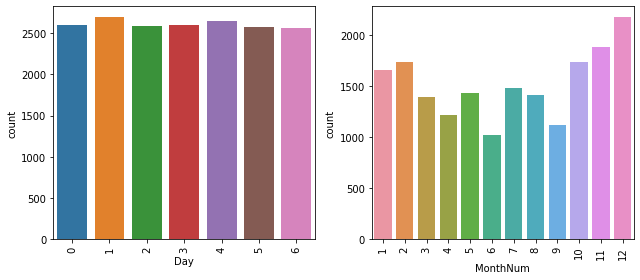

In [142]:
import seaborn as sns 
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = [9.00, 4.0]
plt.rcParams["figure.autolayout"] = True
f, axes = plt.subplots(1, 2)
sns.countplot(df_clientwise['Day'],ax=axes[0]).set_xticklabels(df_clientwise['Day'].unique(),rotation=90)
sns.countplot(df_clientwise['MonthNum'],ax=axes[1]).set_xticklabels(df_clientwise['MonthNum'].unique(),rotation=90)


plt.show()

In [165]:
sns.countplot(df_clientwise['ClientName'],ax=axes[0]).set_xticklabels(df_clientwise['ClientName'].unique(),rotation=90)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


[Text(0, 0, 'Client0'),
 Text(1, 0, 'Client1'),
 Text(2, 0, 'Client2'),
 Text(3, 0, 'Client3'),
 Text(4, 0, 'Client4'),
 Text(5, 0, 'Client5'),
 Text(6, 0, 'Client6'),
 Text(7, 0, 'Client7'),
 Text(8, 0, 'Client8'),
 Text(9, 0, 'Client9')]

<AxesSubplot:ylabel='Day'>

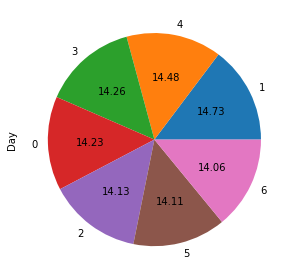

In [145]:
df_clientwise['Day'].value_counts().plot(kind='pie',autopct = '%.2f')

<AxesSubplot:ylabel='MonthNum'>

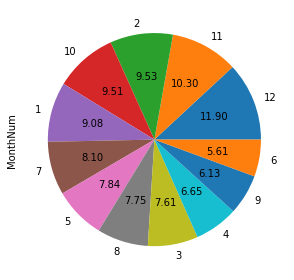

In [144]:
df_clientwise['MonthNum'].value_counts().plot(kind='pie',autopct = '%.2f')

<AxesSubplot:ylabel='ClientName'>

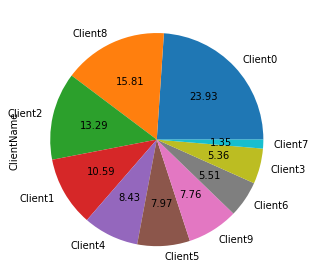

In [166]:
df_clientwise['ClientName'].value_counts().plot(kind='pie',autopct = '%.2f')

(array([2602.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0., 2693.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0., 2584.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0., 2607.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0., 2648.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0., 2579.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        2571.]),
 array([0.  , 0.06, 0.12, 0.18, 0.24, 0.3 , 0.36, 0.42, 0.48, 0.54, 0.6 ,
        0.66, 0.72, 0.78, 0.84, 0.9 , 0.96, 1.02, 1.08, 1.14, 1.2 , 1.26,
        1.32, 1.38, 1.44, 1.5 , 1.56, 1.62, 1.68, 1.74

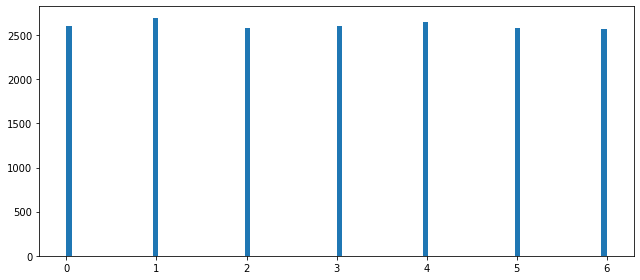

In [147]:
import matplotlib.pyplot as plt
plt.hist(df_clientwise['Day'],bins=100)

(array([1661.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1742.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1391.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1215.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1433.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1025.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1481.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1417.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1120.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1739.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1884.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        2176.]),
 array([ 1.  ,  1.11,  1.22,  1.33,  1.44,  1.55,  1.66,  1.77,  1.88,
         1.99,  2.1 ,  2.21,  2.32,  2.43,  2.54,  2.65,  2.76,  2.87,
         2.98,  3.09,  3.2 ,  3.31,  3.42,  3.53,  3.64,  3.

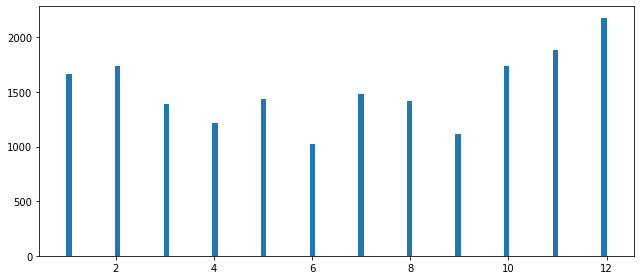

In [148]:
plt.hist(df_clientwise['MonthNum'],bins=100)

(array([4376.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0., 1936.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0., 2430.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,  980.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0., 1542.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0., 1458.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0., 1007.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,  247.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0., 2890.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1418.]),
 array([0.  , 0.09, 0.18, 0.27, 0.36, 0.45, 0.54, 0.63, 0.72, 0.81, 0.9 ,
        0.99, 1.08, 1.17, 1.26, 1.35, 1.44, 1.53, 1.62, 1.71, 1.8 , 1.89,
        1.98, 2.07, 2.16, 2.25, 2.34, 2.43, 2.52, 2.61

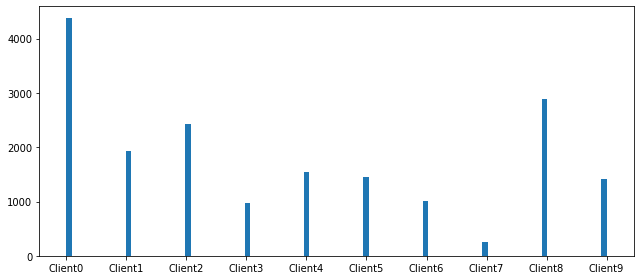

In [167]:
plt.hist(df_clientwise['ClientName'],bins=100)

(array([1.720e+02, 0.000e+00, 2.720e+02, 0.000e+00, 3.310e+02, 0.000e+00,
        4.610e+02, 0.000e+00, 0.000e+00, 5.160e+02, 0.000e+00, 6.470e+02,
        0.000e+00, 7.270e+02, 0.000e+00, 8.900e+02, 0.000e+00, 0.000e+00,
        9.770e+02, 0.000e+00, 1.136e+03, 0.000e+00, 1.234e+03, 0.000e+00,
        0.000e+00, 1.252e+03, 0.000e+00, 1.194e+03, 0.000e+00, 1.124e+03,
        0.000e+00, 1.088e+03, 0.000e+00, 0.000e+00, 9.650e+02, 0.000e+00,
        9.130e+02, 0.000e+00, 8.470e+02, 0.000e+00, 6.750e+02, 0.000e+00,
        0.000e+00, 6.740e+02, 0.000e+00, 5.160e+02, 0.000e+00, 3.900e+02,
        0.000e+00, 0.000e+00, 2.900e+02, 0.000e+00, 2.540e+02, 0.000e+00,
        1.830e+02, 0.000e+00, 1.560e+02, 0.000e+00, 0.000e+00, 1.160e+02,
        0.000e+00, 1.030e+02, 0.000e+00, 6.600e+01, 0.000e+00, 4.600e+01,
        0.000e+00, 0.000e+00, 3.200e+01, 0.000e+00, 1.900e+01, 0.000e+00,
        8.000e+00, 0.000e+00, 0.000e+00, 4.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

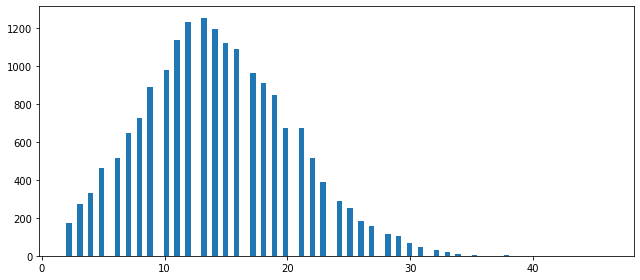

In [149]:
plt.hist(df_clientwise['QtyOrdered'],bins=100)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Day', ylabel='Density'>

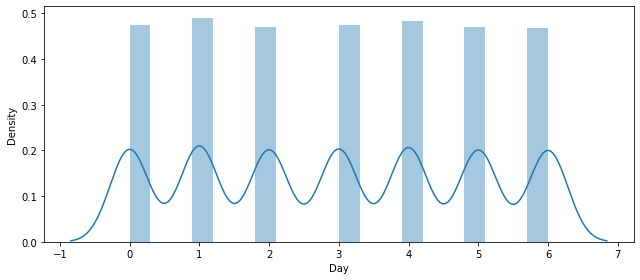

In [150]:
sns.distplot(df_clientwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='MonthNum', ylabel='Density'>

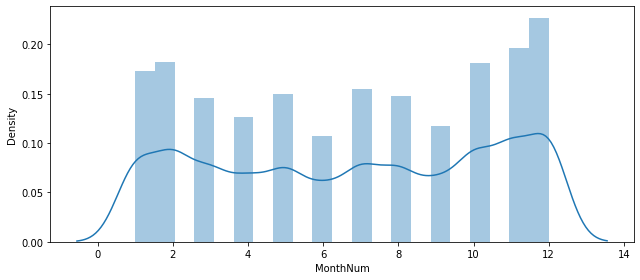

In [151]:
sns.distplot(df_clientwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='QtyOrdered', ylabel='Density'>

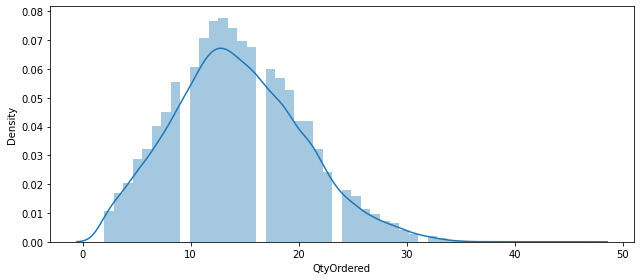

In [152]:
sns.distplot(df_clientwise['QtyOrdered'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Sales', ylabel='Density'>

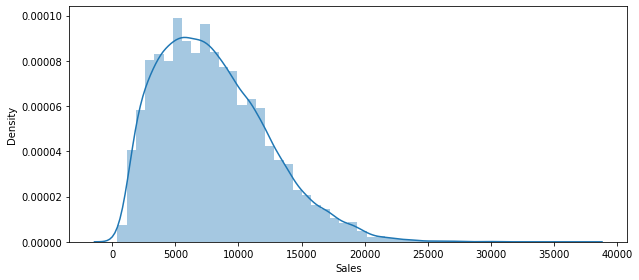

In [157]:
sns.distplot(df_clientwise['Sales'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Day'>

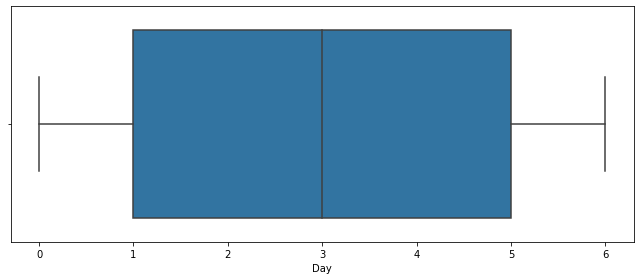

In [153]:
sns.boxplot(df_clientwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='MonthNum'>

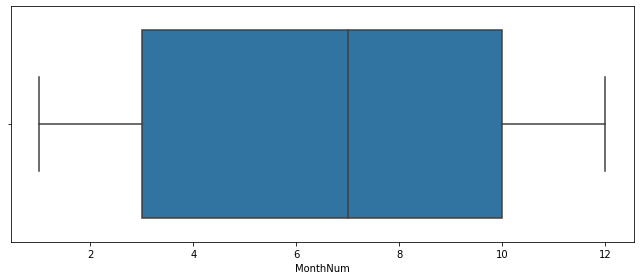

In [154]:
sns.boxplot(df_clientwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered'>

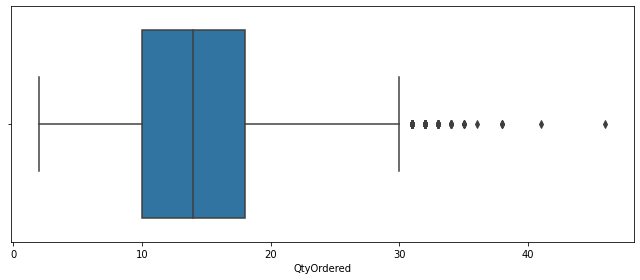

In [155]:
sns.boxplot(df_clientwise['QtyOrdered'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales'>

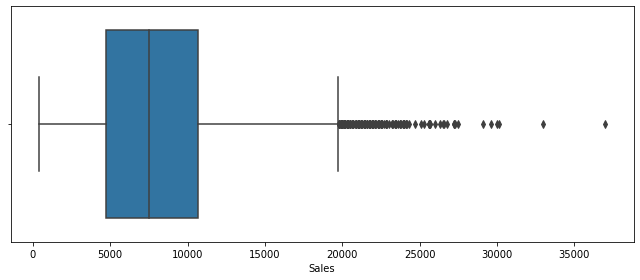

In [158]:
sns.boxplot(df_clientwise['Sales'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='QtyOrdered'>

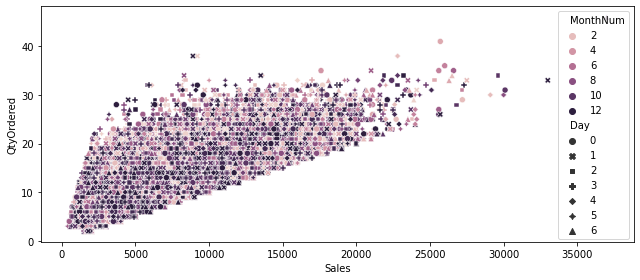

In [169]:
import pandas as pd 
import seaborn as sns
sns.scatterplot(df_clientwise['Sales'],df_clientwise['QtyOrdered'],hue=df_clientwise['MonthNum'],style=df_clientwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Sales', ylabel='QtyOrdered'>

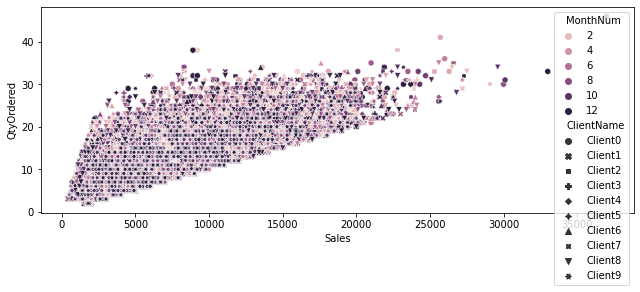

In [170]:
sns.scatterplot(df_clientwise['Sales'],df_clientwise['QtyOrdered'],hue=df_clientwise['MonthNum'],style=df_clientwise['ClientName'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered', ylabel='Sales'>

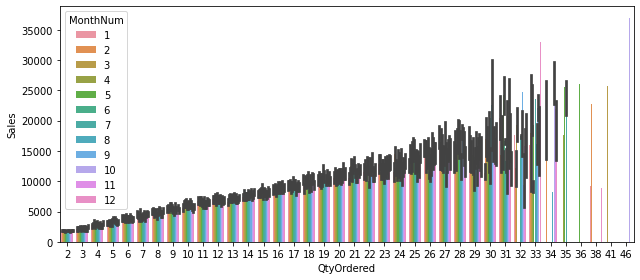

In [159]:
sns.barplot(df_clientwise['QtyOrdered'],df_clientwise['Sales'],hue=df_clientwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered', ylabel='Sales'>

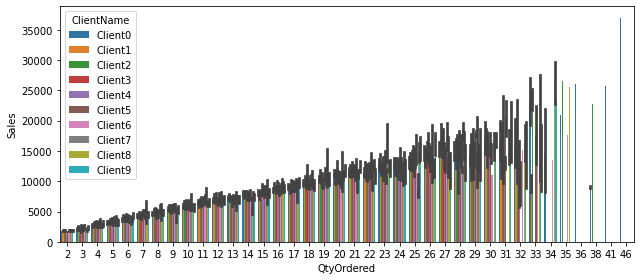

In [171]:
sns.barplot(df_clientwise['QtyOrdered'],df_clientwise['Sales'],hue=df_clientwise['ClientName'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered', ylabel='Sales'>

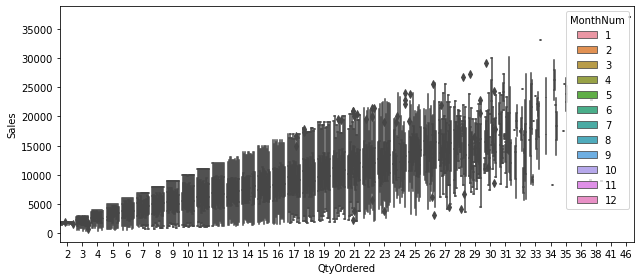

In [160]:
sns.boxplot(df_clientwise['QtyOrdered'],df_clientwise['Sales'],hue=df_clientwise['MonthNum'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered', ylabel='Sales'>

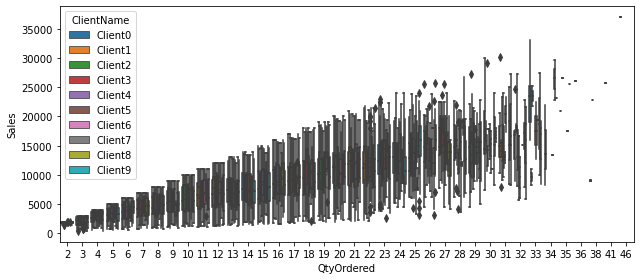

In [172]:
sns.boxplot(df_clientwise['QtyOrdered'],df_clientwise['Sales'],hue=df_clientwise['ClientName'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered', ylabel='Sales'>

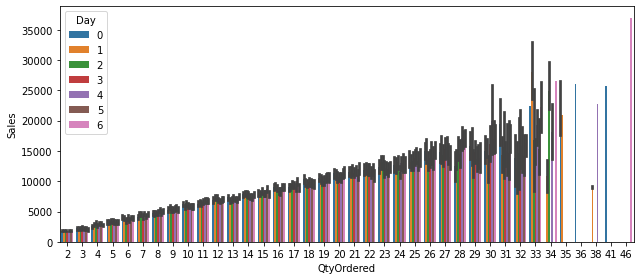

In [161]:
sns.barplot(df_clientwise['QtyOrdered'],df_clientwise['Sales'],hue=df_clientwise['Day'])

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='QtyOrdered', ylabel='Sales'>

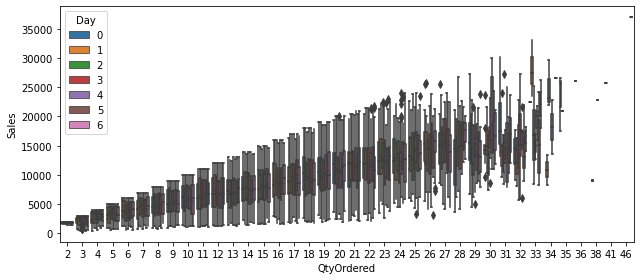

In [162]:
sns.boxplot(df_clientwise['QtyOrdered'],df_clientwise['Sales'],hue=df_clientwise['Day'])

In [173]:
df_clientwise.head(2)

,Unnamed: 0,ClientName,MonthNum,Day,Prods,QtyOrdered,Sales
0,0,Client0,1,0,"prod1,prod1,prod15,prod12",24,16800
1,1,Client0,1,0,"prod1,prod13,prod12,prod15",18,8100


In [174]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_clientwise.ClientName = le.fit_transform(df_clientwise.ClientName)
df_clientwise.Prods = le.fit_transform(df_clientwise.Prods)

In [175]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_clientwise[['Prods']] = scaler.fit_transform(df_clientwise[['Prods']])

In [185]:
df_clientwise.head(2)

,Unnamed: 0,ClientName,MonthNum,Day,Prods,QtyOrdered,Sales
0,0,0,1,0,0.012166,24,16800
1,1,0,1,0,0.062103,18,8100


## Simple Linear Regression

In [184]:
import pandas as pd
import numpy as np

import plotly.express as px
import plotly.graph_objects as go

from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [188]:
X = df_clientwise[['QtyOrdered']]
y = df_clientwise[['Sales']]

In [189]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=3)


from sklearn.linear_model import LinearRegression
mlr = LinearRegression()
mlr.fit(X_train,y_train)
y_pred = mlr.predict(X_test)


print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 2478.562843776838
MSE 9626225.032034919
RMSE 3102.61583700511
R2Score 0.480643297904074


## Multiple Linear Regression

In [192]:
X = df_clientwise[['ClientName','Prods','MonthNum','Day','QtyOrdered']]
y = df_clientwise[['Sales']]

In [193]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=3)


In [194]:
from sklearn.linear_model import LinearRegression
mlr = LinearRegression()
mlr.fit(X_train,y_train)
y_pred = mlr.predict(X_test)


print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 2472.972088772753
MSE 9597108.59621444
RMSE 3097.920043547677
R2Score 0.4822141957414078


## SGD

In [195]:
from sklearn.linear_model import SGDRegressor
reg = SGDRegressor(max_iter=100,learning_rate='constant',eta0=0.01)
reg.fit(X_train,y_train)
y_pred = reg.predict(X_test)

print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 756665193645.1938
MSE 8.398086310890907e+23
RMSE 916410732744.3795
R2Score -4.5309582892840696e+16


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


## Mini batch GD

In [196]:
import random
sgd = SGDRegressor(learning_rate='constant',eta0=0.25)
batch_size = 35 

for i in range(100):
    idx = random.sample(range(X_train.shape[0]),batch_size)
    sgd.partial_fit(X_train.iloc[idx],y_train.iloc[idx])
y_pred = sgd.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 61784330718219.766
MSE 4.301918923436566e+27
RMSE 65589015265031.734
R2Score -2.320982957831155e+20


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed w

## Polynomial Regression

In [198]:
from sklearn.preprocessing import PolynomialFeatures,StandardScaler
from sklearn.pipeline import Pipeline

poly = PolynomialFeatures(degree=2,include_bias=True) # bias is b0
X_train_trans = poly.fit_transform(X_train)
X_test_trans = poly.transform(X_test)

lr = LinearRegression()
lr.fit(X_train_trans,y_train)
y_pred = lr.predict(X_test_trans)

print("MAE",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))
print("R2Score",r2_score(y_test,y_pred))

MAE 2471.8889222558605
MSE 9591309.400101539
RMSE 3096.9839198971536
R2Score 0.4825270755419506


## Ridge Regression

In [199]:
from sklearn.linear_model import Ridge
R = Ridge(alpha = 0.0001)
R.fit(X_train,y_train)
y_pred1 = R.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

MAE 2472.9720892074997
MSE 9597108.598035507
RMSE 3097.9200438415946
R2Score 0.48221419564315704


## Lasso Regression

In [200]:
from sklearn.linear_model import Lasso 
L = Lasso(alpha = 0.0001)
L.fit(X_train,y_train)
y_pred1 = L.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))


MAE 2472.9721045835768
MSE 9597108.663992172
RMSE 3097.9200544869086
R2Score 0.4822141920846451


## ElasticNet Regression

In [201]:
from sklearn.linear_model import ElasticNet
EL = ElasticNet(alpha = 0.005, l1_ratio = 0.50)
EL.fit(X_train,y_train)
y_pred1 = EL.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))


MAE 2473.1289798321477
MSE 9597765.180636616
RMSE 3098.0260135506637
R2Score 0.48217877152069677


## Logistic Regression

In [202]:
from sklearn.linear_model import LogisticRegression
lor = LogisticRegression()
lor.fit(X_train,y_train)
y_pred1 = lor.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


MAE 2855.12715340443
MSE 13384604.867377631
RMSE 3658.497624350415
R2Score 0.2778701703268981


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


## Decision Tree Regression

In [203]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
rt = DecisionTreeRegressor(criterion = 'squared_error', max_depth = 5)
rt.fit(X_train,y_train)
y_pred1 = rt.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))


MAE 2441.892797694439
MSE 9544496.339326201
RMSE 3089.4168283555073
R2Score 0.485052746485481


In [204]:
#hyperparam tuning 
param_grid = {
    'max_depth':[2,4,5,8,10,12,14,None],
    'criterion':['squared_error','absolute_error'],
    'max_features':[0.25,0.5,0.75,1.0],
    'min_samples_split':[0.25,0.5,0.75,1.0]
}
reg = RandomizedSearchCV(estimator=DecisionTreeRegressor(),param_distributions=param_grid,cv=5,verbose=2,n_jobs=-1)
reg.fit(X_train,y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=DecisionTreeRegressor(), n_jobs=-1,
                   param_distributions={'criterion': ['squared_error',
                                                      'absolute_error'],
                                        'max_depth': [2, 4, 5, 8, 10, 12, 14,
                                                      None],
                                        'max_features': [0.25, 0.5, 0.75, 1.0],
                                        'min_samples_split': [0.25, 0.5, 0.75,
                                                              1.0]},
                   verbose=2)

In [205]:
print(reg.best_score_)
print(reg.best_params_)

#feature importance 
for importance,name in sorted(zip(rt.feature_importances_,X_train.columns),reverse=True):
    print(name,importance)

0.4464416335586767
{'min_samples_split': 0.25, 'max_features': 1.0, 'max_depth': 4, 'criterion': 'absolute_error'}
QtyOrdered 0.975327437445445
Prods 0.024672562554555
MonthNum 0.0
Day 0.0
ClientName 0.0


## Voting Regressor

In [207]:
from sklearn.model_selection import cross_val_score
estimators = [('mlr',mlr),('poly',lr),('R',R),('L',L),('EL',EL),('rt',rt)]
for estimator in estimators :
    scores = cross_val_score(estimator[1],X,y,scoring='r2',cv=10)
    print(estimator[0],np.round(np.mean(scores),2))



mlr 0.49
poly 0.49
R 0.49
L 0.49
EL 0.49
rt 0.49


In [209]:
from sklearn.ensemble import VotingRegressor
vr = VotingRegressor(estimators)
scores = cross_val_score(vr,X,y,scoring='r2',cv=10)
print('voting regressor',np.round(np.mean(scores),2))

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when 

voting regressor 0.49


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_voting.py:600: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


## Bagging Regressor

In [210]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import BaggingRegressor
bag_regressor = BaggingRegressor(random_state = 1)
bag_regressor.fit(X_train,y_train)

y_pred1 = bag_regressor.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)


MAE 2228.777686628384
MSE 8938668.854252119
RMSE 2989.76066839005
R2Score 0.5177385151684339


In [211]:
params = {'base_estimator':[None,mlr,lr,L,R,EL,rt],
             'n_estimators':[20,50,100],
          'max_samples':[0.5,1.0],
          'max_features':[0.5,1.0],
          'bootstrap':[True,False],
          'bootstrap_features':[True,False]
         }
bagging_regressor_grid = GridSearchCV(BaggingRegressor(random_state=1,n_jobs=-1),param_grid = params,cv=3,n_jobs=-1,verbose=-1)
bagging_regressor_grid.fit(X_train,y_train)

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.709e+07, tolerance: 1.806e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.140e+08, tolerance: 1.814e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.099e+08, tolerance: 1.805e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.354e+10, tolerance: 1.867e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.183e+07, tolerance: 1.760e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.576e+10, tolerance: 1.818e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.032e+09, tolerance: 1.821e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.710e+07, tolerance: 1.799e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.074e+10, tolerance: 1.816e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.099e+10, tolerance: 1.826e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.669e+10, tolerance: 1.830e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.099e+10, tolerance: 1.826e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.069e+07, tolerance: 1.820e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.881e+10, tolerance: 1.810e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.348e+07, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.960e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.871e+10, tolerance: 1.809e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.671e+10, tolerance: 1.805e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.103e+10, tolerance: 1.772e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.968e+10, tolerance: 1.829e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.103e+10, tolerance: 1.772e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.255e+10, tolerance: 1.746e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.140e+10, tolerance: 1.811e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.998e+10, tolerance: 1.832e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.259e+10, tolerance: 1.829e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.574e+10, tolerance: 1.794e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.259e+10, tolerance: 1.829e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.150e+10, tolerance: 1.810e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.398e+10, tolerance: 1.818e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.603e+10, tolerance: 1.838e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.662e+10, tolerance: 1.805e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.708e+10, tolerance: 1.834e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.193e+10, tolerance: 1.805e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.252e+10, tolerance: 1.850e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.540e+09, tolerance: 1.814e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.568e+10, tolerance: 1.772e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.639e+10, tolerance: 1.806e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.566e+10, tolerance: 1.755e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.903e+10, tolerance: 1.785e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.706e+10, tolerance: 1.832e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.600e+10, tolerance: 1.814e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.173e+10, tolerance: 1.885e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.672e+10, tolerance: 1.814e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.183e+10, tolerance: 1.786e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.717e+10, tolerance: 1.831e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.653e+09, tolerance: 1.781e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.734e+10, tolerance: 1.930e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.977e+10, tolerance: 1.756e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.649e+10, tolerance: 1.848e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.754e+10, tolerance: 1.826e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.925e+10, tolerance: 1.860e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.676e+10, tolerance: 1.872e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.609e+10, tolerance: 1.797e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.789e+10, tolerance: 1.772e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.590e+10, tolerance: 1.806e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.698e+10, tolerance: 1.835e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.008e+10, tolerance: 1.826e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.808e+10, tolerance: 1.826e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.510e+10, tolerance: 1.749e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.653e+10, tolerance: 1.777e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.112e+10, tolerance: 1.842e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.078e+10, tolerance: 1.770e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.631e+10, tolerance: 1.773e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.552e+10, tolerance: 1.805e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.297e+10, tolerance: 1.803e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.522e+10, tolerance: 1.848e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.640e+10, tolerance: 1.826e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.202e+10, tolerance: 1.792e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.822e+10, tolerance: 1.757e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.055e+10, tolerance: 1.823e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.524e+10, tolerance: 1.818e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.910e+10, tolerance: 1.807e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.119e+10, tolerance: 1.786e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.370e+10, tolerance: 1.854e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.065e+10, tolerance: 1.849e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.334e+10, tolerance: 1.718e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.599e+10, tolerance: 1.821e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.900e+10, tolerance: 1.781e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.624e+10, tolerance: 1.846e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.449e+10, tolerance: 1.809e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.637e+10, tolerance: 1.831e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-pack

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.687e+10, tolerance: 1.841e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.817e+10, tolerance: 1.824e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.262e+10, tolerance: 1.844e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.202e+10, tolerance: 1.792e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.382e+10, tolerance: 1.799e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-pack

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.065e+10, tolerance: 1.856e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.483e+10, tolerance: 1.751e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.651e+10, tolerance: 1.804e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.557e+10, tolerance: 1.834e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.235e+10, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.518e+10, tolerance: 1.795e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.892e+10, tolerance: 1.806e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.903e+10, tolerance: 1.864e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.086e+09, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.086e+09, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.726e+10, tolerance: 1.848e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.164e+10, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.092e+10, tolerance: 1.821e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.253e+10, tolerance: 1.807e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.574e+10, tolerance: 1.855e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.593e+10, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.019e+10, tolerance: 1.778e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.684e+10, tolerance: 1.745e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.161e+10, tolerance: 1.776e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.580e+10, tolerance: 1.783e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.664e+10, tolerance: 1.799e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.010e+10, tolerance: 1.872e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.684e+10, tolerance: 1.745e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.279e+10, tolerance: 1.814e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.694e+10, tolerance: 1.800e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.670e+10, tolerance: 1.836e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.620e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.144e+09, tolerance: 1.875e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.518e+10, tolerance: 1.832e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.915e+10, tolerance: 1.828e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.597e+10, tolerance: 1.815e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.108e+10, tolerance: 1.858e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.281e+10, tolerance: 1.792e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.800e+10, tolerance: 1.800e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.366e+10, tolerance: 1.803e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.003e+10, tolerance: 1.774e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.616e+10, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.092e+10, tolerance: 1.821e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.092e+10, tolerance: 1.821e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.636e+10, tolerance: 1.826e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.551e+10, tolerance: 1.824e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.764e+10, tolerance: 1.810e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.280e+10, tolerance: 1.831e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.347e+07, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.640e+10, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.691e+10, tolerance: 1.810e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.386e+10, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.614e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.671e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.621e+10, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.922e+09, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.216e+10, tolerance: 1.815e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.569e+10, tolerance: 1.783e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.616e+10, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.626e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.799e+10, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.619e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.611e+10, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.507e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.881e+09, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.640e+10, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.782e+10, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return 

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.163e+10, tolerance: 1.801e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-pack

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.640e+10, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.432e+09, tolerance: 1.827e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.640e+10, tolerance: 1.825e+07
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.242e+10, tolerance: 1.825e+07
  model = cd_fas

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was

GridSearchCV(cv=3, estimator=BaggingRegressor(n_jobs=-1, random_state=1),
             n_jobs=-1,
             param_grid={'base_estimator': [None, LinearRegression(),
                                            LinearRegression(),
                                            Lasso(alpha=0.0001),
                                            Ridge(alpha=0.0001),
                                            ElasticNet(alpha=0.005),
                                            DecisionTreeRegressor(max_depth=5)],
                         'bootstrap': [True, False],
                         'bootstrap_features': [True, False],
                         'max_features': [0.5, 1.0], 'max_samples': [0.5, 1.0],
                         'n_estimators': [20, 50, 100]},
             verbose=-1)

In [212]:
print('train r2',bagging_regressor_grid.best_estimator_.score(X_train,y_train))
print('test r2',bagging_regressor_grid.best_estimator_.score(X_test,y_test))
print('best r2 score through grid search ',bagging_regressor_grid.best_score_)
print('best parameters',bagging_regressor_grid.best_params_)

train r2 0.8852208036384868
test r2 0.5850465691864917
best r2 score through grid search  0.5657085858553549
best parameters {'base_estimator': None, 'bootstrap': True, 'bootstrap_features': True, 'max_features': 1.0, 'max_samples': 1.0, 'n_estimators': 100}


## Random Forest Regressor

In [213]:
from sklearn.ensemble import RandomForestRegressor
raf = RandomForestRegressor(n_estimators=500).fit(X_train,y_train)
y_pred1 = raf.predict(X_test)
print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))



/tmp/ipykernel_4275/614460986.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  raf = RandomForestRegressor(n_estimators=500).fit(X_train,y_train)


MAE 2126.87284659557
MSE 8108510.866896363
RMSE 2847.5447084982466
R2Score 0.5625274239147875


In [214]:
rf=RandomForestRegressor(oob_score = True)
rf.fit(X_train,y_train)
rf.oob_score_

/tmp/ipykernel_4275/1321434785.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X_train,y_train)


0.5701926681537062

## XGBoosting Regressor

In [215]:
from xgboost import XGBRegressor

model = XGBRegressor(random_state=42, n_jobs=-1, n_estimators=20, max_depth=4)
model.fit(X_train, y_train)

y_pred1 = model.predict(X_test)


print("MAE",mean_absolute_error(y_test,y_pred1))
print("MSE",mean_squared_error(y_test,y_pred1))
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred1)))
print("R2Score",r2_score(y_test,y_pred1))


MAE 2240.872486509845
MSE 8290820.751701244
RMSE 2879.37853567419
R2Score 0.5526913915950926


In [216]:
#feature importance 
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

importance_df.head(10)

,feature,importance
4,QtyOrdered,0.887678
1,Prods,0.077620
3,Day,0.019929
2,MonthNum,0.008673
0,ClientName,0.006099


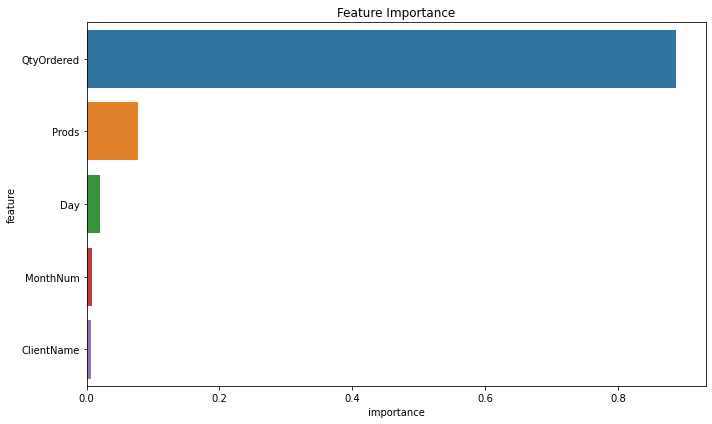

In [217]:
import seaborn as sns
plt.figure(figsize=(10,6))
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');


In [218]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

#hyperparam tuning 
param_grid = {
    'n_estimators':[20,50,150,240],
    'max_depth':[2,4,8,10,None],
    'learning_rate':[0.01,0.1,0.3,0.9,0.99]
}

reg = RandomizedSearchCV(estimator=XGBRegressor(),param_distributions=param_grid,cv=5,verbose=2,n_jobs=-1)

reg.fit(X_train,y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, gpu_id=None,
                                          grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=...
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=None,
                                          max_leaves=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n_jobs=None,
                                          num_parallel_tree=None,
                                          predictor=None, random_state=None, ...),
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.01, 0.1, 0.3, 0.9,
                                                          0.99],
                                        'max_depth': [2, 4, 8, 10, None],
                                        'n_estimators': [20, 50, 150, 240]},
                   verbose=2)

In [220]:
reg.best_score_



0.7119935345143501

In [221]:
reg.best_params_

{'n_estimators': 240, 'max_depth': 4, 'learning_rate': 0.9}